<a href="https://colab.research.google.com/github/EmanuelAlogna/MRI-generation/blob/master/results/MI_GAN_105ep_genT2_v2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Import libraries and mount the drive

In [1]:
try:
  %tensorflow_version 2.x
except Exception:
  pass
import tensorflow as tf
from tensorflow import keras
import numpy as np
import matplotlib.pyplot as plt
import os
from IPython import display
import time
import math

print(tf.__version__)

from google.colab import drive
drive.mount('/content/drive')

TensorFlow 2.x selected.
2.1.0-rc1
Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


## Loading train, validation and test sets

In [0]:
def get_feature_description(modalities):                                                   
                                                                                           
    feature_description =lambda mod : {                                                    
                            mod+'_mri': tf.io.FixedLenFeature([], tf.string),              
                            mod+'_path': tf.io.FixedLenFeature([], tf.string),             
                                                                                           
                            mod+'_mri_min': tf.io.FixedLenFeature([], tf.float32),         
                            mod+'_mri_min_src': tf.io.FixedLenFeature([], tf.float32),     
                            mod+'_mri_max': tf.io.FixedLenFeature([], tf.float32),         
                            mod+'_mri_max_src': tf.io.FixedLenFeature([], tf.float32),     
                                                                                           
                            mod+'_mri_lperc': tf.io.FixedLenFeature([], tf.float32),       
                            mod+'_mri_hperc': tf.io.FixedLenFeature([], tf.float32),       
                            mod+'_mri_hperc_src': tf.io.FixedLenFeature([], tf.float32),   
                            mod+'_mri_lperc_src': tf.io.FixedLenFeature([], tf.float32),   
                                                                                           
                            mod+'_x_dimension': tf.io.FixedLenFeature([], tf.int64),       
                            mod+'_y_dimension': tf.io.FixedLenFeature([], tf.int64),       
                            mod+'_z_dimension': tf.io.FixedLenFeature([], tf.int64),       
                            mod+'_z_dimension_src': tf.io.FixedLenFeature([], tf.int64),   
                            mod+'_x_dimension_src': tf.io.FixedLenFeature([], tf.int64),   
                            mod+'_y_dimension_src': tf.io.FixedLenFeature([], tf.int64),   
                                                                                           
                            mod+'_x_origin_src': tf.io.FixedLenFeature([], tf.float32),    
                            mod+'_y_origin_src': tf.io.FixedLenFeature([], tf.float32),    
                            mod+'_z_origin_src': tf.io.FixedLenFeature([], tf.float32),    
                                                                                           
                            mod+'_z_spacing_src': tf.io.FixedLenFeature([], tf.float32),   
                            mod+'_x_spacing_src': tf.io.FixedLenFeature([], tf.float32),   
                            mod+'_y_spacing_src': tf.io.FixedLenFeature([], tf.float32),   
                                                                                           
                            mod+'_patient': tf.io.FixedLenFeature([], tf.string),          
                            mod+'_sample_number': tf.io.FixedLenFeature([], tf.string),    
                            mod+'_patient_grade': tf.io.FixedLenFeature([], tf.string),    
                            mod+'_location': tf.io.FixedLenFeature([], tf.string),         
                            mod+'_dataset_version': tf.io.FixedLenFeature([], tf.string),  
                            mod+'_dataset_name': tf.io.FixedLenFeature([], tf.string),     
                            mod+'_mri_type': tf.io.FixedLenFeature([], tf.string),         
                            mod+'_dataset_split': tf.io.FixedLenFeature([], tf.string),    
                            mod+'_patient_mri_seq': tf.io.FixedLenFeature([], tf.string),  
                          }                                                                
    features = {}                                                                          
    for mod in modalities:
        features.update(feature_description(mod))
    return features

In [0]:
#BUFFER_SIZE = 400
BATCH_SIZE = 32

In [0]:
use_gzip_compression = True

def load_dataset(name, mri_type, center_crop=None, random_crop=None, filter=None, batch_size=BATCH_SIZE, cache=True, 
                 prefetch_buffer=1, shuffle_buffer=128, interleave=1, cast_to=tf.float32, clip_labels_to=0.0, 
                 take_only=None, shuffle=True, infinite=False, n_threads=os.cpu_count()):
    def parse_sample(sample_proto):
        parsed = tf.io.parse_single_example(sample_proto, get_feature_description(["OT"]+mri_type))
        # Decoding image arrays
        
        slice_shape = [parsed['OT_x_dimension'.format(mri_type[0])], parsed['OT_y_dimension'], 1]
        # Decoding the ground truth
        parsed['seg'] = tf.cast(tf.reshape(tf.io.decode_raw(parsed['OT_mri'], tf.float32), shape=slice_shape), dtype=cast_to)
        # Decode each channel and stack in a 3d volume
        stacked_mri = list()
        for mod in mri_type:
            stacked_mri.append(tf.cast(tf.reshape(tf.io.decode_raw(parsed['{}_mri'.format(mod)], tf.float32), shape=slice_shape), dtype=cast_to))
        parsed['mri'] = tf.concat(stacked_mri, axis=-1)
        # Clipping the labels if requested
        parsed['seg'] = tf.clip_by_value(parsed['seg'], 0.0, clip_labels_to) if clip_labels_to else parsed['seg']
        
        # Cropping
        if random_crop or center_crop:
            # Stacking the mri and the label to align the crop shape
            mri_seg = tf.concat([parsed['mri'], parsed['seg']], axis=-1)
            if random_crop:
                random_crop[-1] = mri_seg.shape[-1] 
                cropped = tf.image.random_crop(mri_seg, size=random_crop)
            else:
                cropped = tf.image.resize_with_crop_or_pad(mri_seg,center_crop[0],center_crop[1])
            # Splitting back
            parsed['mri'] = cropped[:,:,:len(mri_type)]
            parsed['seg'] = cropped[:,:,len(mri_type):]
        
        return parsed
    
    path = './drive/My Drive/MRI-generation/{}.tfrecords'.format(name)
    dataset = tf.data.TFRecordDataset(path, compression_type='GZIP' if use_gzip_compression else "")
    dataset = dataset.filter(filter) if filter is not None else dataset
    dataset = dataset.take(take_only) if take_only is not None else dataset

    # You should generally cache after loading and preprocessing the data, 
    # but before shuffling, repeating, batching and prefetching”
    dataset = dataset.cache() if cache else dataset
    if shuffle and infinite:
        dataset = dataset.apply(tf.data.experimental.shuffle_and_repeat(shuffle_buffer))
    else:
        dataset = dataset.shuffle(shuffle_buffer, reshuffle_each_iteration=True) if shuffle else dataset
        dataset = dataset.repeat() if infinite else dataset
    dataset = dataset.map(parse_sample, num_parallel_calls=None)
    dataset = dataset.batch(batch_size) if batch_size > 0 else dataset
    

    if interleave > 1:
        dataset = dataset.interleave(lambda x: tf.data.Dataset.from_tensors(x).repeat(interleave), cycle_length=n_threads, block_length=interleave, num_parallel_calls=n_threads)
  
    dataset = dataset.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)
    return dataset

In [0]:
# loading all the dataset, with only modality T1 and T2
# I'll focus now on synthesizing T2 from T1

def load_datasets():
    validation = load_dataset('brats2015_validation_crop_mri', ['MR_T1', 'MR_T1c', 'MR_T2', 'MR_Flair'], shuffle=False)
    training = load_dataset('brats2015_training_crop_mri', ['MR_T1', 'MR_T1c', 'MR_T2', 'MR_Flair'], shuffle=True)
    testing = load_dataset('brats2015_testing_crop_mri', ['MR_T1', 'MR_T1c', 'MR_T2', 'MR_Flair'], shuffle=True)
    return training, validation , testing

In [0]:
training, validation, testing = load_datasets() # I'll use this in case I get stuck with the cache.

modalities = ['MR_T1_mri', 'MR_T2_mri', 'MR_T1c_mri', 'MR_Flair_mri', 'OT_mri']

## Load some useful functions


In [0]:
# PROCESSING IMAGES IN THE BATCH
def process_batch(batch):   # takes in input a raw_record[mod].numpy()
    batch = tf.io.decode_raw(batch, tf.float32)
    batch = tf.reshape(batch, (BATCH_SIZE, 180, 180))
    paddings = tf.constant([[0, 0], [38, 38], [38, 38]])
    batch = tf.pad(batch, paddings, "CONSTANT")
    batch = tf.expand_dims(batch, axis=3)
    return batch
    
# final shape will be (bs, 256, 256, 1): now the batch is ready to be fed to the GAN

In [0]:
# this function preprocesses the input image and the ground truth from a raw_record
# images in the return are then ready to be fed into the GAN
def take_images_from_raw(raw_record, ot=False):

    t1, t2, t1c, tflair = raw_record[modalities[0]], raw_record[modalities[1]], raw_record[modalities[2]], raw_record[modalities[3]]
    t1 = process_batch(t1)
    t2 = process_batch(t2)
    t1c = process_batch(t1c)
    tflair = process_batch(tflair)
    if ot:      # if ot is true, I'll retrieve also the segmentation from the raw_record
        segmentation = process_batch(raw_record[modalities[4]])
        return t1, t2, t1c, tflair, segmentation
    return t1, t2, t1c, tflair

In [0]:
def resize_with_crop(*args): # possibile arguments: input, gt, prediction and maybe the segmentation

    image0 = tf.image.resize_with_crop_or_pad(args[0], 155, 194)
    image1 = tf.image.resize_with_crop_or_pad(args[1], 155, 194)
    image2 = tf.image.resize_with_crop_or_pad(args[2], 155, 194)
    image3 = tf.image.resize_with_crop_or_pad(args[3], 155, 194)
    if len(args) == 5:      # crop also the segmentation, if is given as additional argument
        image4 = tf.image.resize_with_crop_or_pad(args[4], 155, 194)
        return image0, image1, image2, image3, image4
    if len(args) == 6:      # crop also the segmentation, if is given as additional argument
        image4 = tf.image.resize_with_crop_or_pad(args[4], 155, 194)
        image5 = tf.image.resize_with_crop_or_pad(args[5], 155, 194)
        return image0, image1, image2, image3, image4, image5
    return image0, image1, image2, image3

In [0]:
def retrieve_tumor_area(ground_truth, prediction, segmentation):
    ground_truth_np = ground_truth.numpy()
    segmentation_np = segmentation.numpy()
    prediction_np = prediction.numpy()

    # I want to remove all the pixels not relevant wrt the tumor area. 
    idx = (segmentation_np==0)      
    ground_truth_np[idx] = segmentation_np[idx]
    prediction_np[idx] = segmentation_np[idx]

    return ground_truth_np, prediction_np      # Now the images are ready to be evaluated

## Evaluate GAN

In [0]:
def evaluate_GAN(model, dataset, set_type, evaluate_tumor_area=False, print_loss=False, epc=99):
    num_batches = 0                 # CAREFUL when batch_size is modified!!!
    if set_type == 'test':
        num_batches = 112           # in the test set, with batch 32, there are 112 elements.
    elif set_type == 'validation':
        num_batches = 108
    elif set_type == 'train':
        num_batches = 876
    
    ######## remove this ######
    #num_batches = 10
    container_psnr = tf.TensorArray(tf.float32, size=num_batches)     
    container_mse = tf.TensorArray(tf.float32, size=num_batches)
    container_ssim = tf.TensorArray(tf.float32, size=num_batches)
    
    if evaluate_tumor_area:
        container_psnr_tumor = tf.TensorArray(tf.float32, size=num_batches)     
        container_mse_tumor = tf.TensorArray(tf.float32, size=num_batches)
        container_ssim_tumor = tf.TensorArray(tf.float32, size=num_batches)
    if print_loss:
        container_gen = tf.TensorArray(tf.float32, size=num_batches)     
        container_disc = tf.TensorArray(tf.float32, size=num_batches)
    
    #idx = 0
    for idx, raw_record in dataset.enumerate():
    #for raw_record in dataset.take(10):
        t1, t2, t1c, tflair, segmentation = take_images_from_raw(raw_record, ot=True)
        # preparing the input to the generator
        ground_truth = t2
        # INPUT IMPUTATION
        #gt_imputed = tf.zeros((32, 256, 256, 1), dtype=tf.dtypes.float32)
        input_tensor = tf.concat([t1, t1c, tflair], 3)

        # generate the prediction            
        prediction = model(input_tensor, training=False)
        # extracting the t2_prediction from the predictions (I'm only interested in T2)
        #t2_generated = prediction[:, :, :, 1]     # this will be used to compute the loss and then fed to the discriminator
        #t2_generated = tf.expand_dims(t2_generated, axis=3)     # cause in plot_images it will tf.squeeze

        # crop the images
        t1_cr, t1c_cr, tflair_cr, t2_original_cr, t2_generated_cr, segmentation_cr = resize_with_crop(t1, t1c, tflair, ground_truth, prediction, segmentation)
        if evaluate_tumor_area:
            ground_truth_masked, prediction_masked = retrieve_tumor_area(t2_original_cr, t2_generated_cr, segmentation_cr)
        #if (idx == 2 or idx == 25 or idx == 45 or idx == 50 or idx == 83) and evaluate_tumor_area:
        #    plot_images_new(t1_cr, t1c_cr, tflair_cr, t2_original_cr, t2_generated_cr, ground_truth_masked, prediction_masked)
        # ----> to restore the above code, change also the below line with 'elif' instead of 'if'

        # let's print only 5 images per time. 
    
        if (idx == 2 or idx == 25 or idx == 45 or idx == 50 or idx == 83):
            if (epc % 5 == 1) and evaluate_tumor_area:
                # print tumor areas only if the bool is set to True and the epoch is % n == 1 (is a multiple of n)
                plot_images_new(t1_cr, t1c_cr, tflair_cr, t2_original_cr, t2_generated_cr, ground_truth_masked, prediction_masked)
            else:
                plot_images_new(t1_cr, t1c_cr, tflair_cr, t2_original_cr, t2_generated_cr)

        # normalize the prediction and the ground_truth
        prediction_normalized_cr = mean_normalize(t2_generated_cr)
        ground_truth_normalized_cr = mean_normalize(t2_original_cr)

        # compute the metrics of similarity
        mean, std, psnr = compute_psnr(ground_truth_normalized_cr, prediction_normalized_cr)
        container_psnr = container_psnr.write(idx, psnr)
        mean, std, mse = compute_mse(ground_truth_normalized_cr, prediction_normalized_cr)
        container_mse = container_mse.write(idx, mse)
        mean, std, ssim = compute_ssim(ground_truth_normalized_cr, prediction_normalized_cr)
        container_ssim = container_ssim.write(idx, ssim)

        if evaluate_tumor_area:
            # discard black images from pred and gt
            prediction_masked_normalized = mean_normalize(prediction_masked)
            ground_truth_masked_normalized = mean_normalize(ground_truth_masked) 
            #if (epc % 2 == 1) and idx == 0:
            #    plot_images(ground_truth_masked, prediction_masked)
            mean, std, psnr = compute_psnr(ground_truth_masked_normalized, prediction_masked_normalized)
            container_psnr_tumor = container_psnr_tumor.write(idx, psnr)
            mean, std, mse = compute_mse(ground_truth_masked_normalized, prediction_masked_normalized)
            container_mse_tumor = container_mse_tumor.write(idx, mse)
            mean, std, ssim = compute_ssim(ground_truth_masked_normalized, prediction_masked_normalized)
            container_ssim_tumor = container_ssim_tumor.write(idx, ssim)

        # COMPUTES VALIDATION LOSSES FOR THE GENERATOR AND THE DISCRIMINATOR
        if print_loss:
            ####################################
            disc_real_output = discriminator([input_tensor, ground_truth], training=True)
                
            # showing to D a batch fake images of T2
            disc_generated_output = discriminator([input_tensor, prediction], training=True)

            gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, prediction, ground_truth)
            
            disc_loss = discriminator_loss(disc_real_output, disc_generated_output)
            container_gen = container_gen.write(idx, gen_total_loss)
            container_disc = container_disc.write(idx, disc_loss)
            ###############################
       # idx += 1

    container_psnr = container_psnr.stack()
    container_mse = container_mse.stack()
    container_ssim = container_ssim.stack()
    mean_psnr = tf.reduce_mean(tf.boolean_mask((container_psnr), tf.math.is_finite(container_psnr)))
    std_psnr = tf.math.reduce_std(tf.boolean_mask((container_psnr), tf.math.is_finite(container_psnr)))
    mean_mse = tf.reduce_mean(tf.boolean_mask((container_mse), tf.math.is_finite(container_mse)))
    std_mse = tf.math.reduce_std(tf.boolean_mask((container_mse), tf.math.is_finite(container_mse)))
    mean_ssim = tf.reduce_mean(tf.boolean_mask((container_ssim), tf.math.is_finite(container_ssim)))
    std_ssim = tf.math.reduce_std(tf.boolean_mask((container_ssim), tf.math.is_finite(container_ssim)))

    print("PSNR on {} set: {} ± {}".format(set_type, (f'{mean_psnr:.4f}'), (f'{std_psnr:.4f}')))
    print("MSE on {} set: {} ± {}".format(set_type, (f'{mean_mse:.4f}'), (f'{std_mse:.4f}')))
    print("SSIM on {} set: {} ± {}".format(set_type, (f'{mean_ssim:.4f}'), (f'{std_ssim:.4f}')))

    if evaluate_tumor_area:
        container_psnr_tumor = container_psnr_tumor.stack()
        container_mse_tumor = container_mse_tumor.stack()
        container_ssim_tumor = container_ssim_tumor.stack()
        mean_psnr_tumor = tf.reduce_mean(tf.boolean_mask((container_psnr_tumor), tf.math.is_finite(container_psnr_tumor)))
        std_psnr_tumor = tf.math.reduce_std(tf.boolean_mask((container_psnr_tumor), tf.math.is_finite(container_psnr_tumor)))
        mean_mse_tumor = tf.reduce_mean(tf.boolean_mask((container_mse_tumor), tf.math.is_finite(container_mse_tumor)))
        std_mse_tumor = tf.math.reduce_std(tf.boolean_mask((container_mse_tumor), tf.math.is_finite(container_mse_tumor)))
        mean_ssim_tumor = tf.reduce_mean(tf.boolean_mask((container_ssim_tumor), tf.math.is_finite(container_ssim_tumor)))
        std_ssim_tumor = tf.math.reduce_std(tf.boolean_mask((container_ssim_tumor), tf.math.is_finite(container_ssim_tumor)))
        print()
        print("PSNR wrt tumor area on {} set: {} ± {}".format(set_type, (f'{mean_psnr_tumor:.4f}'), (f'{std_psnr_tumor:.4f}')))
        print("MSE wrt tumor area on {} set: {} ± {}".format(set_type, (f'{mean_mse_tumor:.4f}'), (f'{std_mse_tumor:.4f}')))
        print("SSIM wrt tumor area on {} set: {} ± {}".format(set_type, (f'{mean_ssim_tumor:.4f}'), (f'{std_ssim_tumor:.4f}')))
    if print_loss:
        container_disc = container_disc.stack()
        container_gen = container_gen.stack()
        mean_gen = tf.reduce_mean(tf.boolean_mask((container_gen), tf.math.is_finite(container_gen)))
        std_gen = tf.math.reduce_std(tf.boolean_mask((container_gen), tf.math.is_finite(container_gen)))
        mean_disc = tf.reduce_mean(tf.boolean_mask((container_disc), tf.math.is_finite(container_disc)))
        std_disc = tf.math.reduce_std(tf.boolean_mask((container_disc), tf.math.is_finite(container_disc)))
        print()
        print("Generator loss on {} set: {} ± {}".format(set_type, (f'{mean_gen:.4f}'), (f'{std_gen:.4f}')))
        print("Discriminator loss on {} set: {} ± {}".format(set_type, (f'{mean_disc:.4f}'), (f'{std_disc:.4f}')))
        
    if tf.equal(print_loss, True) and tf.equal(evaluate_tumor_area, False):
        return mean_psnr, mean_mse, mean_ssim, mean_gen, mean_disc
    elif tf.equal(print_loss, False) and tf.equal(evaluate_tumor_area, True):
        return mean_psnr, mean_mse, mean_ssim, mean_psnr_tumor, mean_mse_tumor, mean_ssim_tumor
    elif tf.equal(print_loss, True) and tf.equal(evaluate_tumor_area, True):
        return mean_psnr, mean_mse, mean_ssim, mean_psnr_tumor, mean_mse_tumor, mean_ssim_tumor, mean_gen, mean_disc
    return mean_psnr, mean_mse, mean_ssim

In [12]:
for i in range(17):
    if (i % 5 == 1):
        print(i)

1
6
11
16


In [0]:
def plot_loss(g_l, d_l):        
    f, (ax1) = plt.subplots(1, 1, figsize=(12, 6))
    f.subplots_adjust(hspace=0.4)
    max_epoch = g_l.shape[0]       # args[0] 
    epoch_list = list(range(1,max_epoch+1))
    ax1.plot(epoch_list, g_l, label='Generator loss')
    ax1.plot(epoch_list, d_l, label='Discriminator Loss')
    ax1.set_xticks(np.arange(1, max_epoch, 5))
    ax1.set_ylabel('Loss Value')
    ax1.set_xlabel('Epoch')
    ax1.set_title('LOSS on validation set')
    ax1.set_ylim([0.0, 10.0])
    l1 = ax1.legend(loc="best")

In [0]:
def plot_metrics(*args):        # arguments will be, in order: psnr, mse, ssim, psnr_tumor*, mse_tumor*, ssim_tumor*
    tumor_area = False          # arguments with * are optional
    if len(args) == 6:
        tumor_area = True

    f, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(12, 20))
    f.subplots_adjust(hspace=0.4)

    max_epoch = (args[0]).shape[0]       # args[0] 

    epoch_list = list(range(1,max_epoch+1))
    ax1.plot(epoch_list, args[0], label='PSNR')
    if tumor_area: 
        ax1.plot(epoch_list, args[3], label='PSNR on tumor area')
    ax1.set_xticks(np.arange(1, max_epoch, 5))
    ax1.set_ylabel('PSNR Value')
    ax1.set_xlabel('Epoch')
    ax1.set_title('PSNR')
    ax1.set_ylim([9, 36])
    l1 = ax1.legend(loc="best")

    ax2.plot(epoch_list, args[1], label='MSE')
    if tumor_area: 
        ax2.plot(epoch_list, args[4], label='MSE on tumor area')
    ax2.set_xticks(np.arange(1, max_epoch, 5))
    ax2.set_ylabel('MSE Value')
    ax2.set_xlabel('Epoch')
    ax2.set_title('MSE')
    ax2.set_ylim([0.0, 0.09])
    l2 = ax2.legend(loc="best")

    ax3.plot(epoch_list, args[2], label='SSIM')
    if tumor_area: 
        ax3.plot(epoch_list, args[5], label='SSIM on tumor area')
    ax3.set_xticks(np.arange(1, max_epoch, 5))
    ax3.set_ylabel('SSIM Value')
    ax3.set_xlabel('Epoch')
    ax3.set_title('SSIM')
    ax3.set_ylim([0.0, 1.0])
    l3 = ax3.legend(loc="best")


In [0]:
# this method was tested to work with 5 and 32 images. Plotting 2, 3 or 4 types per time.

def plot_images(*args, images_to_print=5): 
    if images_to_print == 5: x = 15
    elif images_to_print == 32: x = 90
    if len(args) == 3:
        display_list = [args[0], args[1], args[2]]     # input, gt and prediction
        title = ['Input Image', 'Ground Truth', 'Predicted Image']
        figsize = (x , 9)
    elif len(args) == 2:
        display_list = [args[0], args[1]]     # input and gt
        title = ['GT in tumor area', 'Pred in tumor area']
        figsize = (x , 7)
    elif len(args) == 4:
        display_list = [args[0], args[1], args[2], args[3]]     # gt, prediction, gt_masked, prediction_masked
        title = ['Ground Truth', 'Prediction', 'GT in tumor area', 'Pred in tumor area']
        figsize = (x , 12)
    elif len(args) == 5:
        display_list = [args[0], args[1], args[2], args[3], args[4]]     # input, gt, prediction, gt_masked, prediction_masked
        title = ['T1', 'T1c', 'Tflair', 'T2 ground truth', 'T2 generated']
        figsize = (x , 15)
    plt.figure(1 , figsize)
    n = 0
    for i in range(len(args)):
        for j in range(images_to_print):    # batch size is different from 10, but let's show just 10 images.
            n += 1
            plt.subplot(len(args)+1, images_to_print, n).title.set_text(title[i])
            plt.imshow(tf.squeeze(display_list[i][j]), cmap='bone')
            plt.axis('off')
    plt.show()
    print()

In [0]:
# this method was tested to work with 5, 7 and 32 images.
def plot_images_new(*args): 

    if len(args) == 5:
        display_list = [args[0], args[1], args[2], args[3], args[4]]   # input, gt, prediction, gt masked, pred masked
        title = ['T1', 'T1c', 'T1flair', 'T2 - ground Truth', 'T2 - Predicted Image']
        figsize = (14, 7)
    elif len(args) == 3:
        display_list = [args[0], args[1], args[2]]   # input, gt and prediction
        title = ['Input Image', 'Ground Truth', 'Predicted Image']
        figsize = (8, 4)
    elif len(args) == 7:
        display_list = [args[0], args[1], args[2], args[3], args[4], args[5], args[6]]   # input, gt and prediction
        title = ['T1', 'T1c', 'T1flair', 'T2 - ground Truth', 'T2 - Predicted Image', 'GT Tumor', 'Pred Tumor']
        figsize = (22, 6)
    
    plt.figure(1 , figsize)
    n = 0
    for i in range(len(args)):    # batch size is different from 10, but let's show just 10 images.
        n += 1
        plt.subplot(1, len(args), n).title.set_text(title[i])
        plt.imshow(tf.squeeze(display_list[i][0]), cmap='bone')
        plt.axis('off')
    plt.show()

In [17]:
"""evaluate_tumor_area = True
for idx, raw_record in testing.enumerate():
        t1, t2, t1c, tflair, segmentation = take_images_from_raw(raw_record, ot=True)
        # preparing the input to the generator
        t2_original = t2
        # INPUT IMPUTATION
        gt_imputed = tf.zeros((32, 256, 256, 1), dtype=tf.dtypes.float32)
        input_tensor = tf.concat([t1, gt_imputed, t1c, tflair], 3)

        # generate the prediction            
        prediction = generator(input_tensor, training=False)
        # extracting the t2_prediction from the predictions (I'm only interested in T2)
        t2_generated = prediction[:, :, :, 1]     # this will be used to compute the loss and then fed to the discriminator
        t2_generated = tf.expand_dims(t2_generated, axis=3)     # cause in plot_images it will tf.squeeze

        # crop the images
        t1_cr, t1c_cr, tflair_cr, t2_original_cr, t2_generated_cr, segmentation_cr = resize_with_crop(t1, t1c, tflair, t2_original, t2_generated, segmentation)
        if evaluate_tumor_area:
            ground_truth_masked, prediction_masked = retrieve_tumor_area(t2_original_cr, t2_generated_cr, segmentation_cr)
        
        if (idx == 2 or idx == 25 or idx == 45 or idx == 50 or idx == 83):
                plot_images_new(t1_cr, t1c_cr, tflair_cr, t2_original_cr, t2_generated_cr, ground_truth_masked, prediction_masked)
                """

"evaluate_tumor_area = True\nfor idx, raw_record in testing.enumerate():\n        t1, t2, t1c, tflair, segmentation = take_images_from_raw(raw_record, ot=True)\n        # preparing the input to the generator\n        t2_original = t2\n        # INPUT IMPUTATION\n        gt_imputed = tf.zeros((32, 256, 256, 1), dtype=tf.dtypes.float32)\n        input_tensor = tf.concat([t1, gt_imputed, t1c, tflair], 3)\n\n        # generate the prediction            \n        prediction = generator(input_tensor, training=False)\n        # extracting the t2_prediction from the predictions (I'm only interested in T2)\n        t2_generated = prediction[:, :, :, 1]     # this will be used to compute the loss and then fed to the discriminator\n        t2_generated = tf.expand_dims(t2_generated, axis=3)     # cause in plot_images it will tf.squeeze\n\n        # crop the images\n        t1_cr, t1c_cr, tflair_cr, t2_original_cr, t2_generated_cr, segmentation_cr = resize_with_crop(t1, t1c, tflair, t2_original, t

In [18]:
"""idx = 0
#for raw_record in validation.take(40):
for idx, raw_record in enumerate(validation):
    #inp, ground_truth, segmentation = take_images_from_raw(raw_record, True)
    
    inp, ground_truth, segmentation = take_images_from_raw(raw_record, ot=True)
    gen_output = generator(inp, training=False)
    inp, ground_truth, gen_output, segmentation = resize_with_crop(inp, ground_truth, gen_output, segmentation)
    ground_truth_masked, prediction_masked = retrieve_tumor_area(ground_truth, gen_output, segmentation)
    
    # id = 46.. check it
    if idx == 2 or idx == 25 or idx == 45 or idx == 50 or idx == 83:
        plot_images_new(inp, ground_truth, gen_output)
    idx += 1"""

'idx = 0\n#for raw_record in validation.take(40):\nfor idx, raw_record in enumerate(validation):\n    #inp, ground_truth, segmentation = take_images_from_raw(raw_record, True)\n    \n    inp, ground_truth, segmentation = take_images_from_raw(raw_record, ot=True)\n    gen_output = generator(inp, training=False)\n    inp, ground_truth, gen_output, segmentation = resize_with_crop(inp, ground_truth, gen_output, segmentation)\n    ground_truth_masked, prediction_masked = retrieve_tumor_area(ground_truth, gen_output, segmentation)\n    \n    # id = 46.. check it\n    if idx == 2 or idx == 25 or idx == 45 or idx == 50 or idx == 83:\n        plot_images_new(inp, ground_truth, gen_output)\n    idx += 1'

## Min-max normalization

![alt text](https://wikimedia.org/api/rest_v1/media/math/render/svg/73032b45bffd5e5140483fbe1ed49bf174f1962d)

In [0]:
def min_max_rescale(x, xmin, xmax, a, b):
    return (a + (b-a)*(x-xmin)/(xmax-xmin))  
    # to rescale in the range [0, 1], 'a' must be 0 and 'b' = 1

In [0]:
@tf.function
def min_max_normalize(image):
    image_normalized = tf.TensorArray(tf.float32, size=BATCH_SIZE)
    for i in range(BATCH_SIZE):
        # rescaling each image in the batch
        max_value = tf.math.reduce_max(image[i])
        min_value = tf.math.reduce_min(image[i])
        x = min_max_rescale(image[i], min_value, max_value, 0, 1)
        image_normalized = image_normalized.write(i, x)
    image_normalized = image_normalized.stack()
    return image_normalized

## Mean normalization

![alt text](https://wikimedia.org/api/rest_v1/media/math/render/svg/5c591a0eeba163a12f69f937adbae5886d6273db)

In the paper they say: "Each patient scan is normalized by dividing each sequence by its mean intensity value. "
But the formula is taken from a lecture from Andrew Ng, where he defines the Mean normalization as in the formula above. (resource: https://www.youtube.com/watch?v=e1nTgoDI_m8)

See also: https://stats.stackexchange.com/questions/138046/normalizations-dividing-by-mean

In [0]:
def mean_rescale(x, xmin, xmax):
    mean = tf.reduce_mean(x)
    return ((x-mean)/(xmax-xmin)) 

In [0]:
@tf.function
def mean_normalize(image):
    image_normalized = tf.TensorArray(tf.float32, size=BATCH_SIZE)
    for i in range(BATCH_SIZE):
        # rescaling each image in the batch
        max_value = tf.math.reduce_max(image[i])
        min_value = tf.math.reduce_min(image[i])
        x = mean_rescale(image[i], min_value, max_value)
        image_normalized = image_normalized.write(i, x)
    image_normalized = image_normalized.stack()
    return image_normalized
    

## Discard black images from batch (put values to 'nan')

This normalization is just to test the metrics and see if there is a big difference in normalizing the prediction and the gt.
This method is used to normalize (and so put to 'nan') only the black images, while the other images of the batch are kept with the original values. This allows me to discard the black images in the computation of the metrics.

In [0]:
def black_images_to_nan(image): 
    image_normalized = tf.TensorArray(tf.float32, size=BATCH_SIZE)
    for i in range(BATCH_SIZE):
        # rescaling each image in the batch
        max_value = tf.math.reduce_max(image[i])
        min_value = tf.math.reduce_min(image[i])

        # if the max = min most likely it's a black image (or an image without any important information)
        if tf.math.equal(max_value, min_value):        
            x = mean_rescale(image[i], min_value, max_value)
            image_normalized = image_normalized.write(i, x)
        else:
            image_normalized = image_normalized.write(i, image[i])
    image_normalized = image_normalized.stack()
    return image_normalized

##Defining all the quantitative metrics (PSNR, SSIM and MSE)

In [0]:
def compute_psnr(image1, image2):
    # Compute PSNR over tf.float32 Tensors.
    im1 = tf.image.convert_image_dtype(image1, tf.float32)   # inp is a numpy.ndarray and im1 is an EagerTensor
    im2 = tf.image.convert_image_dtype(image2, tf.float32)
    psnr = tf.image.psnr(im1, im2, max_val=1.0)
    mean = tf.reduce_mean(tf.boolean_mask((psnr), tf.math.is_finite(psnr)))
    std = tf.math.reduce_std(tf.boolean_mask((psnr), tf.math.is_finite(psnr)))
    # In the computation of mean and std, I'm ignoring the 'nan' and 'inf' values
    # Why 'nan' values? 'nan' happens when there is an image with max_value and min_value = 0.0 so a black image
    # the PSNR would be inf (image is totally similar to the ground truth)
    # be rescaling the image, the max_value and min_value would become nan and so the PSNR

    # It ignores also the 'inf' values, in the case I don't want to normalize
    
    return mean, std, psnr

In [0]:
def compute_ssim(image1, image2):
    im1 = tf.image.convert_image_dtype(image1, tf.float32)   # inp is a numpy.ndarray and im1 is an EagerTensor
    im2 = tf.image.convert_image_dtype(image2, tf.float32)
    ssim = tf.image.ssim(im1, im2, max_val=1)
    mean = tf.reduce_mean(tf.boolean_mask((ssim), tf.math.is_finite(ssim)))
    std = tf.math.reduce_std(tf.boolean_mask((ssim), tf.math.is_finite(ssim)))
    #print(ssim)
    return mean, std, ssim

In [0]:
# I want to compute, first thing, the MSE between ground truth and generated one. The tf.function gives me a Tensor 32x256x256:
# MSE is computed PIXEL per PIXEL, so per each of the 32 matrix 256x256, I average (1) the values of the 256x256 pixels obtaining
# an array of 32 elements, containing the MSEs of each image belonging to the batch. Then I can average (2) these 32 to have 
# I should not average the whole 32x256x256 in one step. The result would have same mean but slightly different std.
# I want first to obtain the MSE of each image... then I average across the batch only to have smth more accurate.

def compute_mse(image1, image2):       # mean squared error
    im1 = tf.image.convert_image_dtype(image1, tf.float32)   # inp is a numpy.ndarray and im1 is an EagerTensor
    im2 = tf.image.convert_image_dtype(image2, tf.float32)
    mse = tf.metrics.mean_squared_error(im1,im2)
    # In this way is possible to do Variable item-assignment with tensors 
    mse_per_image = tf.TensorArray(tf.float32, size=BATCH_SIZE)
    for i in range(BATCH_SIZE):
        x = tf.reduce_mean(tf.boolean_mask((mse[i]), tf.math.is_finite(mse[i]))) 
        mse_per_image = mse_per_image.write(i, x)
    mse_per_image = mse_per_image.stack()
    mean = tf.reduce_mean(tf.boolean_mask((mse_per_image), tf.math.is_finite(mse_per_image)))
    std = tf.math.reduce_std(tf.boolean_mask((mse_per_image), tf.math.is_finite(mse_per_image)))
    return mean, std, mse_per_image

## Defining models and optimizers - *G & D*

In [27]:
!pip install -q  --no-deps tensorflow-addons~=0.6
import tensorflow_addons as tfa

     |████████████████████████████████| 1.8MB 2.5MB/s 


In [0]:
IMG_WIDTH = 256
IMG_HEIGHT = 256
OUTPUT_CHANNELS = 4

In [0]:
LAMBDA = 100
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [0]:
def downsample(filters, size, apply_batchnorm=True):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
      tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer=initializer, use_bias=False))

  if apply_batchnorm:
    result.add(tf.keras.layers.BatchNormalization())

  result.add(tf.keras.layers.LeakyReLU())

  return result

In [0]:
def upsample(filters, size, apply_dropout=False):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
    tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                    padding='same',
                                    kernel_initializer=initializer,
                                    use_bias=False))

  result.add(tf.keras.layers.BatchNormalization())

  if apply_dropout:
      result.add(tf.keras.layers.Dropout(0.5))

  result.add(tf.keras.layers.ReLU())

  return result

In [0]:
# hint from the web: Unfortunately, UNet does not work with arbitrary input sizes. Try ResNet instead.

def Generator():
  inputs = tf.keras.layers.Input(shape=[256,256,3], batch_size=BATCH_SIZE)

  down_stack = [
    downsample(64, 4, apply_batchnorm=False), # (bs, 128, 128, 64)
    downsample(128, 4), # (bs, 64, 64, 128)
    downsample(256, 4), # (bs, 32, 32, 256)
    downsample(512, 4), # (bs, 16, 16, 512)
    downsample(512, 4), # (bs, 8, 8, 512)
    downsample(512, 4), # (bs, 4, 4, 512)
    downsample(512, 4), # (bs, 2, 2, 512)
    downsample(512, 4), # (bs, 1, 1, 512)
  ]
  up_stack = [
    upsample(512, 4, apply_dropout=True), # (bs, 2, 2, 1024)
    upsample(512, 4, apply_dropout=True), # (bs, 4, 4, 1024)
    upsample(512, 4, apply_dropout=True), # (bs, 8, 8, 1024)
    upsample(512, 4), # (bs, 16, 16, 1024)
    upsample(256, 4), # (bs, 32, 32, 512)
    upsample(128, 4), # (bs, 64, 64, 256)
    upsample(64, 4), # (bs, 128, 128, 128)
  ]
  initializer = tf.random_normal_initializer(0., 0.02)
  last = tf.keras.layers.Conv2DTranspose(1, 4, strides=2, padding='same',
                                         kernel_initializer=initializer,activation='tanh') # (bs, 256, 256, 1)
  x = inputs

  # Downsampling through the model
  skips = []
  for down in down_stack:
    x = down(x)
    skips.append(x)

  skips = reversed(skips[:-1])

  # Upsampling and establishing the skip connections
  for up, skip in zip(up_stack, skips):
    x = up(x)
    x = tf.keras.layers.Concatenate()([x, skip])

  x = last(x)

  return tf.keras.Model(inputs=inputs, outputs=x)

In [0]:
def generator_loss(disc_generated_output, gen_output, target):
    gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

    # mean absolute error
    l1_loss = tf.reduce_mean(tf.abs(target - gen_output))
    total_gen_loss = gan_loss + (LAMBDA * l1_loss)


    return total_gen_loss, gan_loss, l1_loss

In [34]:
generator = Generator()
generator.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(32, 256, 256, 3)]  0                                            
__________________________________________________________________________________________________
sequential (Sequential)         (32, 128, 128, 64)   3072        input_1[0][0]                    
__________________________________________________________________________________________________
sequential_1 (Sequential)       (32, 64, 64, 128)    131584      sequential[0][0]                 
__________________________________________________________________________________________________
sequential_2 (Sequential)       (32, 32, 32, 256)    525312      sequential_1[0][0]               
______________________________________________________________________________________________

In [0]:
def Discriminator():
  initializer = tf.random_normal_initializer(0., 0.02)

  inp = tf.keras.layers.Input(shape=[256, 256, 3], name='input_image', batch_size=BATCH_SIZE)
  tar = tf.keras.layers.Input(shape=[256, 256, 1], name='target_image', batch_size=BATCH_SIZE)

  x = tf.keras.layers.concatenate([inp, tar]) # (bs, 256, 256, channels*2)

  down1 = downsample(64, 4, False)(x) # (bs, 128, 128, 64)
  down2 = downsample(128, 4)(down1) # (bs, 64, 64, 128)
  down3 = downsample(256, 4)(down2) # (bs, 32, 32, 256)

  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3) # (bs, 34, 34, 256)
  conv = tf.keras.layers.Conv2D(512, 4, strides=1, kernel_initializer=initializer, use_bias=False)(zero_pad1) #(bs, 31, 31, 512)

  batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

  leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu) # (bs, 33, 33, 512)

  last = tf.keras.layers.Conv2D(1, 4, strides=1, kernel_initializer=initializer)(zero_pad2) # (bs, 30, 30, 1)
  return tf.keras.Model(inputs=[inp, tar], outputs=last)

In [0]:
def discriminator_loss(disc_real_output, disc_generated_output):
  real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)

  generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)

  total_disc_loss = real_loss + generated_loss

  return total_disc_loss

In [37]:
discriminator = Discriminator()
discriminator.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_image (InputLayer)        [(32, 256, 256, 3)]  0                                            
__________________________________________________________________________________________________
target_image (InputLayer)       [(32, 256, 256, 1)]  0                                            
__________________________________________________________________________________________________
concatenate_7 (Concatenate)     (32, 256, 256, 4)    0           input_image[0][0]                
                                                                 target_image[0][0]               
__________________________________________________________________________________________________
sequential_15 (Sequential)      (32, 128, 128, 64)   4096        concatenate_7[0][0]        

In [0]:
def generate_images(model, t1, t2, t1c, tflair):
    # INPUT IMPUTATION
    gt_imputed = tf.zeros((32, 256, 256, 1), dtype=tf.dtypes.float32)
    input_tensor = tf.concat([t1, gt_imputed, t1c, tflair], 3)
    # batch of size 32 containing 4 channels (4 modalities) with 256x256 images

    prediction = model(input_tensor, False)

    t2_generated = prediction[:, :, :, 1]     # this will be used to compute the loss and then fed to the discriminator
    t2_generated = tf.expand_dims(t2_generated, axis=3)     # cause in plot_images it will tf.squeeze

    t1_cr, t2_cr, t1c_cr, tflair_cr, t2_generated_cr = resize_with_crop(t1, t2, t1c, tflair, t2_generated)
    plot_images(t1_cr, t1c_cr, tflair_cr, t2_cr, t2_generated_cr )

In [39]:
"""evaluate_tumor_area = True
idx = 0
for raw_record in testing.take(1):
    t1, t2, t1c, tflair, segmentation = take_images_from_raw(raw_record, ot=True)
    # preparing the input to the generator
    t2_original = t2
    # INPUT IMPUTATION
    #gt_imputed = tf.zeros((32, 256, 256, 1), dtype=tf.dtypes.float32)
    input_tensor = tf.concat([t1, t1c, tflair], 3)

    # generate the prediction            
    prediction = generator(input_tensor, training=False)
    """

'evaluate_tumor_area = True\nidx = 0\nfor raw_record in testing.take(1):\n    t1, t2, t1c, tflair, segmentation = take_images_from_raw(raw_record, ot=True)\n    # preparing the input to the generator\n    t2_original = t2\n    # INPUT IMPUTATION\n    #gt_imputed = tf.zeros((32, 256, 256, 1), dtype=tf.dtypes.float32)\n    input_tensor = tf.concat([t1, t1c, tflair], 3)\n\n    # generate the prediction            \n    prediction = generator(input_tensor, training=False)\n    '

##Some tests about the loss

In [40]:
"""evaluate_tumor_area = True
for raw_record in testing.take(1):
    t1, t2, t1c, tflair, segmentation = take_images_from_raw(raw_record, ot=True)
    # preparing the input to the generator
    ground_truth = t2
    # INPUT IMPUTATION
    #gt_imputed = tf.zeros((32, 256, 256, 1), dtype=tf.dtypes.float32)
    input_tensor = tf.concat([t1, t1c, tflair], 3)

    # generate the prediction            
    prediction = generator(input_tensor, training=False)
    # extracting the t2_prediction from the predictions (I'm only interested in T2)
    #t2_generated = prediction[:, :, :, 1]     # this will be used to compute the loss and then fed to the discriminator
    #t2_generated = tf.expand_dims(t2_generated, axis=3)     # cause in plot_images it will tf.squeeze


    disc_real_output = discriminator([input_tensor, ground_truth], training=True)
        
    # showing to D a batch fake images of T2
    disc_generated_output = discriminator([input_tensor, prediction], training=True)

    gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, prediction, ground_truth)
    
    disc_loss = discriminator_loss(disc_real_output, disc_generated_output)


    print(gen_total_loss.numpy(), gen_gan_loss.numpy(), gen_l1_loss.numpy())
    print(disc_loss.numpy())"""

"evaluate_tumor_area = True\nfor raw_record in testing.take(1):\n    t1, t2, t1c, tflair, segmentation = take_images_from_raw(raw_record, ot=True)\n    # preparing the input to the generator\n    ground_truth = t2\n    # INPUT IMPUTATION\n    #gt_imputed = tf.zeros((32, 256, 256, 1), dtype=tf.dtypes.float32)\n    input_tensor = tf.concat([t1, t1c, tflair], 3)\n\n    # generate the prediction            \n    prediction = generator(input_tensor, training=False)\n    # extracting the t2_prediction from the predictions (I'm only interested in T2)\n    #t2_generated = prediction[:, :, :, 1]     # this will be used to compute the loss and then fed to the discriminator\n    #t2_generated = tf.expand_dims(t2_generated, axis=3)     # cause in plot_images it will tf.squeeze\n\n\n    disc_real_output = discriminator([input_tensor, ground_truth], training=True)\n        \n    # showing to D a batch fake images of T2\n    disc_generated_output = discriminator([input_tensor, prediction], training=T

In [0]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

## Let's load now the generator, discriminator weights and optimizers status from the checkpoints



Uncomment this only to continue to train an already trained network. Otherwise it will be trained a new GAN

In [46]:

print("Optimizers and models defined but not initialized? {}".format(generator_optimizer.weights == []))

checkpoint_path = "./drive/My Drive/checkpoints/train4"

ckpt = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                discriminator_optimizer=discriminator_optimizer,
                                generator=generator,
                                discriminator=discriminator)

ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=5)


# if a checkpoint exists, restore the latest checkpoint.
"""
if ckpt_manager.latest_checkpoint:
    ckpt.restore(ckpt_manager.latest_checkpoint)
    print ('Latest checkpoint restored!!')
"""

print(ckpt_manager.checkpoints)


Optimizers and models defined but not initialized? True
['./drive/My Drive/checkpoints/train4/ckpt-5', './drive/My Drive/checkpoints/train4/ckpt-6', './drive/My Drive/checkpoints/train4/ckpt-7', './drive/My Drive/checkpoints/train4/ckpt-8', './drive/My Drive/checkpoints/train4/ckpt-9']


In [47]:

idx = 3     # this is the checkpoint that will be restored.

if len(ckpt_manager.checkpoints) > 0:    # then there is a checkpoint to restore
    ckpt.restore(ckpt_manager.checkpoints[idx])
    print ('Latest checkpoint restored!!')

print("Optimizers and models defined but not initialized? {}".format(generator_optimizer.weights == []))
print()

Latest checkpoint restored!!
Optimizers and models defined but not initialized? False



Now the GAN is restored to the previous checkpoint and ready to be trained again !!!

##**TRAIN STEP**

In [0]:
@tf.function
def train_step(t1, t2, t1c, tflair):
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:

        ground_truth = t2
        # INPUT IMPUTATION
        #gt_imputed = tf.zeros((32, 256, 256, 1), dtype=tf.dtypes.float32)
        input_tensor = tf.concat([t1, t1c, tflair], 3)

        # generate the prediction            
        prediction = generator(input_tensor, training=False)
        # extracting the t2_prediction from the predictions (I'm only interested in T2)
        #t2_generated = prediction[:, :, :, 1]     # this will be used to compute the loss and then fed to the discriminator
        #t2_generated = tf.expand_dims(t2_generated, axis=3)     # cause in plot_images it will tf.squeeze


        disc_real_output = discriminator([input_tensor, ground_truth], training=True)
            
        # showing to D a batch fake images of T2
        disc_generated_output = discriminator([input_tensor, prediction], training=True)

        gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, prediction, ground_truth)
        
        disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

    generator_gradients = gen_tape.gradient(gen_total_loss,
                                            generator.trainable_variables)
    discriminator_gradients = disc_tape.gradient(disc_loss,
                                                discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(generator_gradients,
                                            generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(discriminator_gradients,
                                                discriminator.trainable_variables))

    #return gen_total_loss, gen_gan_loss, gen_l1_loss, disc_loss

In [0]:
def fit(train_ds, epochs, val_ds, save_checkpoint, epochs_already_trained, tumor_area, loss):

    psnr_to_plot = tf.TensorArray(tf.float32, size=epochs+1)
    mse_to_plot = tf.TensorArray(tf.float32, size=epochs+1)
    ssim_to_plot = tf.TensorArray(tf.float32, size=epochs+1) 
    if tumor_area:
        psnr_to_plot_tumor = tf.TensorArray(tf.float32, size=epochs+1)
        mse_to_plot_tumor = tf.TensorArray(tf.float32, size=epochs+1)
        ssim_to_plot_tumor = tf.TensorArray(tf.float32, size=epochs+1) 
    if loss:
        g_loss_to_plot = tf.TensorArray(tf.float32, size=epochs+1)
        d_loss_to_plot = tf.TensorArray(tf.float32, size=epochs+1)


    for epoch in range(epochs):
    
        if epoch == 0:
            ########################### ALL THIS BLOCK IS TO VALIDATE THE RESULTS (and plot them) ##########
            if tf.equal(tumor_area, True) and tf.equal(loss, False):
                psnr, mse, ssim, psnr_tumor, mse_tumor, ssim_tumor = evaluate_GAN(generator, val_ds, 'validation', tumor_area, loss, epoch)
            elif tf.equal(tumor_area, False) and tf.equal(loss, True):
                psnr, mse, ssim, g_loss, d_loss = evaluate_GAN(generator, val_ds, 'validation', tumor_area, loss, epoch)
            elif tf.equal(tumor_area, True) and tf.equal(loss, True):
                psnr, mse, ssim, psnr_tumor, mse_tumor, ssim_tumor, g_loss, d_loss = evaluate_GAN(generator, val_ds, 'validation', tumor_area, loss, epoch)
            else: 
                psnr, mse, ssim = evaluate_GAN(generator, val_ds, 'validation', tumor_area, loss)
            psnr_to_plot = psnr_to_plot.write(epoch, psnr)
            mse_to_plot = mse_to_plot.write(epoch, mse)
            ssim_to_plot = ssim_to_plot.write(epoch, ssim)
            if tumor_area:
                psnr_to_plot_tumor = psnr_to_plot_tumor.write(epoch, psnr_tumor)
                mse_to_plot_tumor = mse_to_plot_tumor.write(epoch, mse_tumor)
                ssim_to_plot_tumor = ssim_to_plot_tumor.write(epoch, ssim_tumor)
            if loss:
                g_loss_to_plot = g_loss_to_plot.write(epoch, g_loss)
                d_loss_to_plot = d_loss_to_plot.write(epoch, d_loss)
            ################################################################################################

        """     
        # VALIDATE THE RESULTS
        for raw_record in val_ds.take(1):
            t1, t2, t1c, tflair = take_images_from_raw(raw_record)
            generate_images(generator, t1, t2, t1c, tflair)
            """
        start = time.time()

        print()
        print("Epoch: ", epoch + 1 + epochs_already_trained)     # I start with epoch 1: the first iteration (not epoch 0)

        # Train
        n = 0
        #for raw_record in train_ds.take(100):
        for idx, raw_record in train_ds.enumerate():
            n += 1
            t1, t2, t1c, tflair = take_images_from_raw(raw_record)
            print('.', end='')
            if (n+1) % 100 == 0:
                print()
                print(n+1)
            # This is the actual TRAINING STEP
            train_step(t1, t2, t1c, tflair)
        ########################### ALL THIS BLOCK IS TO VALIDATE THE RESULTS (and plot them) ##########
        if tf.equal(tumor_area, True) and tf.equal(loss, False):
            psnr, mse, ssim, psnr_tumor, mse_tumor, ssim_tumor = evaluate_GAN(generator, val_ds, 'validation', tumor_area, loss, epoch+1)
        elif tf.equal(tumor_area, False) and tf.equal(loss, True):
            psnr, mse, ssim, g_loss, d_loss = evaluate_GAN(generator, val_ds, 'validation', tumor_area, loss, epoch+1)
        elif tf.equal(tumor_area, True) and tf.equal(loss, True):
            psnr, mse, ssim, psnr_tumor, mse_tumor, ssim_tumor, g_loss, d_loss = evaluate_GAN(generator, val_ds, 'validation', tumor_area, loss, epoch+1)
        else: 
            psnr, mse, ssim = evaluate_GAN(generator, val_ds, 'validation', tumor_area, loss)
        psnr_to_plot = psnr_to_plot.write(epoch+1, psnr)
        mse_to_plot = mse_to_plot.write(epoch+1, mse)
        ssim_to_plot = ssim_to_plot.write(epoch+1, ssim)
        if tumor_area:
            psnr_to_plot_tumor = psnr_to_plot_tumor.write(epoch+1, psnr_tumor)
            mse_to_plot_tumor = mse_to_plot_tumor.write(epoch+1, mse_tumor)
            ssim_to_plot_tumor = ssim_to_plot_tumor.write(epoch+1, ssim_tumor)
        if loss:
            g_loss_to_plot = g_loss_to_plot.write(epoch+1, g_loss)
            d_loss_to_plot = d_loss_to_plot.write(epoch+1, d_loss)
            ################################################################################################
        print()

        if (epoch + 1) % 5 == 0 and save_checkpoint:
            ckpt_save_path = ckpt_manager.save()
            print ('Saving checkpoint for epoch {} at {}'.format(epoch+ 1 + epochs_already_trained,
                                                         ckpt_save_path))

        print ('Time taken for epoch {} is {} sec\n'.format(epoch + 1 + epochs_already_trained,
                                                            time.time()-start))
    if save_checkpoint:
        ckpt_save_path = ckpt_manager.save()
        print ('Saving {} checkpoint for epoch {} at {}'.format("FINAL", epoch+ 1 + epochs_already_trained,
                                                         ckpt_save_path))
        
    psnr_to_plot = psnr_to_plot.stack()
    mse_to_plot = mse_to_plot.stack()
    ssim_to_plot = ssim_to_plot.stack()
    if tumor_area:
        psnr_to_plot_tumor = psnr_to_plot_tumor.stack()
        mse_to_plot_tumor = mse_to_plot_tumor.stack()
        ssim_to_plot_tumor = ssim_to_plot_tumor.stack()
    if loss:
        g_loss_to_plot = g_loss_to_plot.stack()
        d_loss_to_plot = d_loss_to_plot.stack()
        
    if tf.equal(loss, True) and tf.equal(tumor_area, False):
        return psnr_to_plot, mse_to_plot, ssim_to_plot, g_loss_to_plot, d_loss_to_plot
    elif tf.equal(loss, False) and tf.equal(tumor_area, True):
        return psnr_to_plot, mse_to_plot, ssim_to_plot, psnr_to_plot_tumor, mse_to_plot_tumor, ssim_to_plot_tumor
    elif tf.equal(loss, True) and tf.equal(tumor_area, True):
        return psnr_to_plot, mse_to_plot, ssim_to_plot, psnr_to_plot_tumor, mse_to_plot_tumor, ssim_to_plot_tumor, g_loss_to_plot, d_loss_to_plot
    return psnr_to_plot, mse_to_plot, ssim_to_plot
        

In [0]:
!pip install -q pyyaml h5py  # Required to save models in HDF5 format

## Fit of the model (at the end it will also save the models)

I save the models (I would need to save only the generator to be precise) in the same cell of the fitting because Google Colab, with long-run execution, doesn't allow to execute other cells after the one where I call 'fit'

Suggestion: train for around 35 epochs. Long-run are discouraged since Google Colab will crash.
Last time it arrived until the 43th epoch (409 seconds each).
So MAX TRAINING TIME ALLOWED: almost 5 hours. -> after that GPU won't be available for 8 hours or so

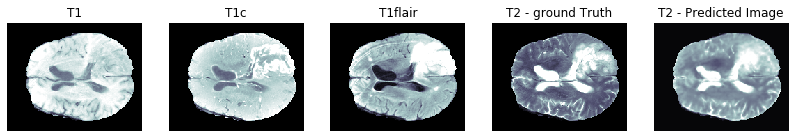

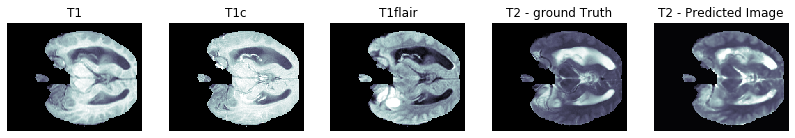

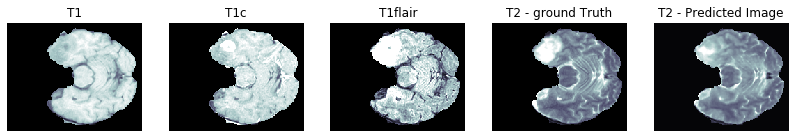

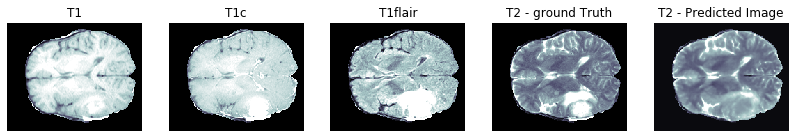

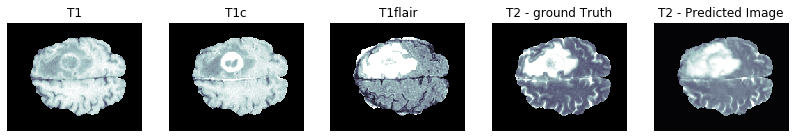

PSNR on validation set: 22.9101 ± 3.5920
MSE on validation set: 0.0065 ± 0.0043
SSIM on validation set: 0.8192 ± 0.0943

PSNR wrt tumor area on validation set: 33.5477 ± 11.2883
MSE wrt tumor area on validation set: 0.0013 ± 0.0015
SSIM wrt tumor area on validation set: 0.9702 ± 0.0272

Generator loss on validation set: 2.4416 ± 0.8756
Discriminator loss on validation set: 1.3887 ± 0.0199

Epoch:  36
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
........................................................................

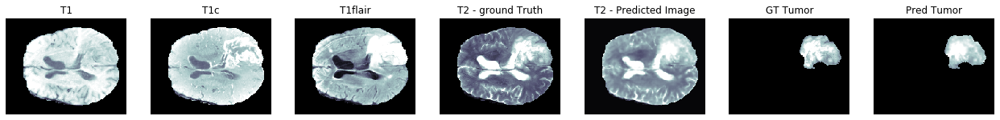

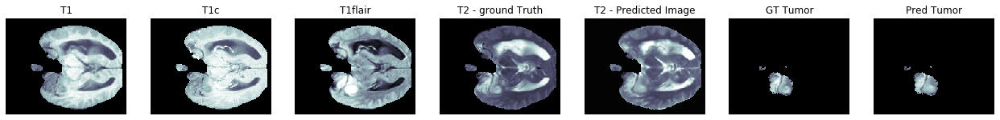

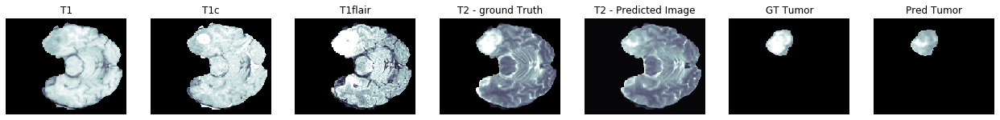

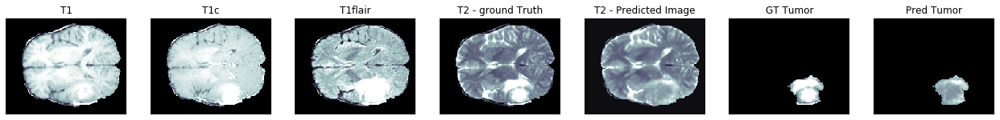

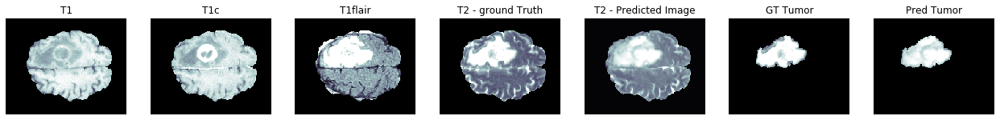

PSNR on validation set: 22.9092 ± 3.5889
MSE on validation set: 0.0065 ± 0.0043
SSIM on validation set: 0.8191 ± 0.0943

PSNR wrt tumor area on validation set: 33.6800 ± 11.9005
MSE wrt tumor area on validation set: 0.0013 ± 0.0015
SSIM wrt tumor area on validation set: 0.9703 ± 0.0270

Generator loss on validation set: 2.4112 ± 0.8778
Discriminator loss on validation set: 1.3849 ± 0.0262

Time taken for epoch 36 is 447.26451802253723 sec


Epoch:  37
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
....................

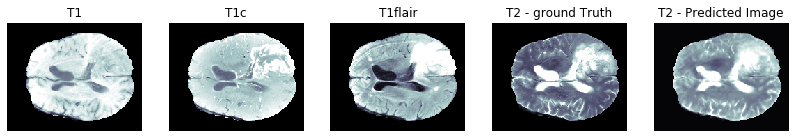

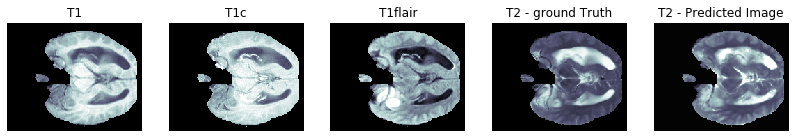

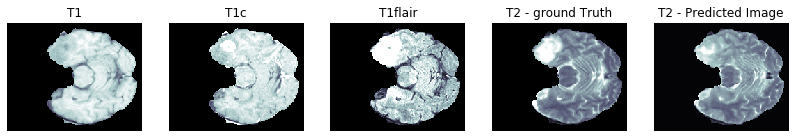

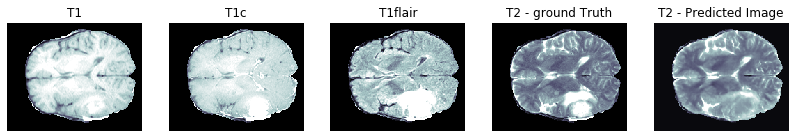

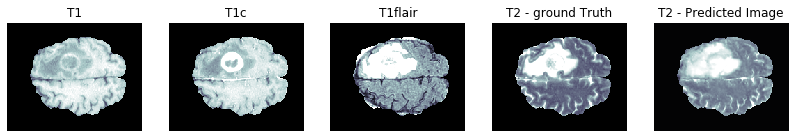

PSNR on validation set: 22.9312 ± 3.5413
MSE on validation set: 0.0064 ± 0.0041
SSIM on validation set: 0.8173 ± 0.0952

PSNR wrt tumor area on validation set: 33.7184 ± 11.7706
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9706 ± 0.0266

Generator loss on validation set: 2.3741 ± 0.8386
Discriminator loss on validation set: 1.4053 ± 0.0329

Time taken for epoch 37 is 437.64759278297424 sec


Epoch:  38
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
....................

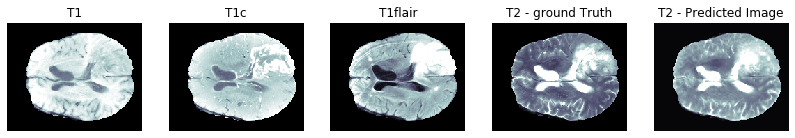

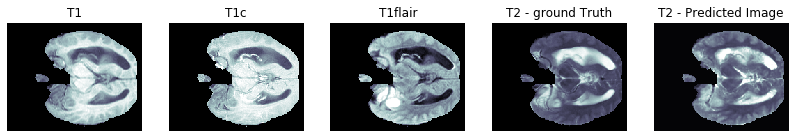

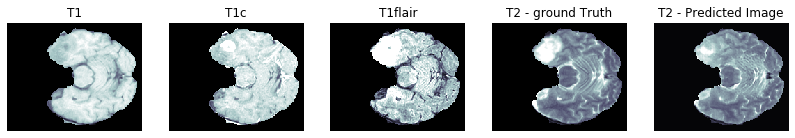

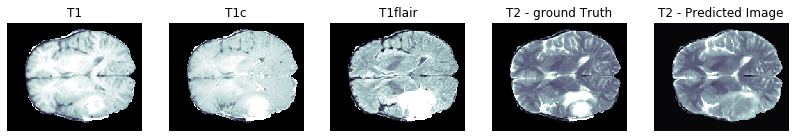

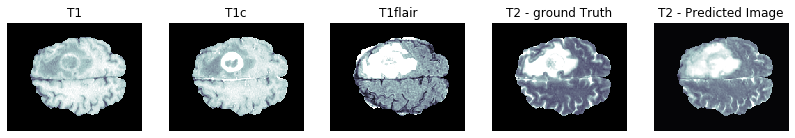

PSNR on validation set: 22.8817 ± 3.5540
MSE on validation set: 0.0065 ± 0.0042
SSIM on validation set: 0.8129 ± 0.0964

PSNR wrt tumor area on validation set: 33.5153 ± 11.1961
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9698 ± 0.0272

Generator loss on validation set: 2.4287 ± 0.8579
Discriminator loss on validation set: 1.3955 ± 0.0380

Time taken for epoch 38 is 436.9335300922394 sec


Epoch:  39
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
.....................

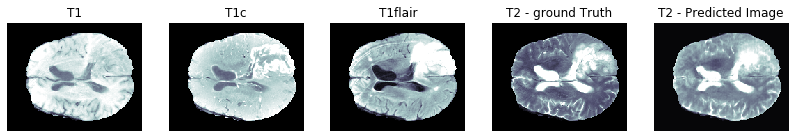

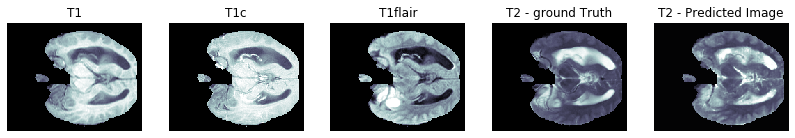

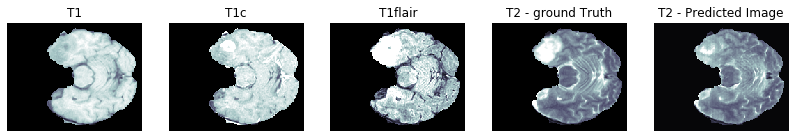

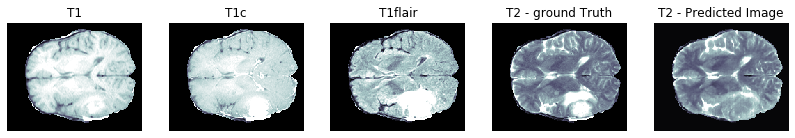

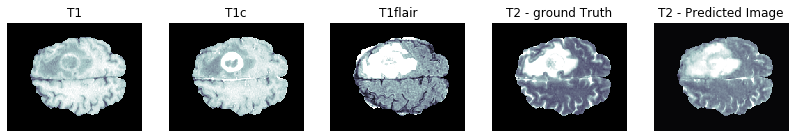

PSNR on validation set: 22.8458 ± 3.5769
MSE on validation set: 0.0066 ± 0.0043
SSIM on validation set: 0.8105 ± 0.0967

PSNR wrt tumor area on validation set: 33.4708 ± 11.6142
MSE wrt tumor area on validation set: 0.0013 ± 0.0015
SSIM wrt tumor area on validation set: 0.9690 ± 0.0278

Generator loss on validation set: 2.4475 ± 0.8421
Discriminator loss on validation set: 1.3912 ± 0.0215

Time taken for epoch 39 is 437.1595633029938 sec


Epoch:  40
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
.....................

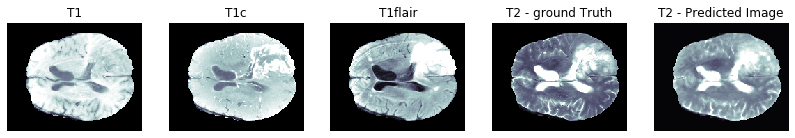

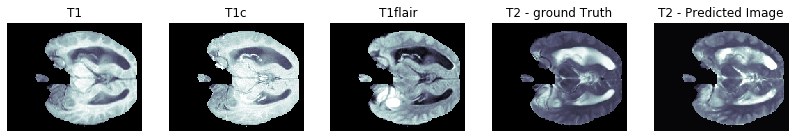

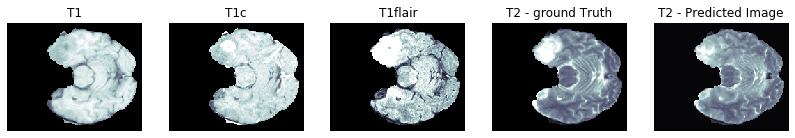

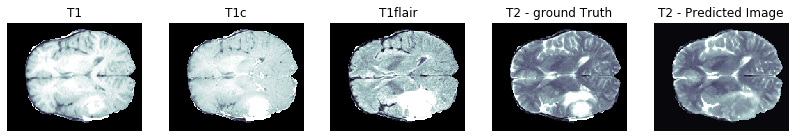

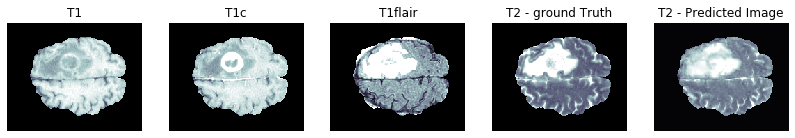

PSNR on validation set: 22.9286 ± 3.5821
MSE on validation set: 0.0065 ± 0.0042
SSIM on validation set: 0.8131 ± 0.0957

PSNR wrt tumor area on validation set: 33.5218 ± 11.3753
MSE wrt tumor area on validation set: 0.0013 ± 0.0015
SSIM wrt tumor area on validation set: 0.9698 ± 0.0273

Generator loss on validation set: 2.4784 ± 0.8504
Discriminator loss on validation set: 1.3739 ± 0.0299

Saving checkpoint for epoch 40 at ./drive/My Drive/checkpoints/train4/ckpt-9
Time taken for epoch 40 is 440.96538257598877 sec


Epoch:  41
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
................................................

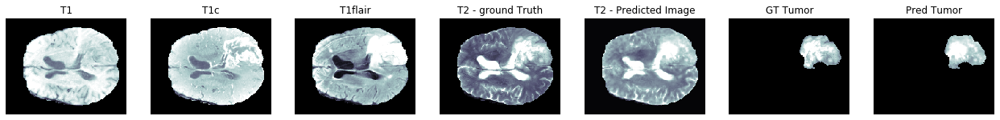

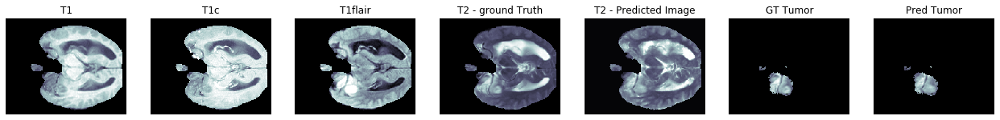

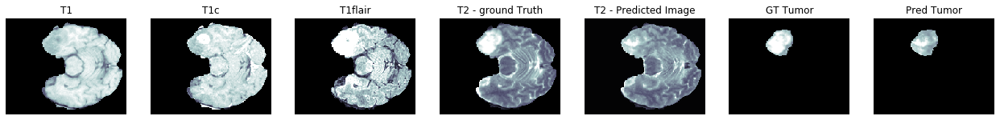

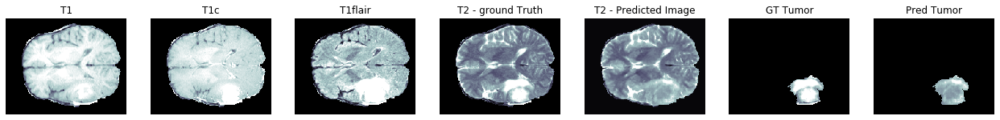

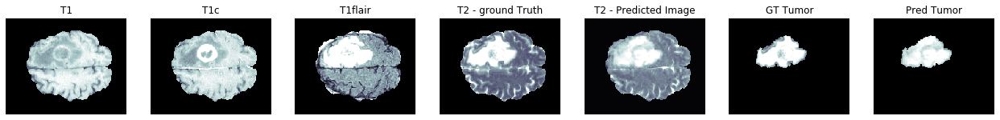

PSNR on validation set: 22.8670 ± 3.5170
MSE on validation set: 0.0065 ± 0.0042
SSIM on validation set: 0.8115 ± 0.0958

PSNR wrt tumor area on validation set: 33.5481 ± 11.2602
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9702 ± 0.0267

Generator loss on validation set: 2.4865 ± 0.8228
Discriminator loss on validation set: 1.3658 ± 0.0329

Time taken for epoch 41 is 437.9803464412689 sec


Epoch:  42
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
.....................

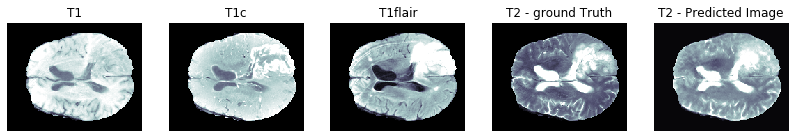

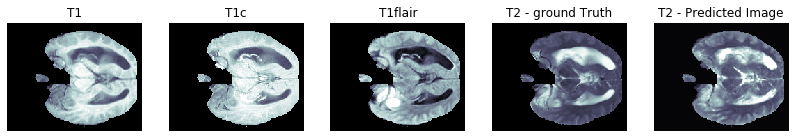

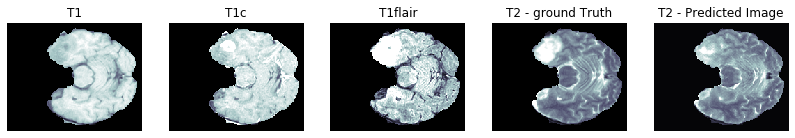

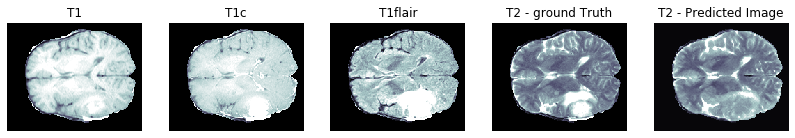

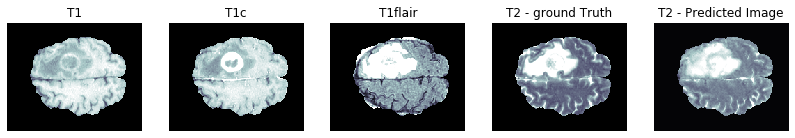

PSNR on validation set: 22.7949 ± 3.5136
MSE on validation set: 0.0066 ± 0.0042
SSIM on validation set: 0.8069 ± 0.0975

PSNR wrt tumor area on validation set: 33.6050 ± 12.2176
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9695 ± 0.0273

Generator loss on validation set: 2.4797 ± 0.8271
Discriminator loss on validation set: 1.3816 ± 0.0415

Time taken for epoch 42 is 436.760422706604 sec


Epoch:  43
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
......................

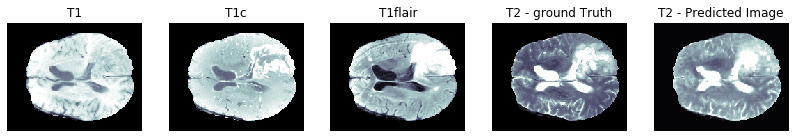

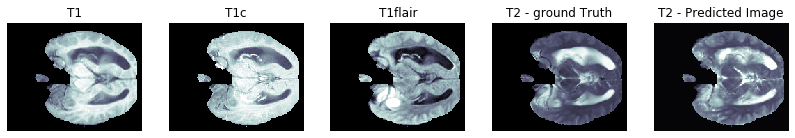

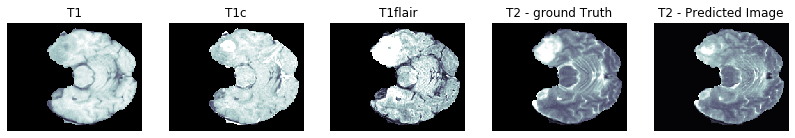

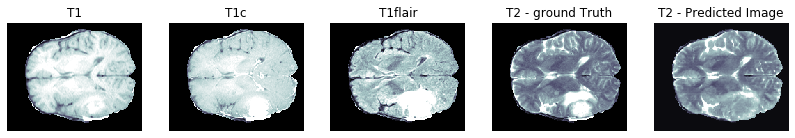

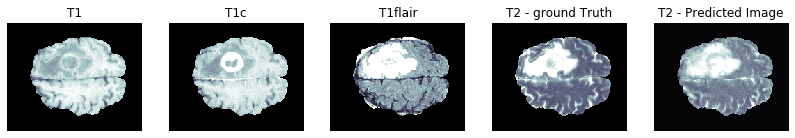

PSNR on validation set: 22.8472 ± 3.5170
MSE on validation set: 0.0065 ± 0.0041
SSIM on validation set: 0.8081 ± 0.0972

PSNR wrt tumor area on validation set: 33.5734 ± 11.8393
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9698 ± 0.0269

Generator loss on validation set: 2.4568 ± 0.8301
Discriminator loss on validation set: 1.3780 ± 0.0361

Time taken for epoch 43 is 436.5218081474304 sec


Epoch:  44
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
.....................

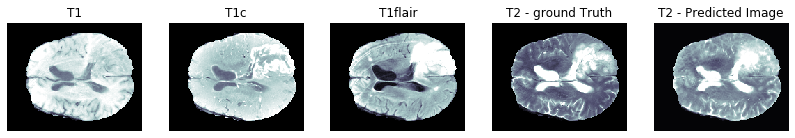

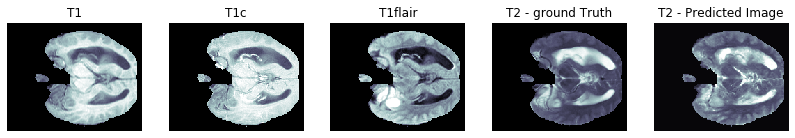

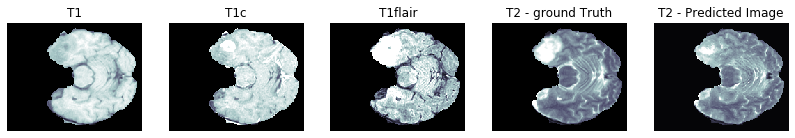

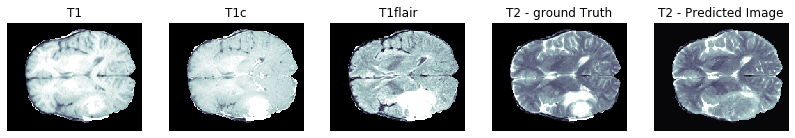

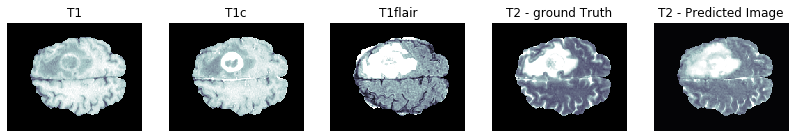

PSNR on validation set: 22.7995 ± 3.5467
MSE on validation set: 0.0066 ± 0.0041
SSIM on validation set: 0.8028 ± 0.0991

PSNR wrt tumor area on validation set: 33.5272 ± 12.3968
MSE wrt tumor area on validation set: 0.0013 ± 0.0015
SSIM wrt tumor area on validation set: 0.9692 ± 0.0276

Generator loss on validation set: 2.4308 ± 0.8191
Discriminator loss on validation set: 1.3898 ± 0.0429

Time taken for epoch 44 is 436.95235085487366 sec


Epoch:  45
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
....................

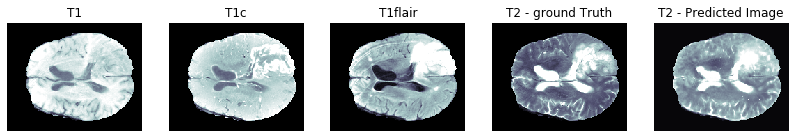

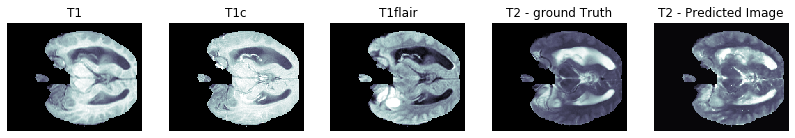

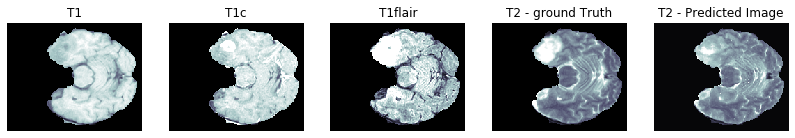

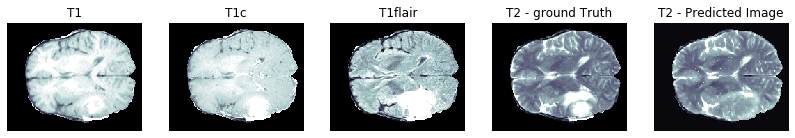

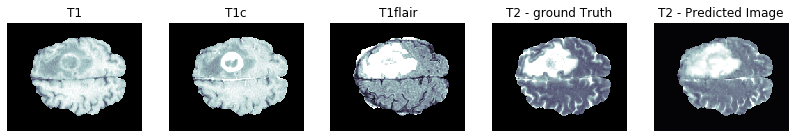

PSNR on validation set: 22.7971 ± 3.5544
MSE on validation set: 0.0066 ± 0.0042
SSIM on validation set: 0.8043 ± 0.0990

PSNR wrt tumor area on validation set: 33.4956 ± 11.8462
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9693 ± 0.0273

Generator loss on validation set: 2.4573 ± 0.8371
Discriminator loss on validation set: 1.3679 ± 0.0539

Saving checkpoint for epoch 45 at ./drive/My Drive/checkpoints/train4/ckpt-10
Time taken for epoch 45 is 440.03702664375305 sec


Epoch:  46
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
...............................................

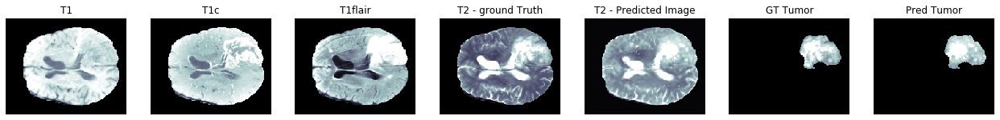

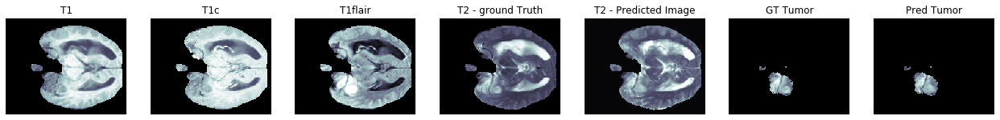

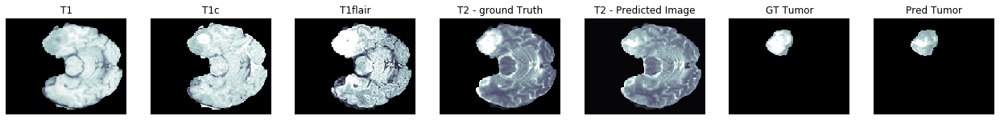

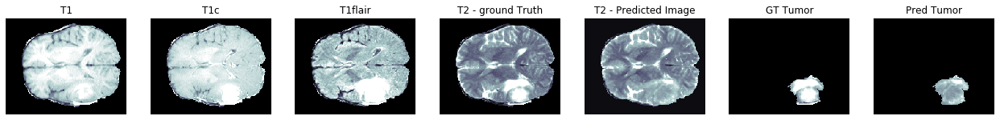

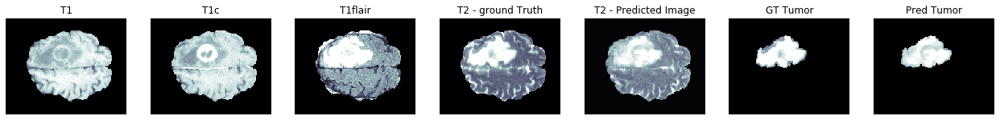

PSNR on validation set: 22.8104 ± 3.5335
MSE on validation set: 0.0066 ± 0.0041
SSIM on validation set: 0.8063 ± 0.0982

PSNR wrt tumor area on validation set: 33.5663 ± 11.8223
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9696 ± 0.0272

Generator loss on validation set: 2.4265 ± 0.8125
Discriminator loss on validation set: 1.3755 ± 0.0344

Time taken for epoch 46 is 437.73614978790283 sec


Epoch:  47
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
....................

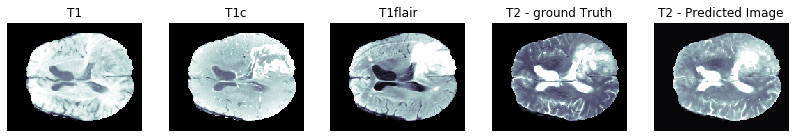

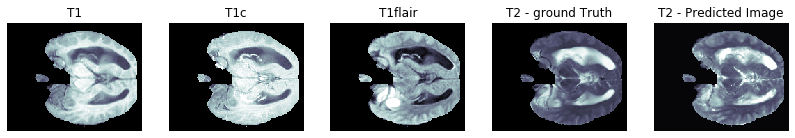

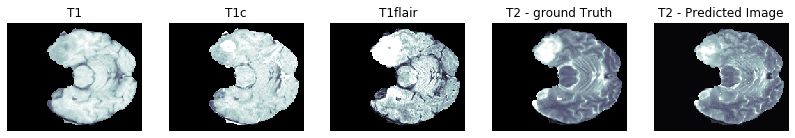

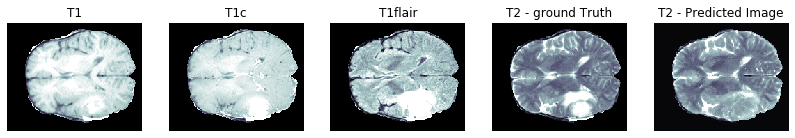

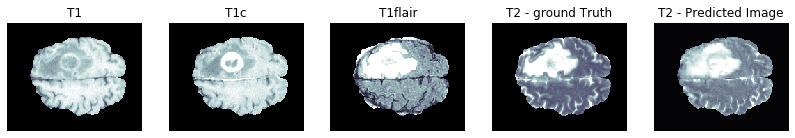

PSNR on validation set: 22.7675 ± 3.5364
MSE on validation set: 0.0066 ± 0.0041
SSIM on validation set: 0.8015 ± 0.0996

PSNR wrt tumor area on validation set: 33.5645 ± 12.0949
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9694 ± 0.0272

Generator loss on validation set: 2.4655 ± 0.8008
Discriminator loss on validation set: 1.3784 ± 0.0500

Time taken for epoch 47 is 436.75948452949524 sec


Epoch:  48
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
....................

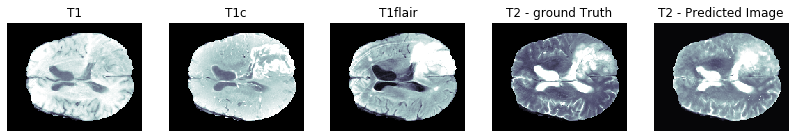

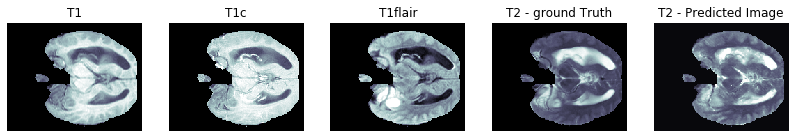

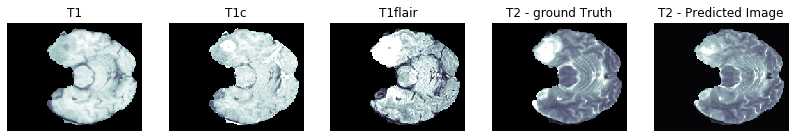

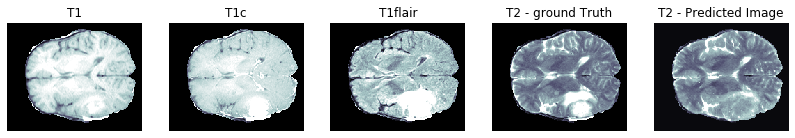

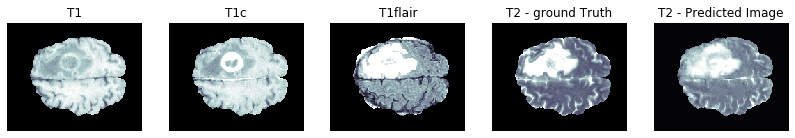

PSNR on validation set: 22.7769 ± 3.5805
MSE on validation set: 0.0066 ± 0.0042
SSIM on validation set: 0.8027 ± 0.0988

PSNR wrt tumor area on validation set: 33.3399 ± 11.1836
MSE wrt tumor area on validation set: 0.0013 ± 0.0015
SSIM wrt tumor area on validation set: 0.9690 ± 0.0277

Generator loss on validation set: 2.4362 ± 0.8237
Discriminator loss on validation set: 1.3856 ± 0.0373

Time taken for epoch 48 is 437.14372181892395 sec


Epoch:  49
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
....................

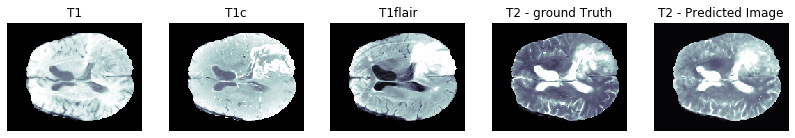

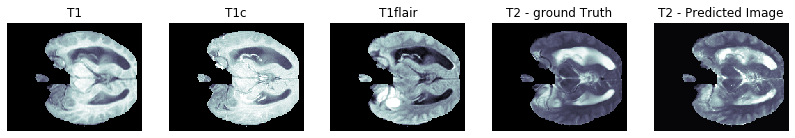

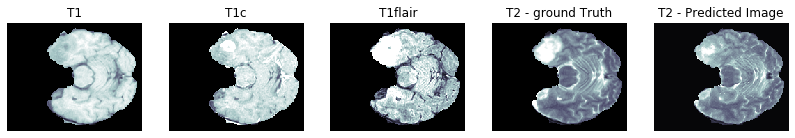

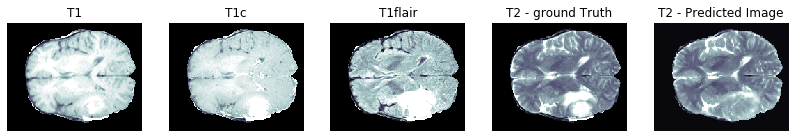

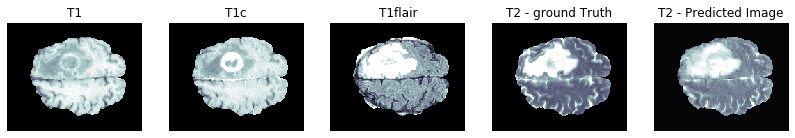

PSNR on validation set: 22.7866 ± 3.5210
MSE on validation set: 0.0066 ± 0.0042
SSIM on validation set: 0.8034 ± 0.0986

PSNR wrt tumor area on validation set: 33.5213 ± 11.7060
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9697 ± 0.0268

Generator loss on validation set: 2.4271 ± 0.8308
Discriminator loss on validation set: 1.3731 ± 0.0383

Time taken for epoch 49 is 437.06953024864197 sec


Epoch:  50
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
....................

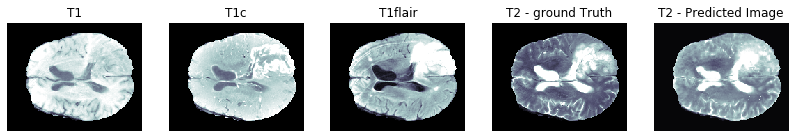

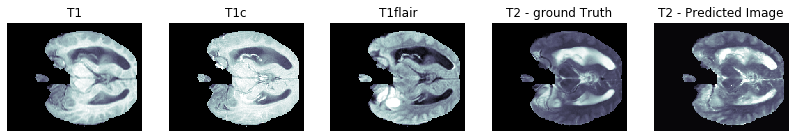

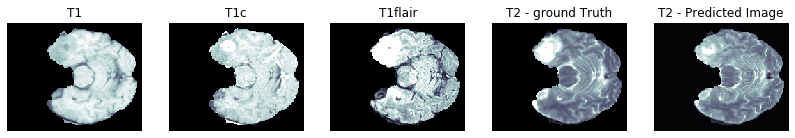

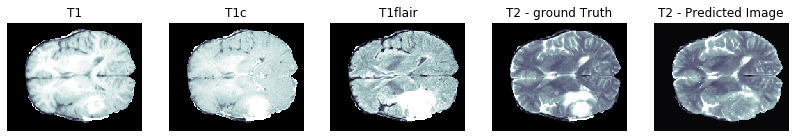

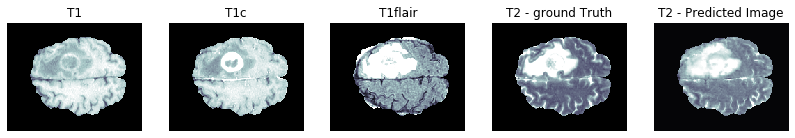

PSNR on validation set: 22.7785 ± 3.5451
MSE on validation set: 0.0066 ± 0.0042
SSIM on validation set: 0.8028 ± 0.0989

PSNR wrt tumor area on validation set: 33.5317 ± 12.1696
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9693 ± 0.0274

Generator loss on validation set: 2.4283 ± 0.8301
Discriminator loss on validation set: 1.3886 ± 0.0381

Saving checkpoint for epoch 50 at ./drive/My Drive/checkpoints/train4/ckpt-11
Time taken for epoch 50 is 439.8547079563141 sec


Epoch:  51
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
................................................

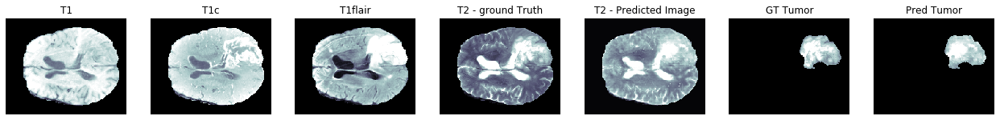

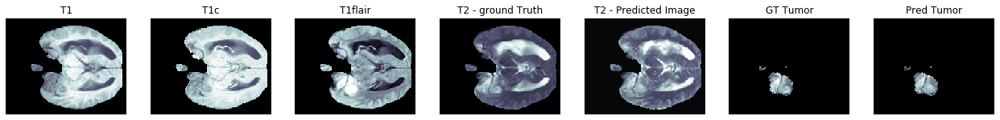

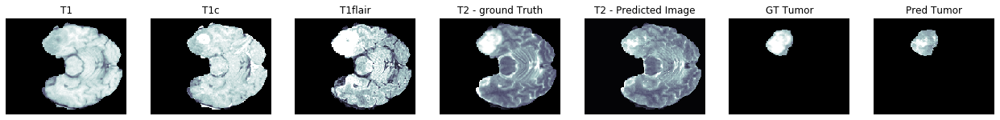

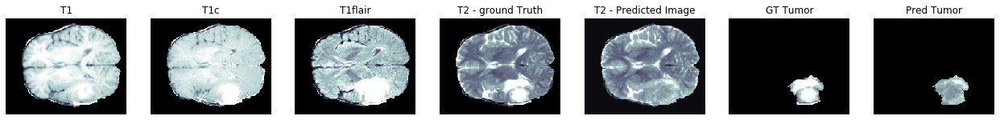

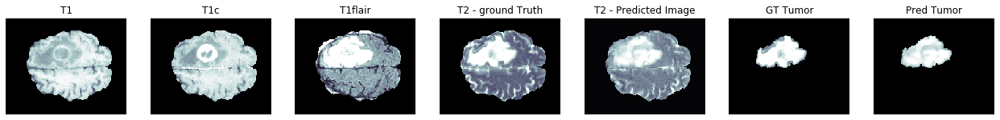

PSNR on validation set: 22.7393 ± 3.5304
MSE on validation set: 0.0067 ± 0.0041
SSIM on validation set: 0.7998 ± 0.1000

PSNR wrt tumor area on validation set: 33.4047 ± 11.3955
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9688 ± 0.0275

Generator loss on validation set: 2.4869 ± 0.8308
Discriminator loss on validation set: 1.3895 ± 0.0444

Time taken for epoch 51 is 437.8358516693115 sec


Epoch:  52
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
.....................

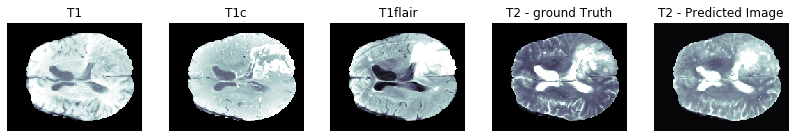

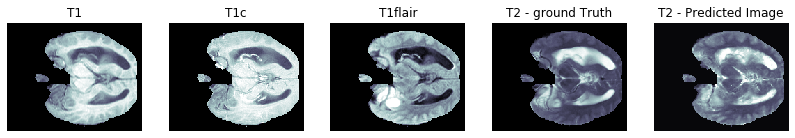

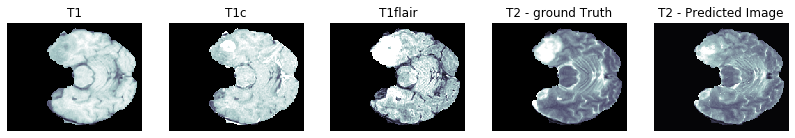

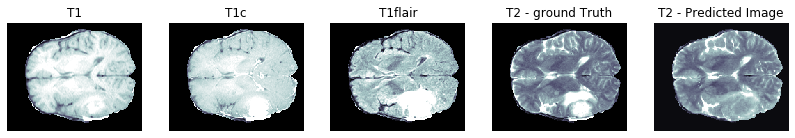

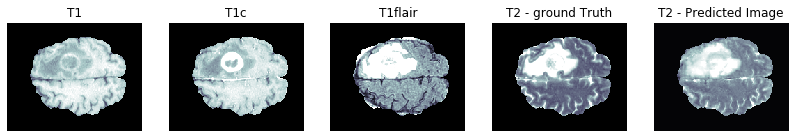

PSNR on validation set: 22.8385 ± 3.5518
MSE on validation set: 0.0065 ± 0.0041
SSIM on validation set: 0.8057 ± 0.0981

PSNR wrt tumor area on validation set: 33.4983 ± 11.5961
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9695 ± 0.0271

Generator loss on validation set: 2.4541 ± 0.8222
Discriminator loss on validation set: 1.3739 ± 0.0313

Time taken for epoch 52 is 437.48597383499146 sec


Epoch:  53
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
....................

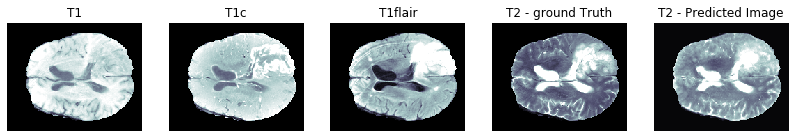

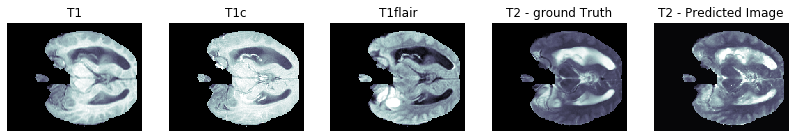

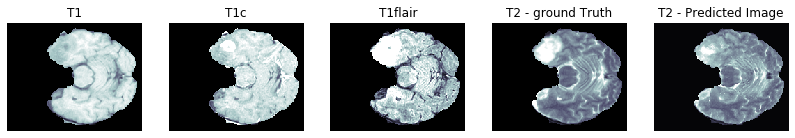

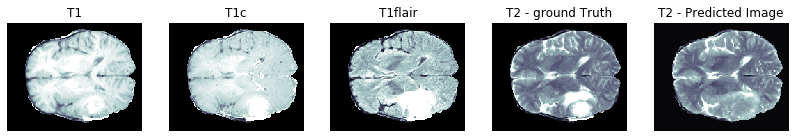

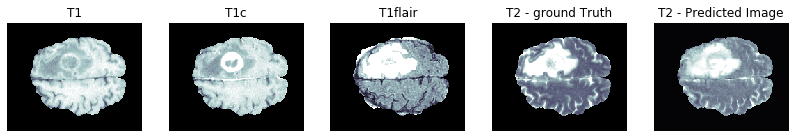

PSNR on validation set: 22.7824 ± 3.5861
MSE on validation set: 0.0066 ± 0.0042
SSIM on validation set: 0.8030 ± 0.0991

PSNR wrt tumor area on validation set: 33.4546 ± 11.3563
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9692 ± 0.0273

Generator loss on validation set: 2.4508 ± 0.8147
Discriminator loss on validation set: 1.3796 ± 0.0357

Time taken for epoch 53 is 437.07230830192566 sec


Epoch:  54
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
....................

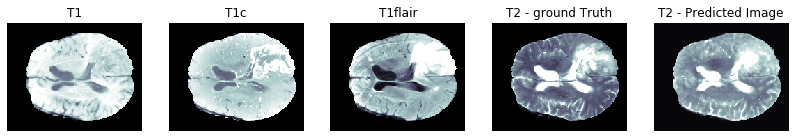

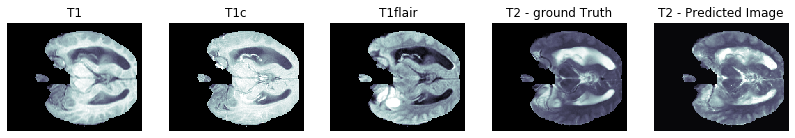

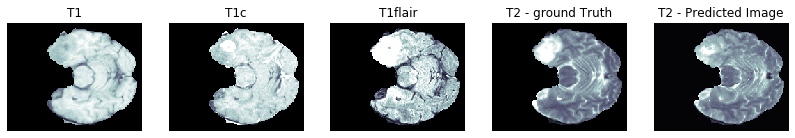

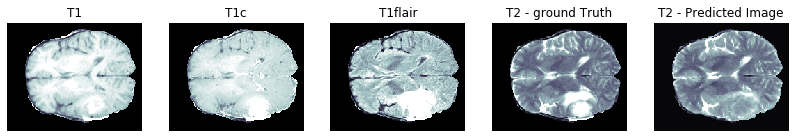

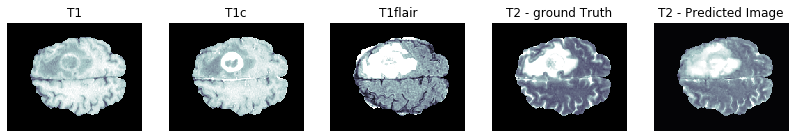

PSNR on validation set: 22.8264 ± 3.5632
MSE on validation set: 0.0066 ± 0.0042
SSIM on validation set: 0.8058 ± 0.0982

PSNR wrt tumor area on validation set: 33.5385 ± 12.1270
MSE wrt tumor area on validation set: 0.0013 ± 0.0015
SSIM wrt tumor area on validation set: 0.9694 ± 0.0273

Generator loss on validation set: 2.5101 ± 0.8263
Discriminator loss on validation set: 1.3730 ± 0.0389

Time taken for epoch 54 is 436.80812883377075 sec


Epoch:  55
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
....................

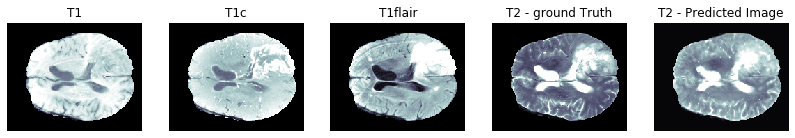

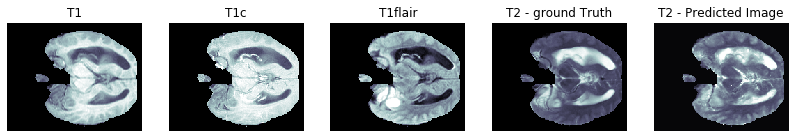

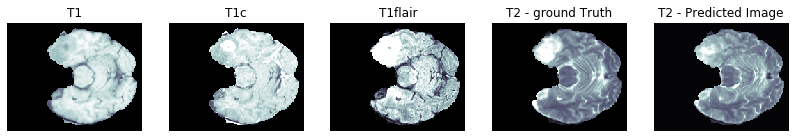

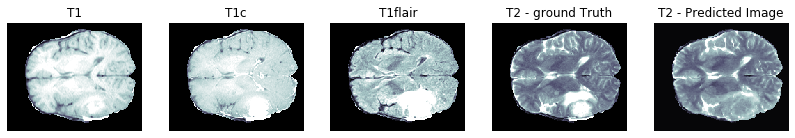

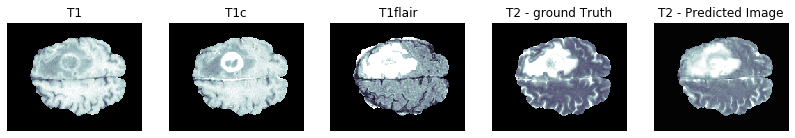

PSNR on validation set: 22.8352 ± 3.5712
MSE on validation set: 0.0066 ± 0.0042
SSIM on validation set: 0.8064 ± 0.0980

PSNR wrt tumor area on validation set: 33.4261 ± 10.8707
MSE wrt tumor area on validation set: 0.0013 ± 0.0015
SSIM wrt tumor area on validation set: 0.9695 ± 0.0272

Generator loss on validation set: 2.4535 ± 0.8225
Discriminator loss on validation set: 1.3803 ± 0.0338

Saving checkpoint for epoch 55 at ./drive/My Drive/checkpoints/train4/ckpt-12
Time taken for epoch 55 is 440.59477519989014 sec


Epoch:  56
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
...............................................

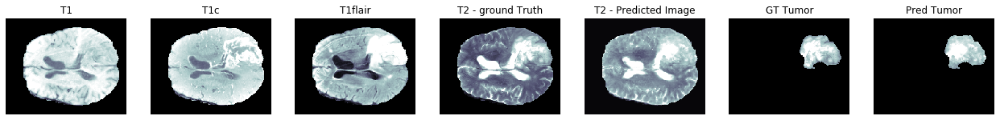

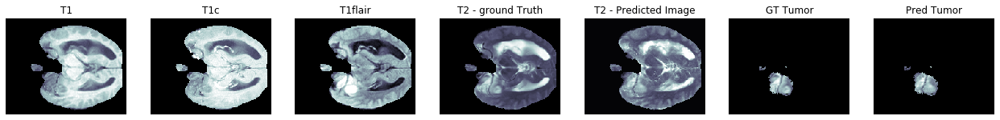

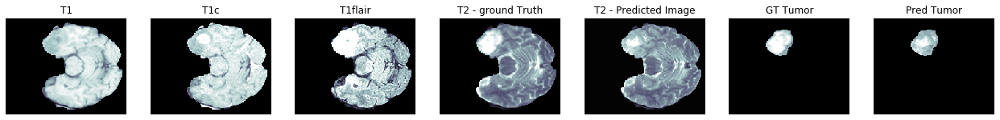

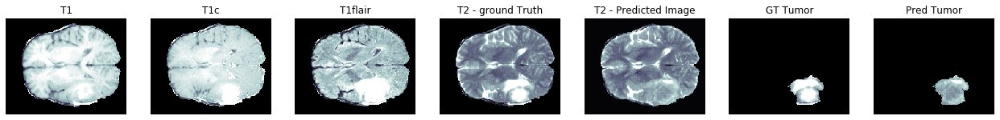

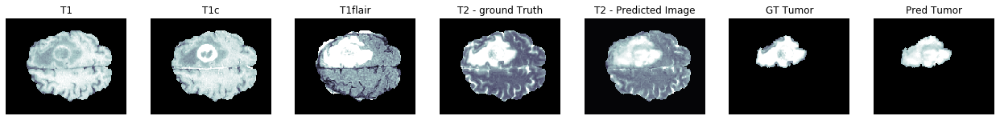

PSNR on validation set: 22.7734 ± 3.5486
MSE on validation set: 0.0066 ± 0.0042
SSIM on validation set: 0.8004 ± 0.1001

PSNR wrt tumor area on validation set: 33.4911 ± 12.0996
MSE wrt tumor area on validation set: 0.0013 ± 0.0015
SSIM wrt tumor area on validation set: 0.9688 ± 0.0277

Generator loss on validation set: 2.4516 ± 0.8146
Discriminator loss on validation set: 1.3888 ± 0.0408

Time taken for epoch 56 is 439.49992990493774 sec


Epoch:  57
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
....................

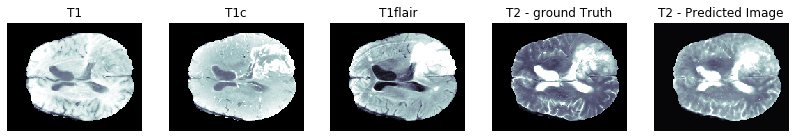

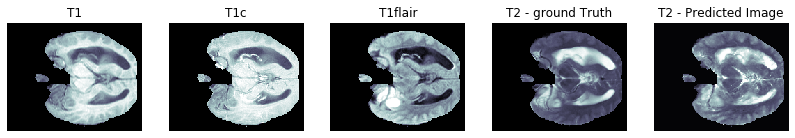

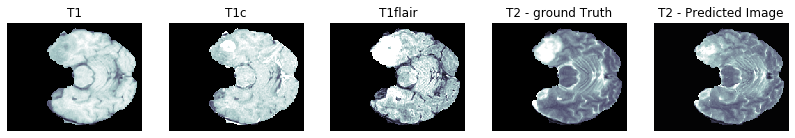

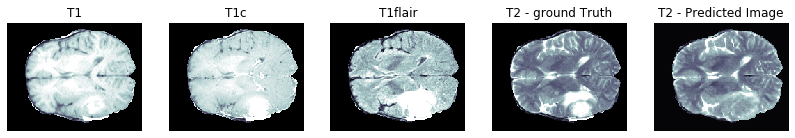

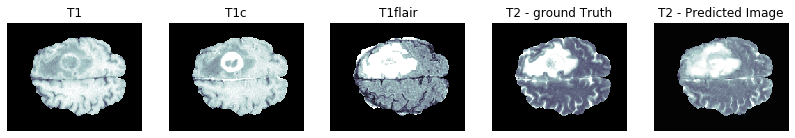

PSNR on validation set: 22.8582 ± 3.5331
MSE on validation set: 0.0065 ± 0.0040
SSIM on validation set: 0.8053 ± 0.0984

PSNR wrt tumor area on validation set: 33.5035 ± 11.1763
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9700 ± 0.0267

Generator loss on validation set: 2.4887 ± 0.8240
Discriminator loss on validation set: 1.3669 ± 0.0454

Time taken for epoch 57 is 438.1280286312103 sec


Epoch:  58
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
.....................

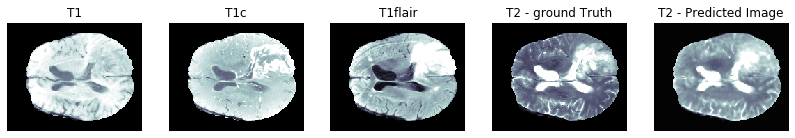

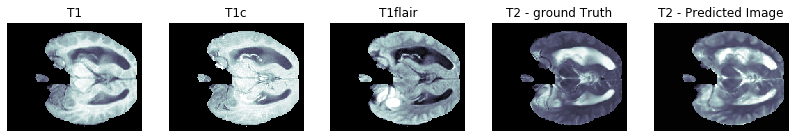

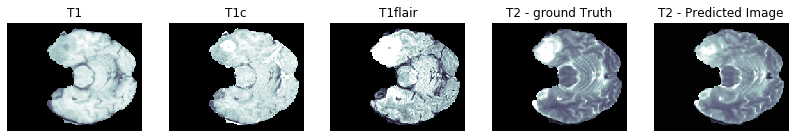

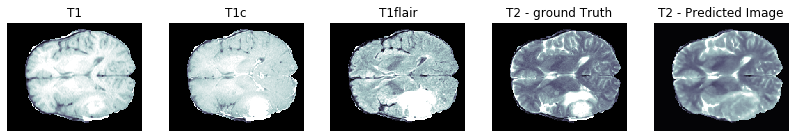

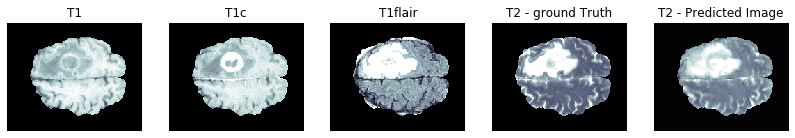

PSNR on validation set: 23.0638 ± 3.5210
MSE on validation set: 0.0062 ± 0.0039
SSIM on validation set: 0.8198 ± 0.0939

PSNR wrt tumor area on validation set: 33.8708 ± 11.4888
MSE wrt tumor area on validation set: 0.0012 ± 0.0013
SSIM wrt tumor area on validation set: 0.9717 ± 0.0252

Generator loss on validation set: 2.4160 ± 0.8238
Discriminator loss on validation set: 1.3865 ± 0.0029

Time taken for epoch 58 is 438.2748670578003 sec


Epoch:  59
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
.....................

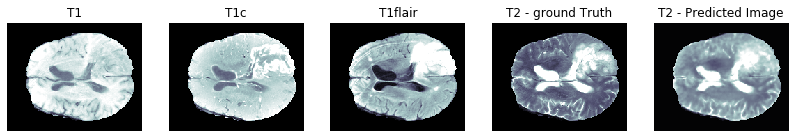

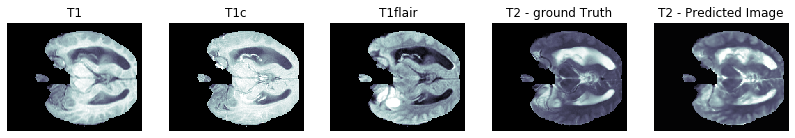

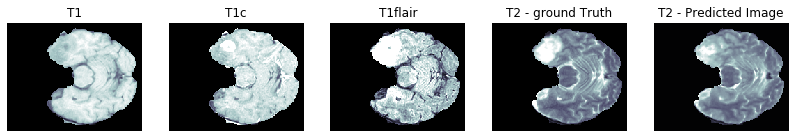

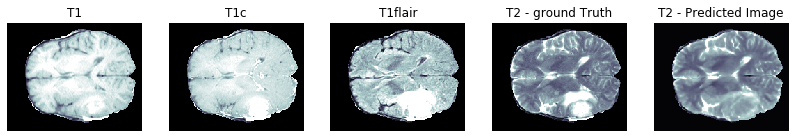

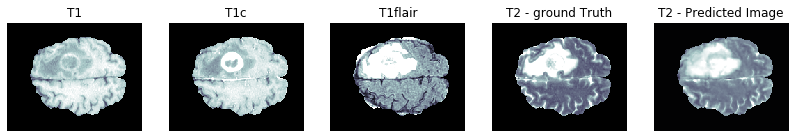

PSNR on validation set: 23.0963 ± 3.5944
MSE on validation set: 0.0062 ± 0.0040
SSIM on validation set: 0.8205 ± 0.0940

PSNR wrt tumor area on validation set: 33.6670 ± 10.8087
MSE wrt tumor area on validation set: 0.0012 ± 0.0014
SSIM wrt tumor area on validation set: 0.9711 ± 0.0261

Generator loss on validation set: 2.3941 ± 0.8334
Discriminator loss on validation set: 1.3823 ± 0.0060

Time taken for epoch 59 is 437.16007685661316 sec


Epoch:  60
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
....................

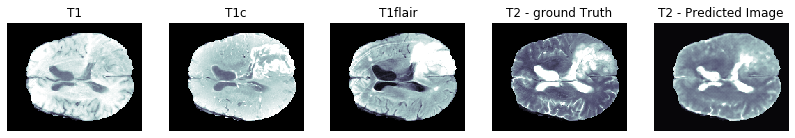

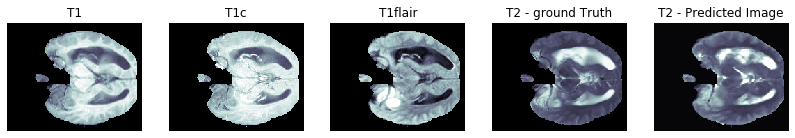

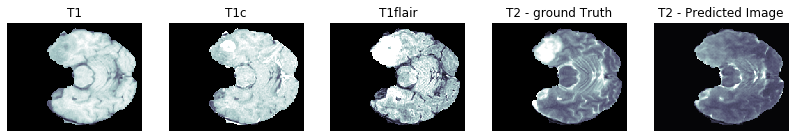

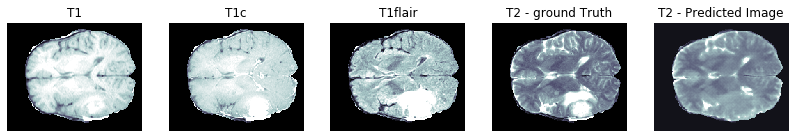

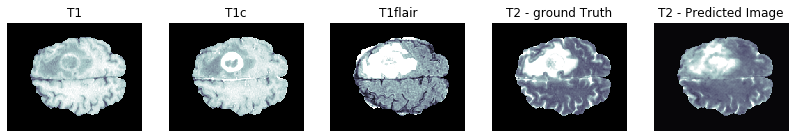

PSNR on validation set: 21.8896 ± 3.5768
MSE on validation set: 0.0083 ± 0.0054
SSIM on validation set: 0.7877 ± 0.1035

PSNR wrt tumor area on validation set: 32.0839 ± 11.6139
MSE wrt tumor area on validation set: 0.0020 ± 0.0024
SSIM wrt tumor area on validation set: 0.9602 ± 0.0363

Generator loss on validation set: 2.6472 ± 1.0304
Discriminator loss on validation set: 1.3842 ± 0.0074

Saving checkpoint for epoch 60 at ./drive/My Drive/checkpoints/train4/ckpt-13
Time taken for epoch 60 is 439.86580085754395 sec


Epoch:  61
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
...............................................

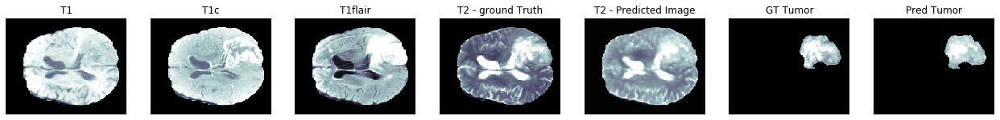

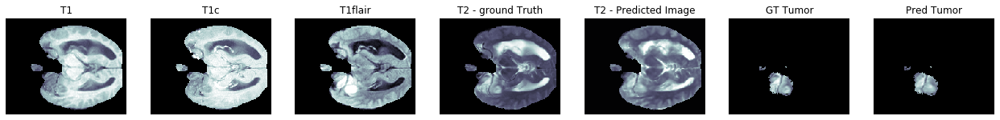

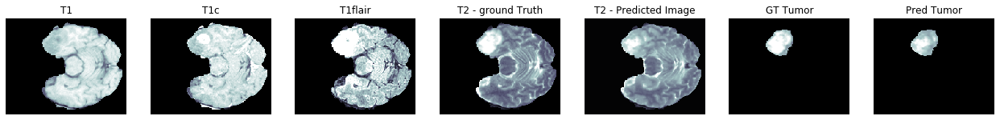

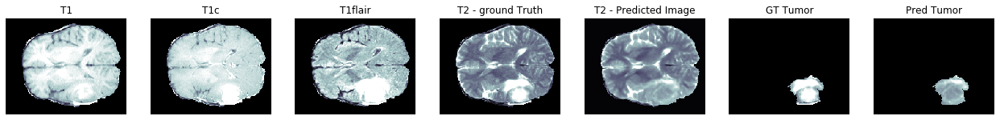

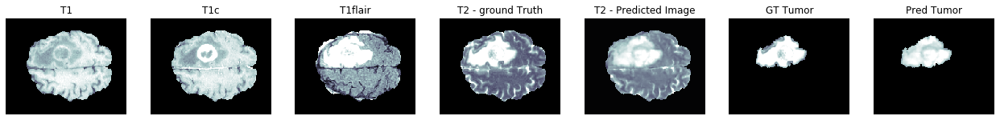

PSNR on validation set: 23.0701 ± 3.5705
MSE on validation set: 0.0062 ± 0.0040
SSIM on validation set: 0.8206 ± 0.0939

PSNR wrt tumor area on validation set: 33.7390 ± 11.3429
MSE wrt tumor area on validation set: 0.0012 ± 0.0014
SSIM wrt tumor area on validation set: 0.9712 ± 0.0259

Generator loss on validation set: 2.3957 ± 0.8167
Discriminator loss on validation set: 1.3928 ± 0.0070

Time taken for epoch 61 is 437.2179367542267 sec


Epoch:  62
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
.....................

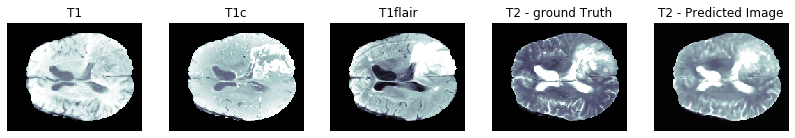

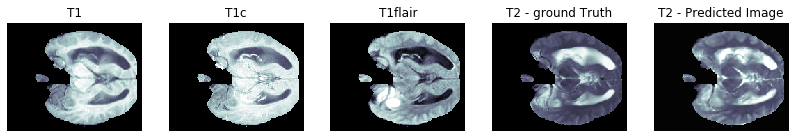

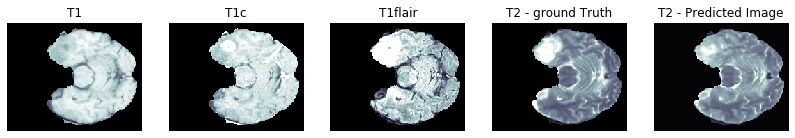

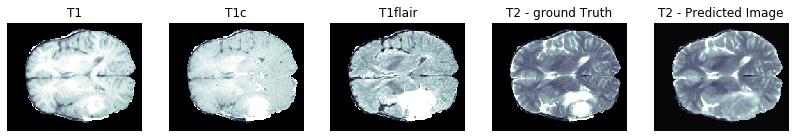

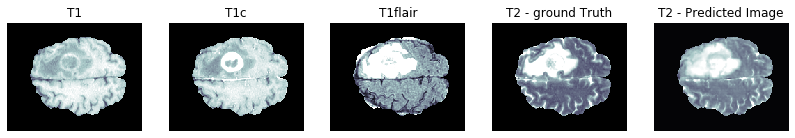

PSNR on validation set: 23.0035 ± 3.5497
MSE on validation set: 0.0063 ± 0.0040
SSIM on validation set: 0.8174 ± 0.0954

PSNR wrt tumor area on validation set: 33.7920 ± 11.9140
MSE wrt tumor area on validation set: 0.0012 ± 0.0014
SSIM wrt tumor area on validation set: 0.9709 ± 0.0260

Generator loss on validation set: 2.4024 ± 0.8402
Discriminator loss on validation set: 1.4050 ± 0.0141

Time taken for epoch 62 is 437.6737780570984 sec


Epoch:  63
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
.....................

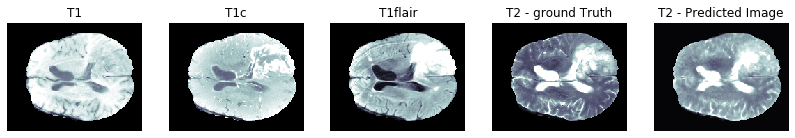

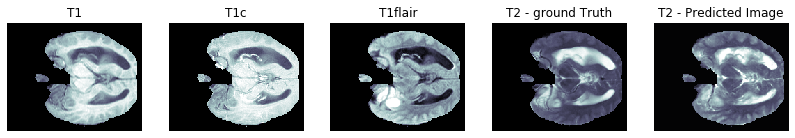

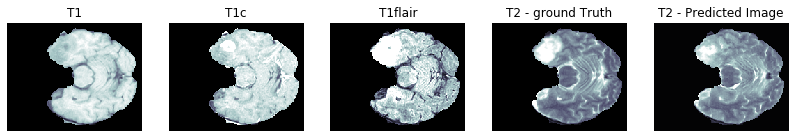

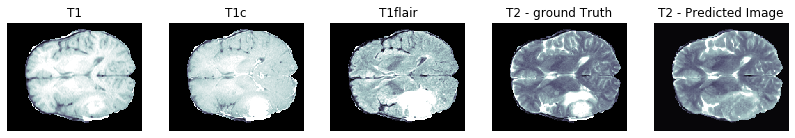

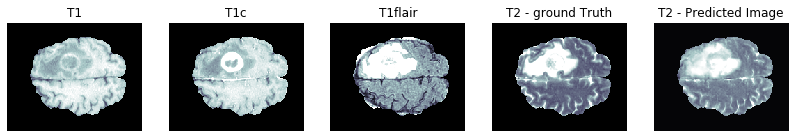

PSNR on validation set: 22.9506 ± 3.5563
MSE on validation set: 0.0064 ± 0.0040
SSIM on validation set: 0.8110 ± 0.0972

PSNR wrt tumor area on validation set: 33.6885 ± 12.5438
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9699 ± 0.0270

Generator loss on validation set: 2.4015 ± 0.8298
Discriminator loss on validation set: 1.3807 ± 0.0305

Time taken for epoch 63 is 438.70494055747986 sec


Epoch:  64
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
....................

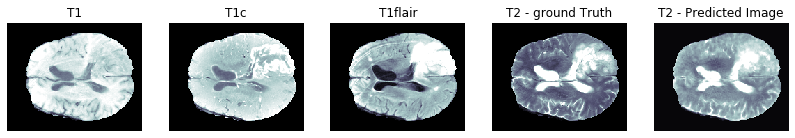

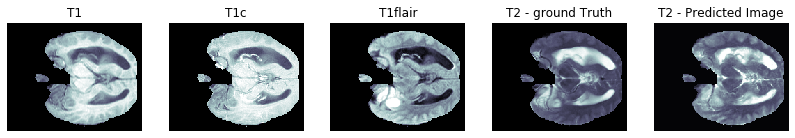

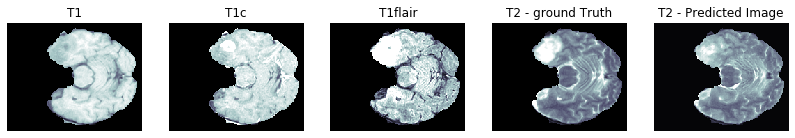

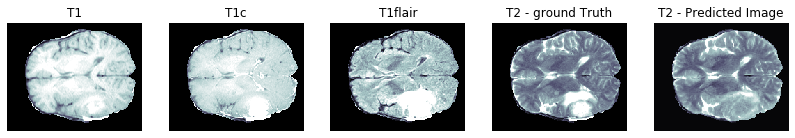

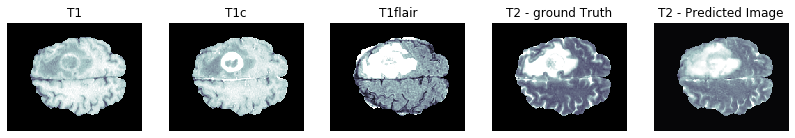

PSNR on validation set: 22.9249 ± 3.5815
MSE on validation set: 0.0064 ± 0.0040
SSIM on validation set: 0.8085 ± 0.0975

PSNR wrt tumor area on validation set: 33.6972 ± 12.1516
MSE wrt tumor area on validation set: 0.0012 ± 0.0014
SSIM wrt tumor area on validation set: 0.9703 ± 0.0265

Generator loss on validation set: 2.4058 ± 0.8288
Discriminator loss on validation set: 1.3797 ± 0.0196

Time taken for epoch 64 is 438.39654541015625 sec


Epoch:  65
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
....................

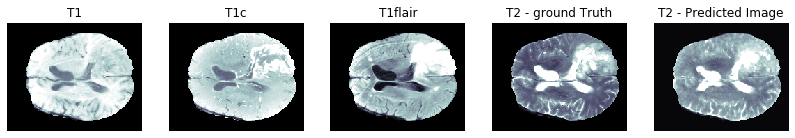

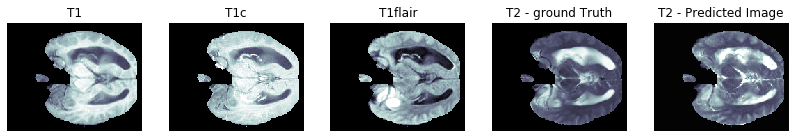

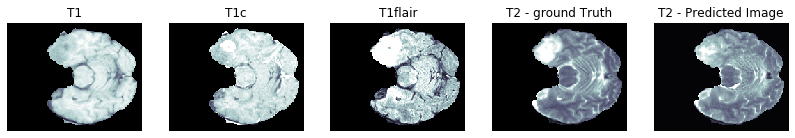

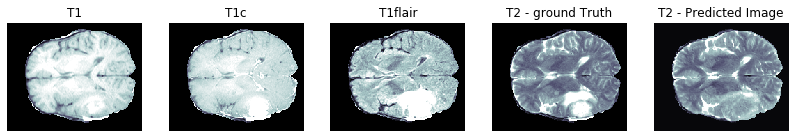

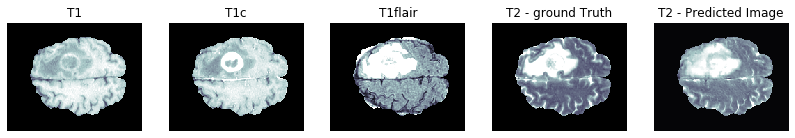

PSNR on validation set: 22.7934 ± 3.5567
MSE on validation set: 0.0066 ± 0.0041
SSIM on validation set: 0.8036 ± 0.0994

PSNR wrt tumor area on validation set: 33.4765 ± 11.5398
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9692 ± 0.0273

Generator loss on validation set: 2.3372 ± 0.8171
Discriminator loss on validation set: 1.4051 ± 0.0240

Saving checkpoint for epoch 65 at ./drive/My Drive/checkpoints/train4/ckpt-14
Time taken for epoch 65 is 441.3911998271942 sec


Epoch:  66
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
................................................

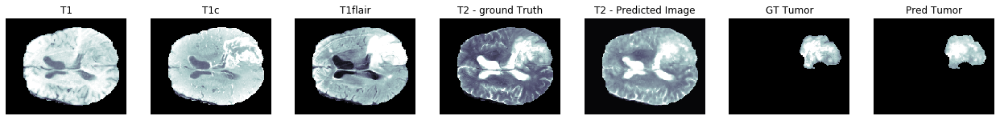

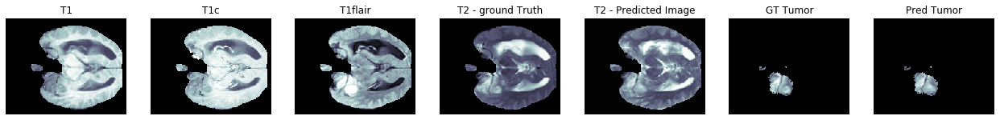

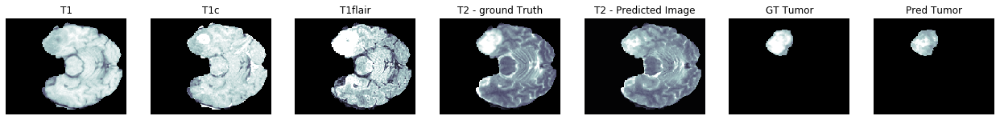

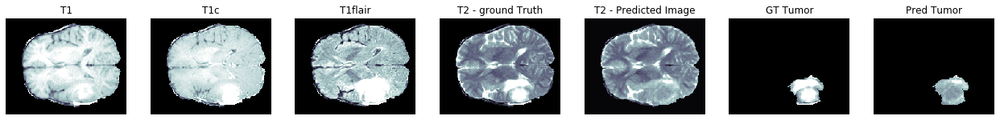

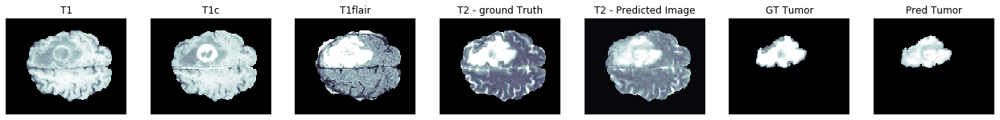

PSNR on validation set: 22.9158 ± 3.5924
MSE on validation set: 0.0064 ± 0.0041
SSIM on validation set: 0.8083 ± 0.0974

PSNR wrt tumor area on validation set: 33.6464 ± 11.8268
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9701 ± 0.0266

Generator loss on validation set: 2.4269 ± 0.8163
Discriminator loss on validation set: 1.3727 ± 0.0223

Time taken for epoch 66 is 438.62519931793213 sec


Epoch:  67
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
....................

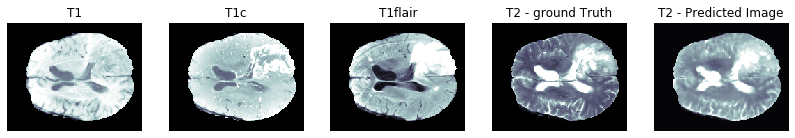

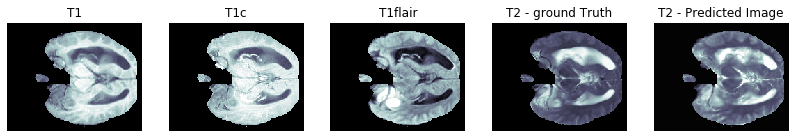

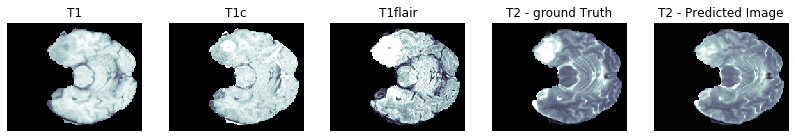

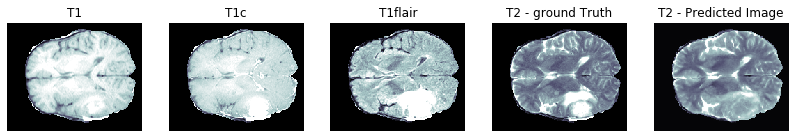

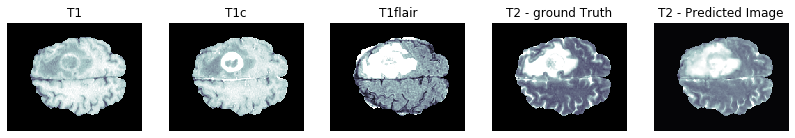

PSNR on validation set: 22.9739 ± 3.6011
MSE on validation set: 0.0063 ± 0.0040
SSIM on validation set: 0.8145 ± 0.0953

PSNR wrt tumor area on validation set: 33.6613 ± 11.0280
MSE wrt tumor area on validation set: 0.0012 ± 0.0014
SSIM wrt tumor area on validation set: 0.9707 ± 0.0263

Generator loss on validation set: 2.3170 ± 0.8077
Discriminator loss on validation set: 1.3975 ± 0.0131

Time taken for epoch 67 is 438.45802426338196 sec


Epoch:  68
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
....................

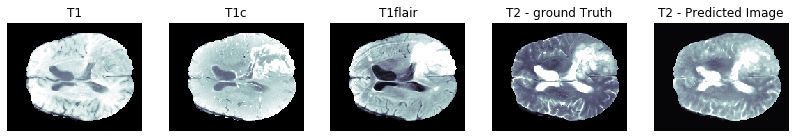

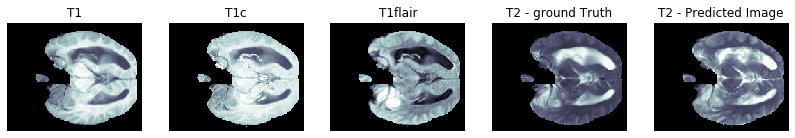

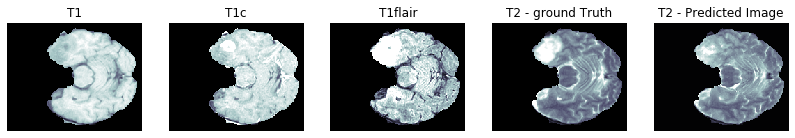

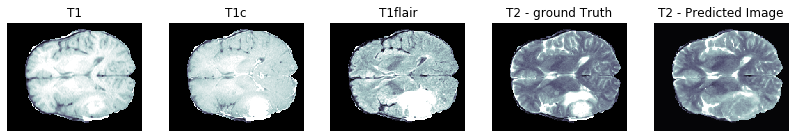

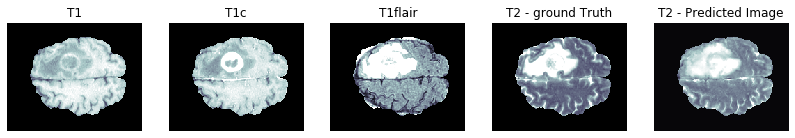

PSNR on validation set: 22.8757 ± 3.5950
MSE on validation set: 0.0065 ± 0.0041
SSIM on validation set: 0.8076 ± 0.0976

PSNR wrt tumor area on validation set: 33.6031 ± 11.8081
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9700 ± 0.0268

Generator loss on validation set: 2.4442 ± 0.8092
Discriminator loss on validation set: 1.3699 ± 0.0380

Time taken for epoch 68 is 438.50048756599426 sec


Epoch:  69
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
....................

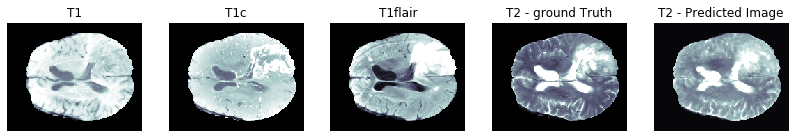

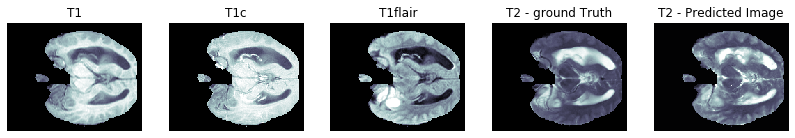

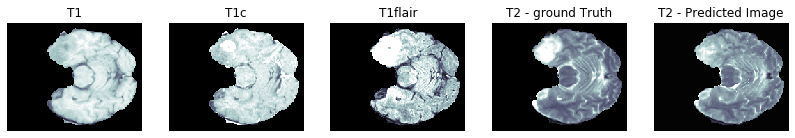

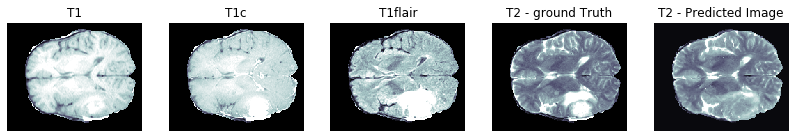

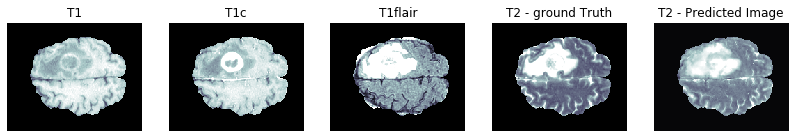

PSNR on validation set: 22.8666 ± 3.5523
MSE on validation set: 0.0065 ± 0.0041
SSIM on validation set: 0.8062 ± 0.0982

PSNR wrt tumor area on validation set: 33.4579 ± 11.2166
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9697 ± 0.0269

Generator loss on validation set: 2.4252 ± 0.8363
Discriminator loss on validation set: 1.3797 ± 0.0217

Time taken for epoch 69 is 437.86780738830566 sec


Epoch:  70
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
....................

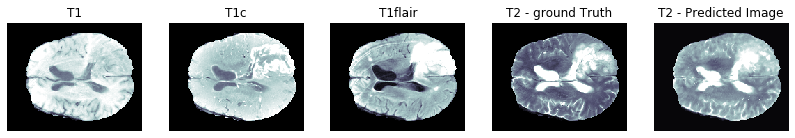

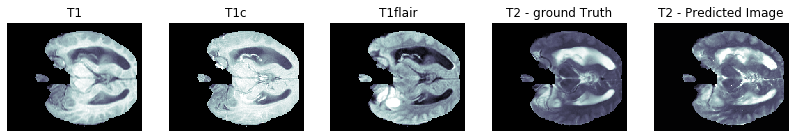

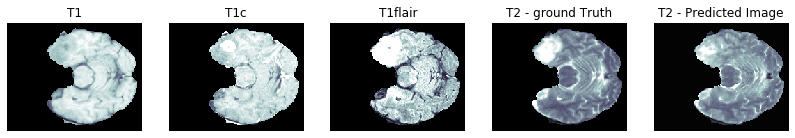

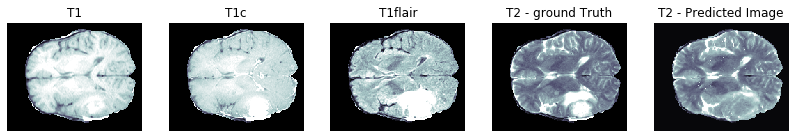

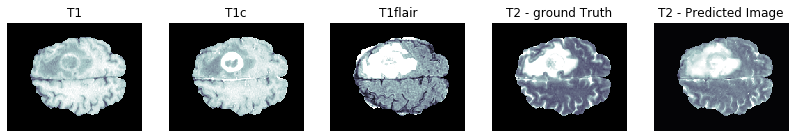

PSNR on validation set: 22.8155 ± 3.5418
MSE on validation set: 0.0065 ± 0.0041
SSIM on validation set: 0.8038 ± 0.0986

PSNR wrt tumor area on validation set: 33.4777 ± 11.1612
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9701 ± 0.0264

Generator loss on validation set: 2.4313 ± 0.8224
Discriminator loss on validation set: 1.3790 ± 0.0429

Saving checkpoint for epoch 70 at ./drive/My Drive/checkpoints/train4/ckpt-15
Time taken for epoch 70 is 441.3370249271393 sec


Epoch:  71
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
................................................

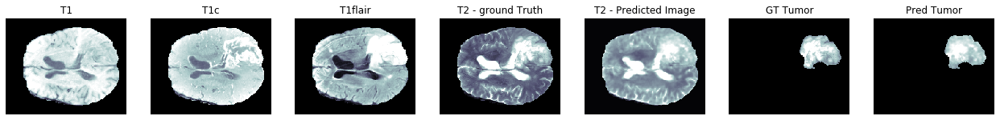

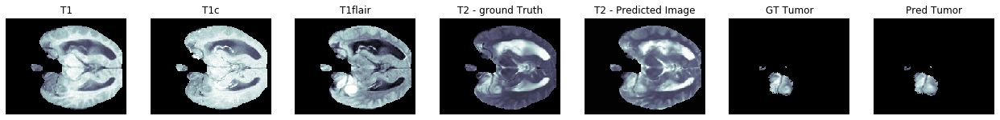

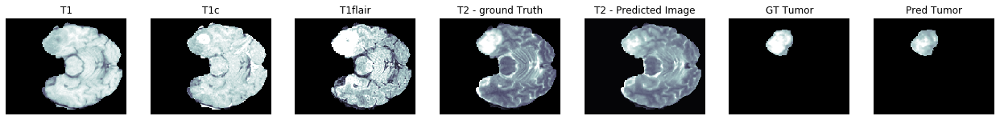

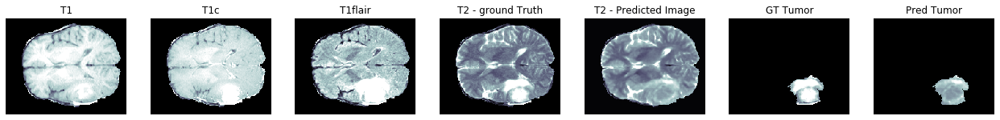

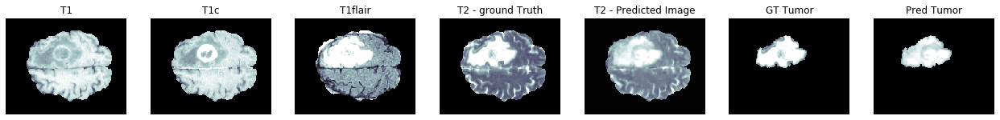

PSNR on validation set: 23.0744 ± 3.5512
MSE on validation set: 0.0062 ± 0.0039
SSIM on validation set: 0.8197 ± 0.0939

PSNR wrt tumor area on validation set: 33.7576 ± 11.6752
MSE wrt tumor area on validation set: 0.0012 ± 0.0013
SSIM wrt tumor area on validation set: 0.9713 ± 0.0257

Generator loss on validation set: 2.3906 ± 0.8120
Discriminator loss on validation set: 1.3868 ± 0.0039

Time taken for epoch 71 is 438.6356647014618 sec


Epoch:  72
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
.....................

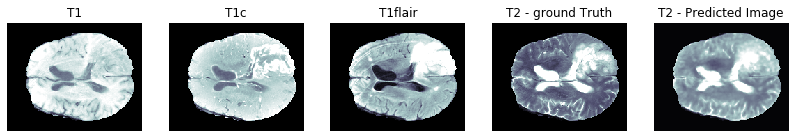

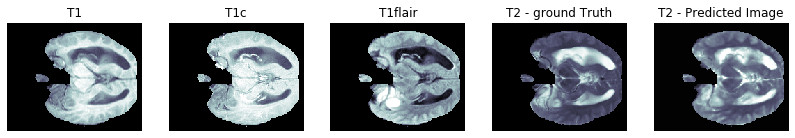

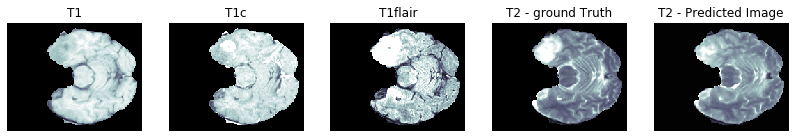

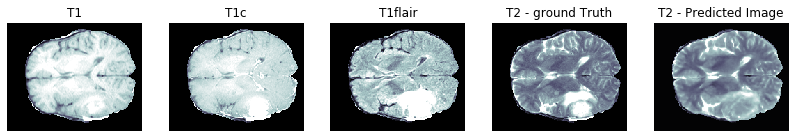

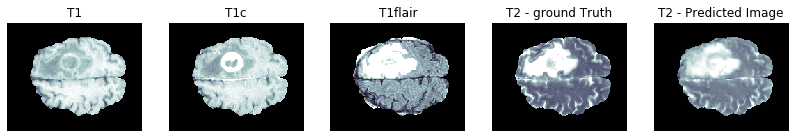

PSNR on validation set: 23.0903 ± 3.5477
MSE on validation set: 0.0062 ± 0.0039
SSIM on validation set: 0.8202 ± 0.0938

PSNR wrt tumor area on validation set: 33.8426 ± 11.8417
MSE wrt tumor area on validation set: 0.0012 ± 0.0013
SSIM wrt tumor area on validation set: 0.9715 ± 0.0255

Generator loss on validation set: 2.4085 ± 0.8117
Discriminator loss on validation set: 1.3893 ± 0.0041

Time taken for epoch 72 is 437.83007764816284 sec


Epoch:  73
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
....................

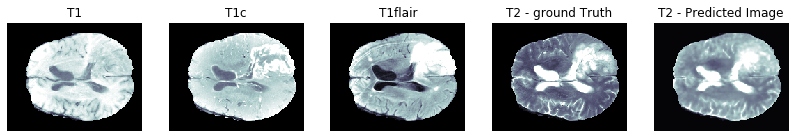

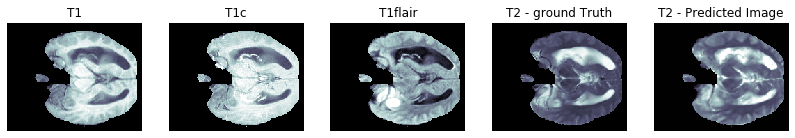

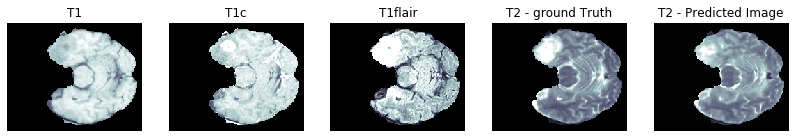

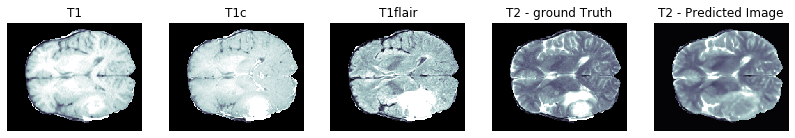

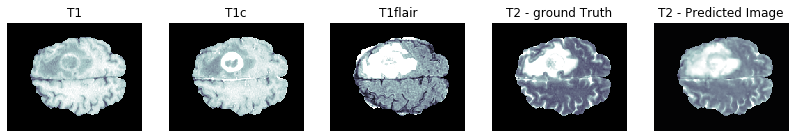

PSNR on validation set: 23.0831 ± 3.5561
MSE on validation set: 0.0062 ± 0.0039
SSIM on validation set: 0.8206 ± 0.0938

PSNR wrt tumor area on validation set: 33.8364 ± 12.2470
MSE wrt tumor area on validation set: 0.0012 ± 0.0014
SSIM wrt tumor area on validation set: 0.9713 ± 0.0258

Generator loss on validation set: 2.3897 ± 0.8178
Discriminator loss on validation set: 1.3818 ± 0.0079

Time taken for epoch 73 is 437.65284276008606 sec


Epoch:  74
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
....................

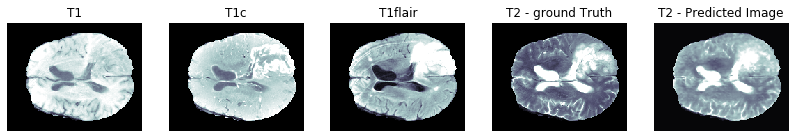

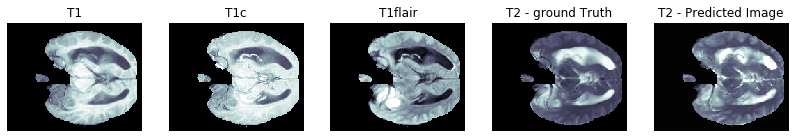

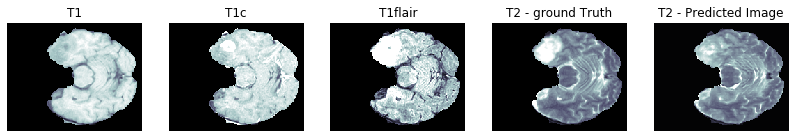

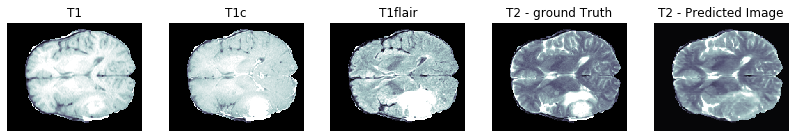

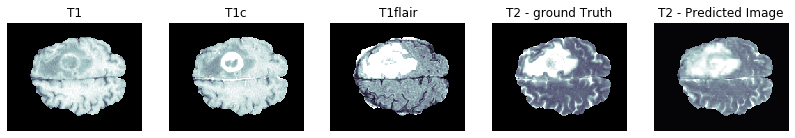

PSNR on validation set: 22.9419 ± 3.6086
MSE on validation set: 0.0064 ± 0.0041
SSIM on validation set: 0.8117 ± 0.0966

PSNR wrt tumor area on validation set: 33.6234 ± 12.2104
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9697 ± 0.0270

Generator loss on validation set: 2.3580 ± 0.8462
Discriminator loss on validation set: 1.3954 ± 0.0294

Time taken for epoch 74 is 438.1688423156738 sec


Epoch:  75
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
.....................

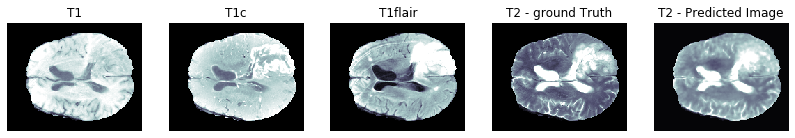

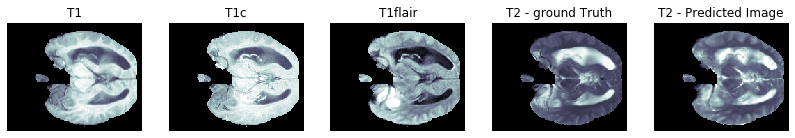

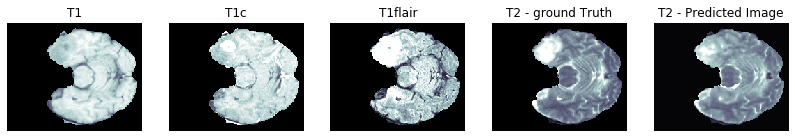

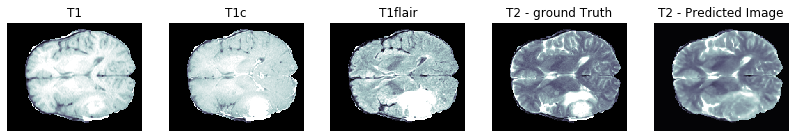

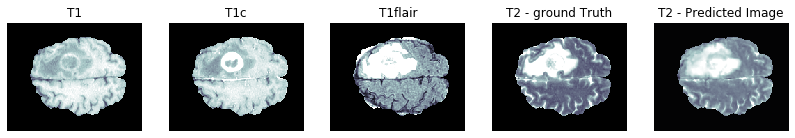

PSNR on validation set: 23.0668 ± 3.5715
MSE on validation set: 0.0062 ± 0.0040
SSIM on validation set: 0.8189 ± 0.0944

PSNR wrt tumor area on validation set: 33.8304 ± 12.2698
MSE wrt tumor area on validation set: 0.0012 ± 0.0014
SSIM wrt tumor area on validation set: 0.9710 ± 0.0259

Generator loss on validation set: 2.3911 ± 0.8217
Discriminator loss on validation set: 1.3837 ± 0.0119

Saving checkpoint for epoch 75 at ./drive/My Drive/checkpoints/train4/ckpt-16
Time taken for epoch 75 is 441.43545937538147 sec


Epoch:  76
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
...............................................

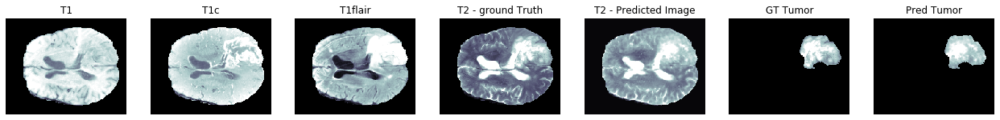

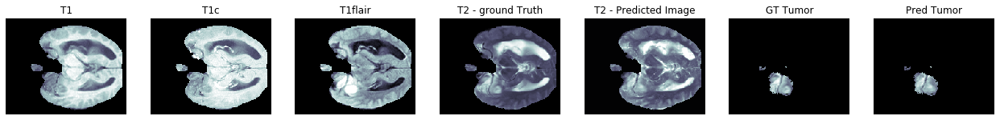

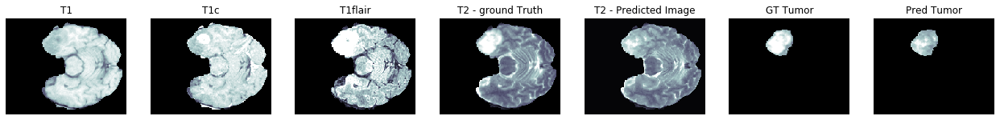

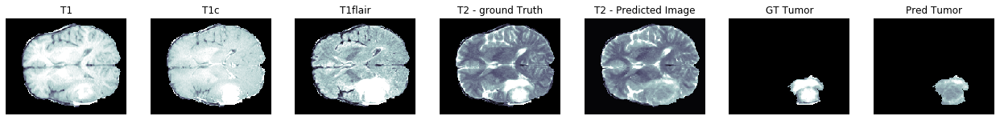

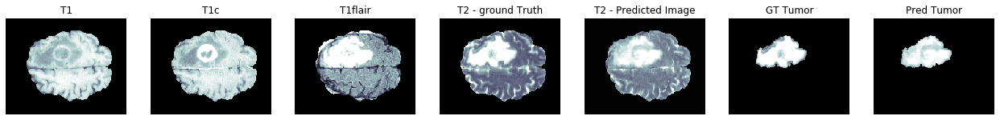

PSNR on validation set: 22.8911 ± 3.5814
MSE on validation set: 0.0065 ± 0.0040
SSIM on validation set: 0.8063 ± 0.0981

PSNR wrt tumor area on validation set: 33.5168 ± 11.2821
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9699 ± 0.0268

Generator loss on validation set: 2.3891 ± 0.8058
Discriminator loss on validation set: 1.3898 ± 0.0236

Time taken for epoch 76 is 437.7840292453766 sec


Epoch:  77
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
.....................

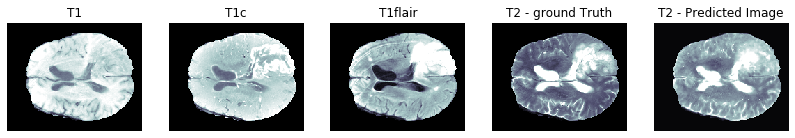

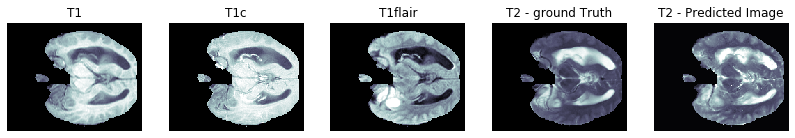

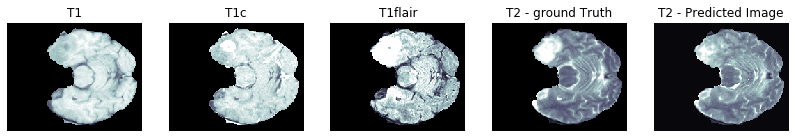

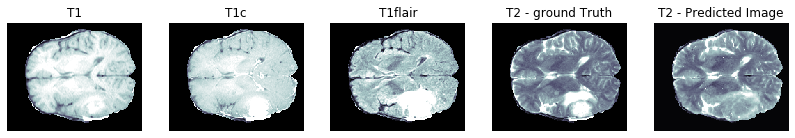

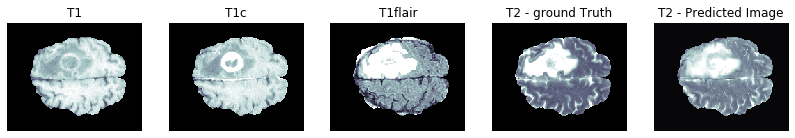

PSNR on validation set: 22.7929 ± 3.5759
MSE on validation set: 0.0066 ± 0.0040
SSIM on validation set: 0.8006 ± 0.1002

PSNR wrt tumor area on validation set: 33.4677 ± 11.2280
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9699 ± 0.0265

Generator loss on validation set: 2.3943 ± 0.8149
Discriminator loss on validation set: 1.3957 ± 0.0283

Time taken for epoch 77 is 437.44864559173584 sec


Epoch:  78
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
....................

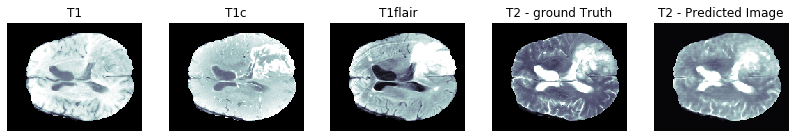

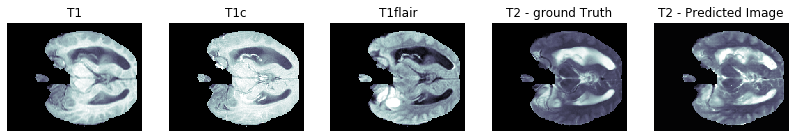

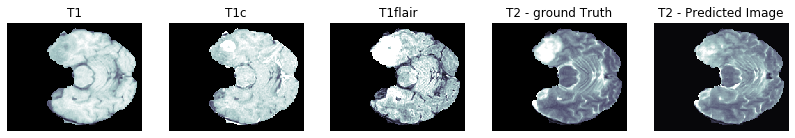

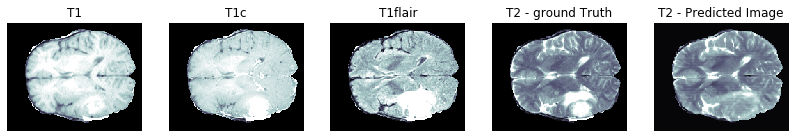

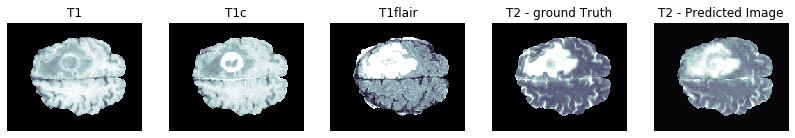

PSNR on validation set: 22.9494 ± 3.5738
MSE on validation set: 0.0064 ± 0.0041
SSIM on validation set: 0.8105 ± 0.0970

PSNR wrt tumor area on validation set: 33.5912 ± 11.3401
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9700 ± 0.0268

Generator loss on validation set: 2.4333 ± 0.8476
Discriminator loss on validation set: 1.3743 ± 0.0286

Time taken for epoch 78 is 437.0979356765747 sec


Epoch:  79
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
.....................

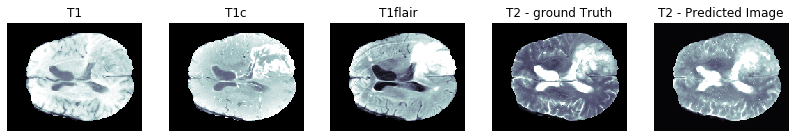

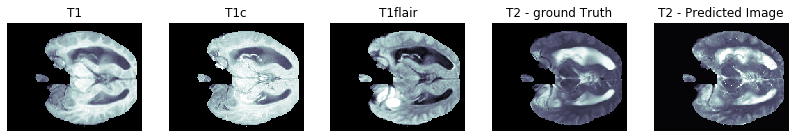

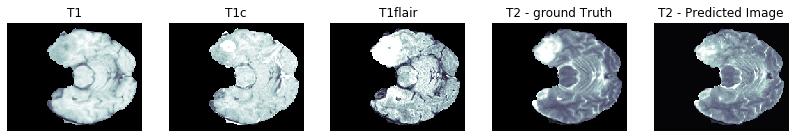

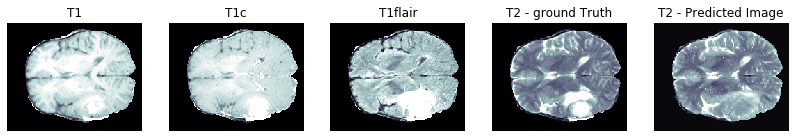

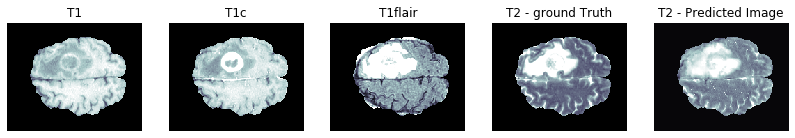

PSNR on validation set: 22.7569 ± 3.6238
MSE on validation set: 0.0066 ± 0.0041
SSIM on validation set: 0.7943 ± 0.1019

PSNR wrt tumor area on validation set: 33.4151 ± 11.7971
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9689 ± 0.0275

Generator loss on validation set: 2.4393 ± 0.8146
Discriminator loss on validation set: 1.4068 ± 0.0390

Time taken for epoch 79 is 437.3887689113617 sec


Epoch:  80
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
.....................

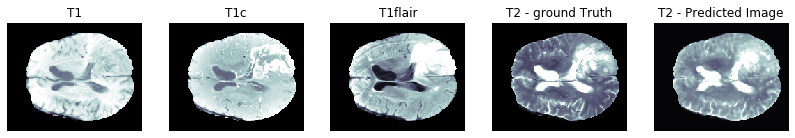

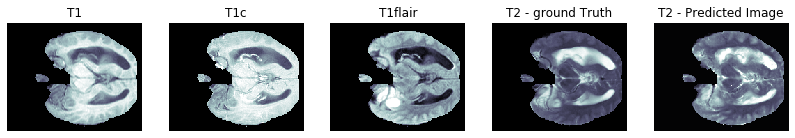

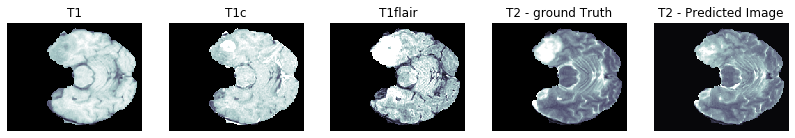

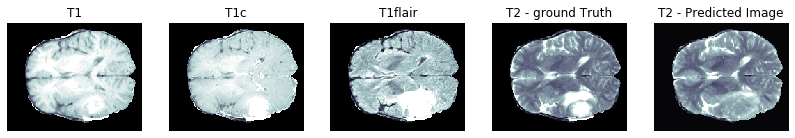

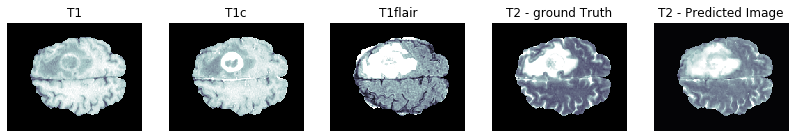

PSNR on validation set: 22.8776 ± 3.5852
MSE on validation set: 0.0065 ± 0.0040
SSIM on validation set: 0.8072 ± 0.0969

PSNR wrt tumor area on validation set: 33.4804 ± 11.1744
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9698 ± 0.0265

Generator loss on validation set: 2.4133 ± 0.8113
Discriminator loss on validation set: 1.3817 ± 0.0455

Saving checkpoint for epoch 80 at ./drive/My Drive/checkpoints/train4/ckpt-17
Time taken for epoch 80 is 440.4273693561554 sec


Epoch:  81
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
................................................

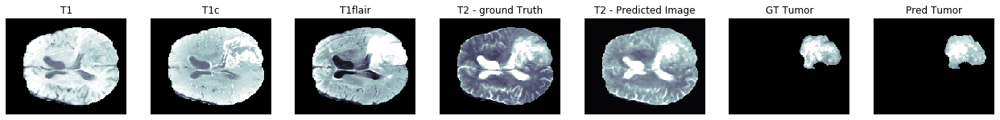

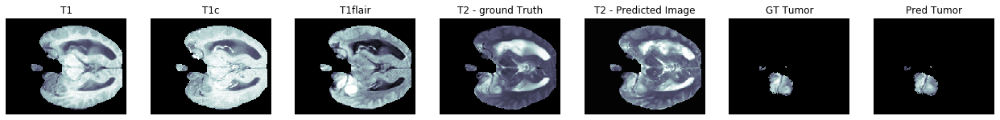

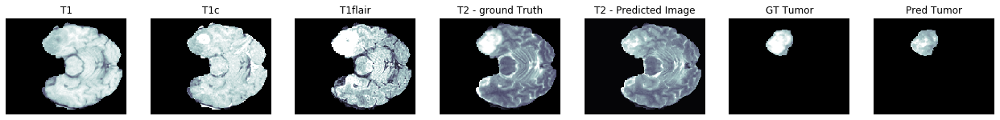

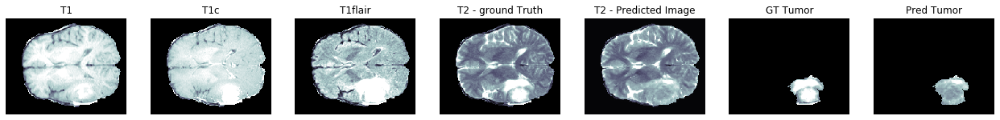

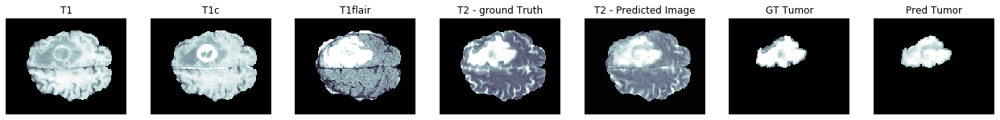

PSNR on validation set: 22.8615 ± 3.5207
MSE on validation set: 0.0065 ± 0.0041
SSIM on validation set: 0.8060 ± 0.0976

PSNR wrt tumor area on validation set: 33.5889 ± 11.8090
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9700 ± 0.0265

Generator loss on validation set: 2.4960 ± 0.8126
Discriminator loss on validation set: 1.3726 ± 0.0510

Time taken for epoch 81 is 437.5653190612793 sec


Epoch:  82
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
.....................

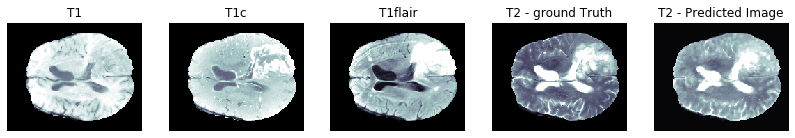

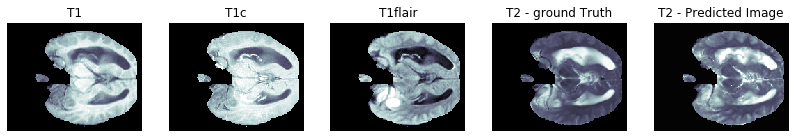

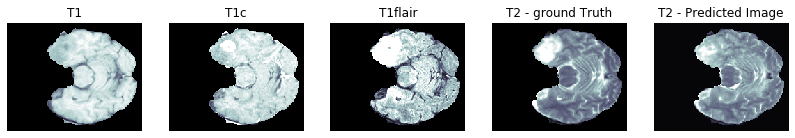

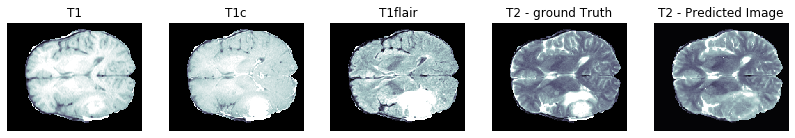

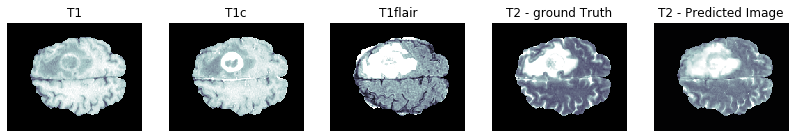

PSNR on validation set: 22.8792 ± 3.5108
MSE on validation set: 0.0065 ± 0.0040
SSIM on validation set: 0.8074 ± 0.0977

PSNR wrt tumor area on validation set: 33.5553 ± 11.3029
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9702 ± 0.0264

Generator loss on validation set: 2.4231 ± 0.8053
Discriminator loss on validation set: 1.3776 ± 0.0351

Time taken for epoch 82 is 436.90393471717834 sec


Epoch:  83
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
....................

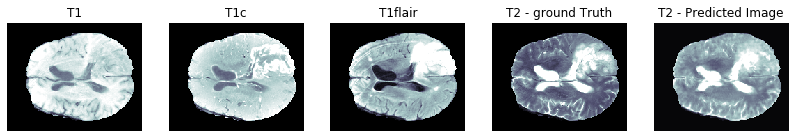

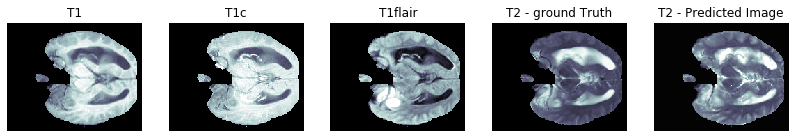

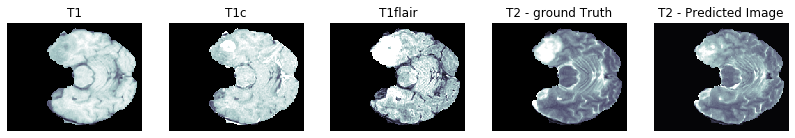

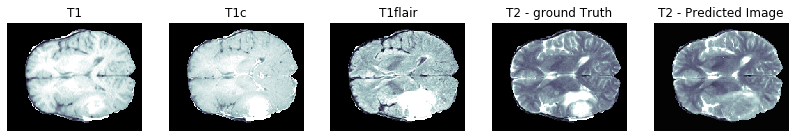

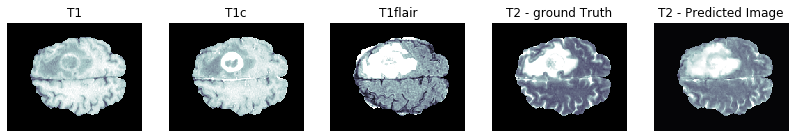

PSNR on validation set: 22.8530 ± 3.4952
MSE on validation set: 0.0065 ± 0.0040
SSIM on validation set: 0.8072 ± 0.0974

PSNR wrt tumor area on validation set: 33.6001 ± 11.8471
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9699 ± 0.0267

Generator loss on validation set: 2.4656 ± 0.8090
Discriminator loss on validation set: 1.3740 ± 0.0394

Time taken for epoch 83 is 436.98969745635986 sec


Epoch:  84
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
....................

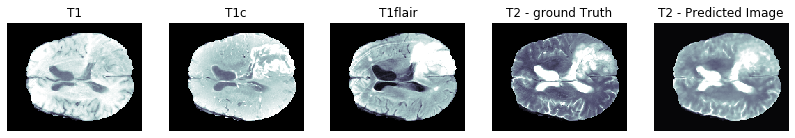

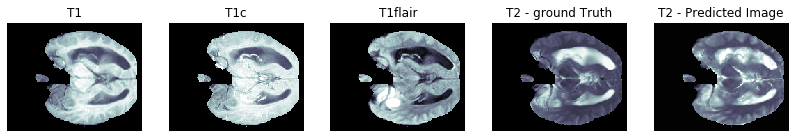

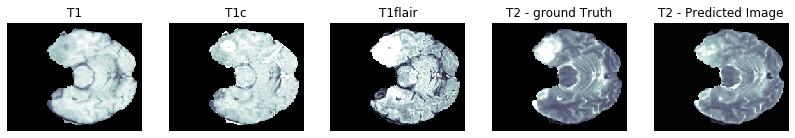

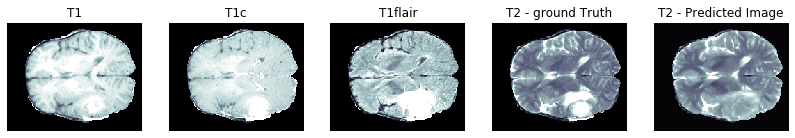

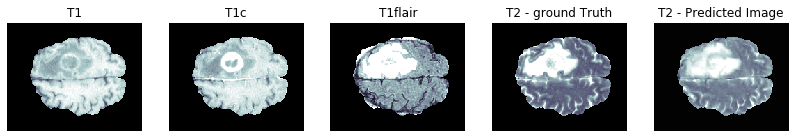

PSNR on validation set: 22.9615 ± 3.4979
MSE on validation set: 0.0063 ± 0.0040
SSIM on validation set: 0.8163 ± 0.0949

PSNR wrt tumor area on validation set: 33.7530 ± 11.9126
MSE wrt tumor area on validation set: 0.0012 ± 0.0014
SSIM wrt tumor area on validation set: 0.9708 ± 0.0260

Generator loss on validation set: 2.3896 ± 0.8387
Discriminator loss on validation set: 1.3799 ± 0.0231

Time taken for epoch 84 is 436.5084240436554 sec


Epoch:  85
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
.....................

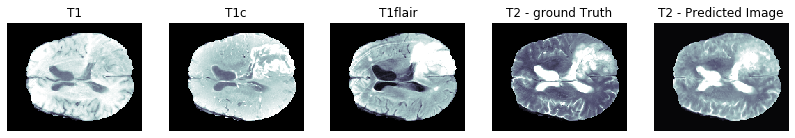

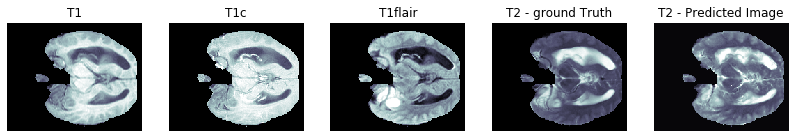

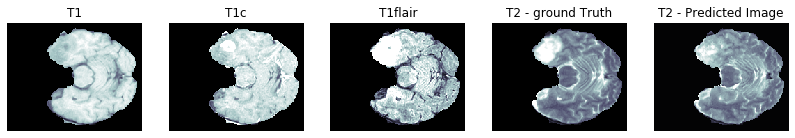

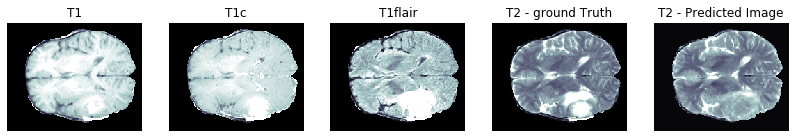

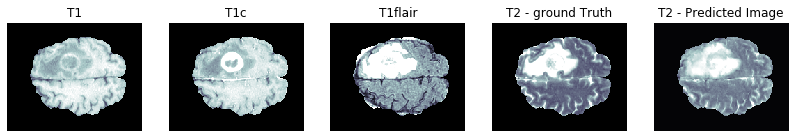

PSNR on validation set: 22.8482 ± 3.5429
MSE on validation set: 0.0065 ± 0.0041
SSIM on validation set: 0.8054 ± 0.0987

PSNR wrt tumor area on validation set: 33.4792 ± 11.6368
MSE wrt tumor area on validation set: 0.0013 ± 0.0015
SSIM wrt tumor area on validation set: 0.9692 ± 0.0277

Generator loss on validation set: 2.3741 ± 0.8180
Discriminator loss on validation set: 1.3955 ± 0.0155

Saving checkpoint for epoch 85 at ./drive/My Drive/checkpoints/train4/ckpt-18
Time taken for epoch 85 is 441.0364634990692 sec


Epoch:  86
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
................................................

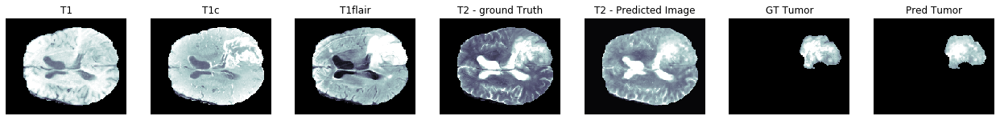

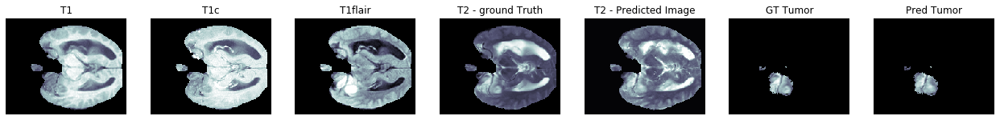

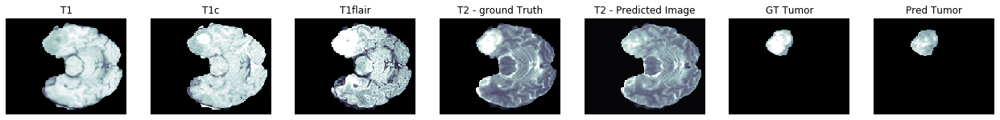

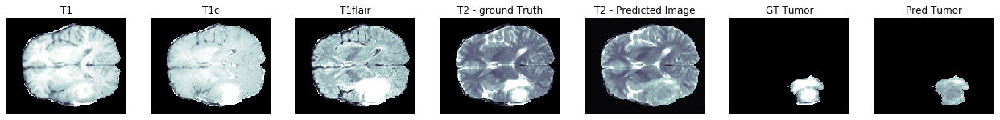

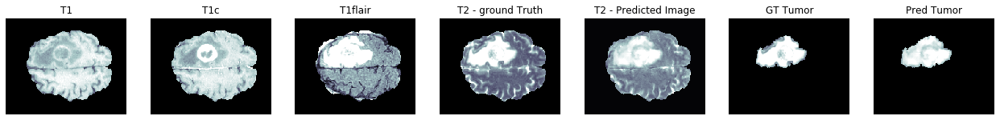

PSNR on validation set: 22.8597 ± 3.4913
MSE on validation set: 0.0065 ± 0.0040
SSIM on validation set: 0.8053 ± 0.0978

PSNR wrt tumor area on validation set: 33.5643 ± 11.1620
MSE wrt tumor area on validation set: 0.0012 ± 0.0014
SSIM wrt tumor area on validation set: 0.9704 ± 0.0261

Generator loss on validation set: 2.4123 ± 0.8067
Discriminator loss on validation set: 1.3785 ± 0.0291

Time taken for epoch 86 is 437.7826044559479 sec


Epoch:  87
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
.....................

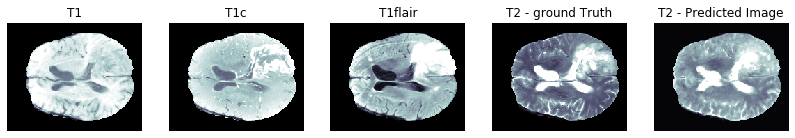

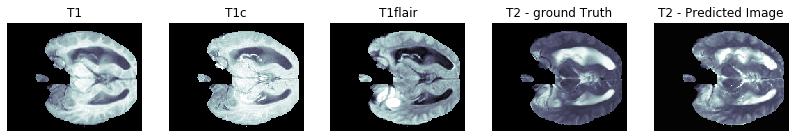

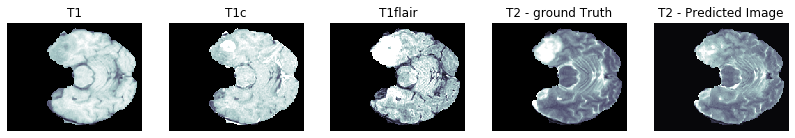

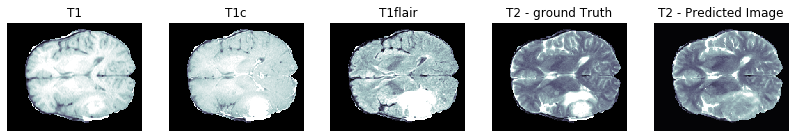

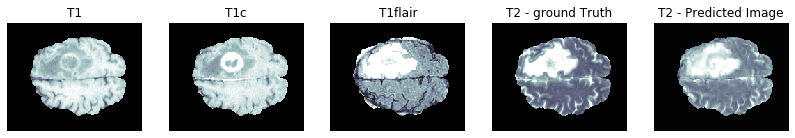

PSNR on validation set: 22.8547 ± 3.5067
MSE on validation set: 0.0065 ± 0.0040
SSIM on validation set: 0.8046 ± 0.0984

PSNR wrt tumor area on validation set: 33.6110 ± 12.0969
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9699 ± 0.0263

Generator loss on validation set: 2.4240 ± 0.8044
Discriminator loss on validation set: 1.3990 ± 0.0278

Time taken for epoch 87 is 437.3280436992645 sec


Epoch:  88
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
.....................

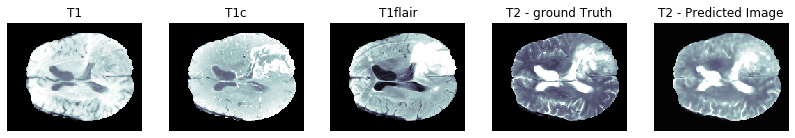

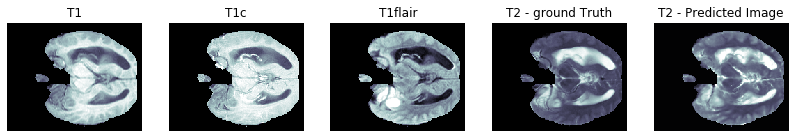

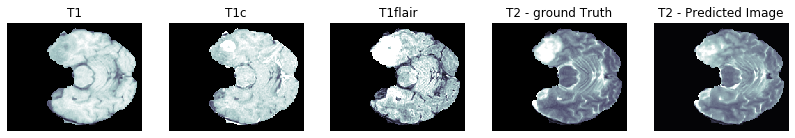

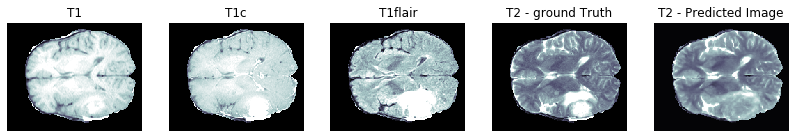

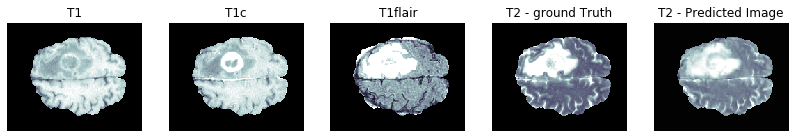

PSNR on validation set: 23.0164 ± 3.5364
MSE on validation set: 0.0063 ± 0.0040
SSIM on validation set: 0.8168 ± 0.0950

PSNR wrt tumor area on validation set: 33.6511 ± 10.8733
MSE wrt tumor area on validation set: 0.0012 ± 0.0014
SSIM wrt tumor area on validation set: 0.9711 ± 0.0258

Generator loss on validation set: 2.4308 ± 0.8392
Discriminator loss on validation set: 1.3730 ± 0.0202

Time taken for epoch 88 is 436.9431321620941 sec


Epoch:  89
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
.....................

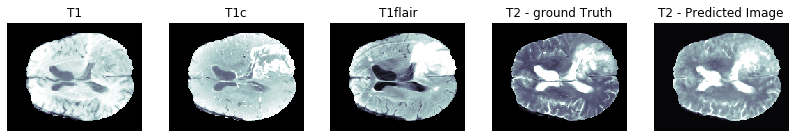

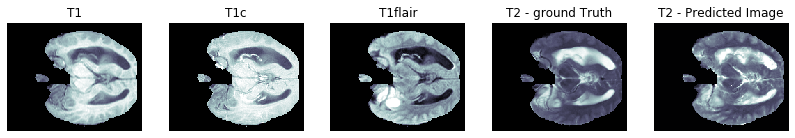

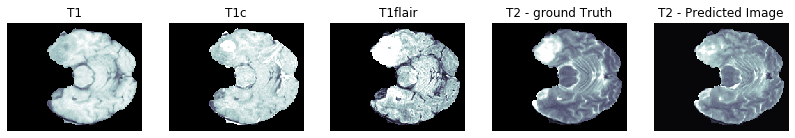

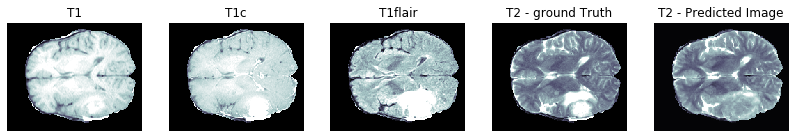

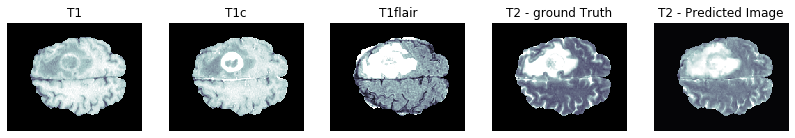

PSNR on validation set: 22.8622 ± 3.5137
MSE on validation set: 0.0065 ± 0.0041
SSIM on validation set: 0.8067 ± 0.0979

PSNR wrt tumor area on validation set: 33.5846 ± 11.6774
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9702 ± 0.0263

Generator loss on validation set: 2.4819 ± 0.8283
Discriminator loss on validation set: 1.3824 ± 0.0448

Time taken for epoch 89 is 436.95966720581055 sec


Epoch:  90
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
....................

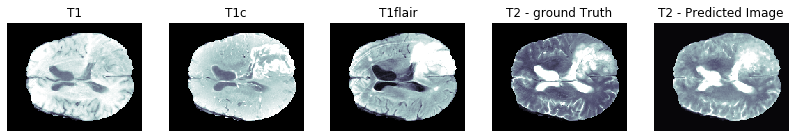

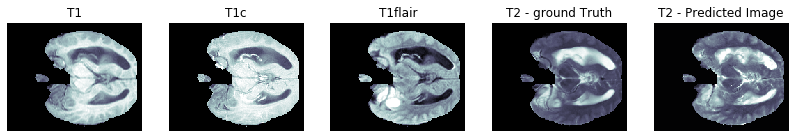

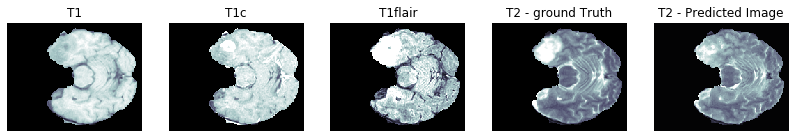

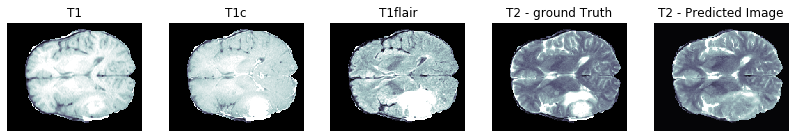

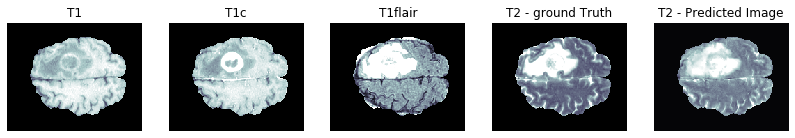

PSNR on validation set: 22.8543 ± 3.4984
MSE on validation set: 0.0065 ± 0.0040
SSIM on validation set: 0.8046 ± 0.0982

PSNR wrt tumor area on validation set: 33.4958 ± 11.1796
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9700 ± 0.0264

Generator loss on validation set: 2.4283 ± 0.8095
Discriminator loss on validation set: 1.3851 ± 0.0424

Saving checkpoint for epoch 90 at ./drive/My Drive/checkpoints/train4/ckpt-19
Time taken for epoch 90 is 439.7595360279083 sec


Epoch:  91
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
................................................

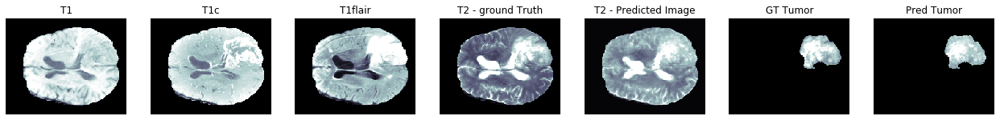

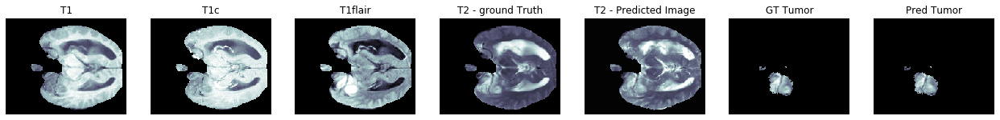

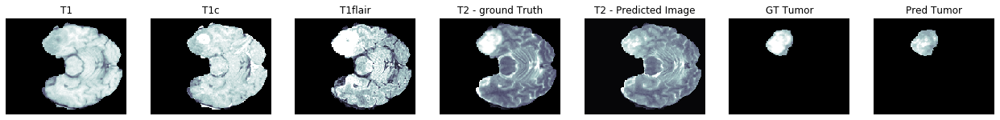

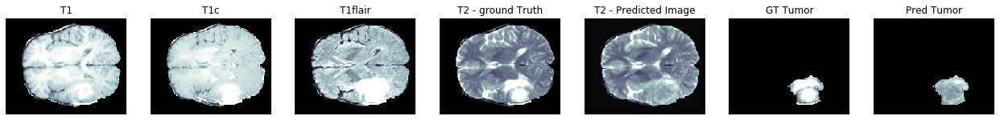

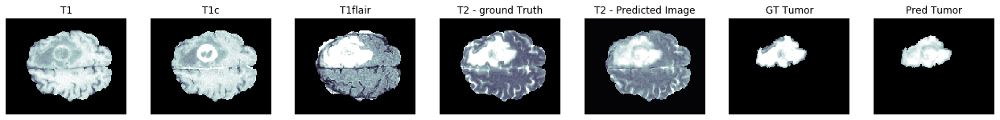

PSNR on validation set: 22.8564 ± 3.5016
MSE on validation set: 0.0065 ± 0.0041
SSIM on validation set: 0.8045 ± 0.0981

PSNR wrt tumor area on validation set: 33.6138 ± 12.1818
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9698 ± 0.0266

Generator loss on validation set: 2.4726 ± 0.8177
Discriminator loss on validation set: 1.3989 ± 0.0435

Time taken for epoch 91 is 437.35689306259155 sec


Epoch:  92
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
....................

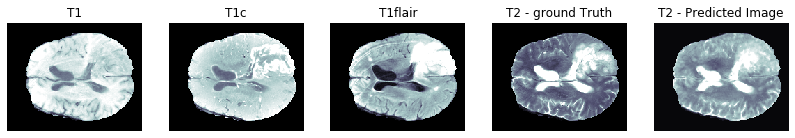

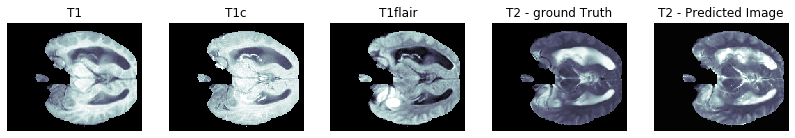

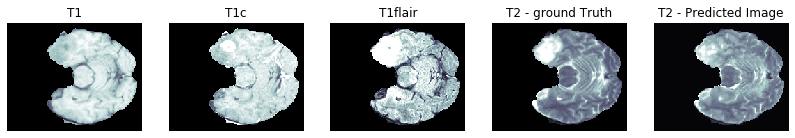

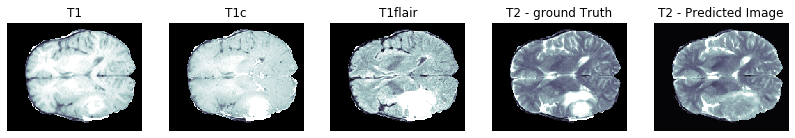

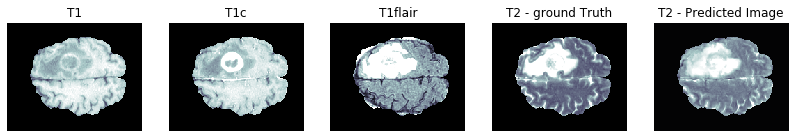

PSNR on validation set: 22.8619 ± 3.4687
MSE on validation set: 0.0065 ± 0.0040
SSIM on validation set: 0.8071 ± 0.0974

PSNR wrt tumor area on validation set: 33.6014 ± 11.5594
MSE wrt tumor area on validation set: 0.0012 ± 0.0014
SSIM wrt tumor area on validation set: 0.9702 ± 0.0263

Generator loss on validation set: 2.5044 ± 0.8009
Discriminator loss on validation set: 1.4014 ± 0.0427

Time taken for epoch 92 is 437.1237711906433 sec


Epoch:  93
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
.....................

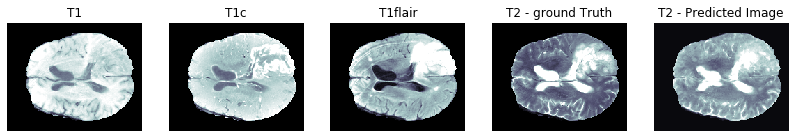

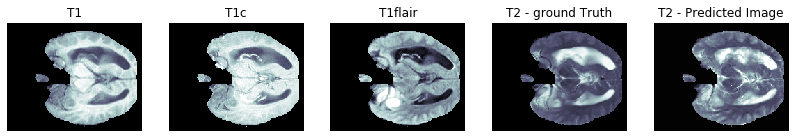

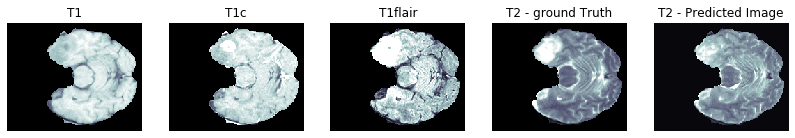

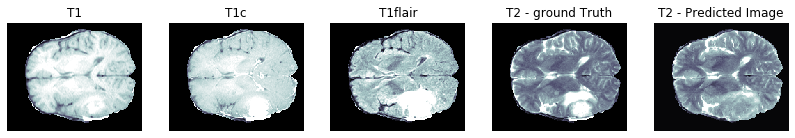

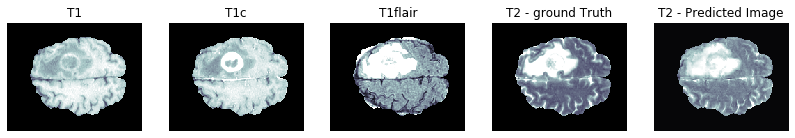

PSNR on validation set: 22.8080 ± 3.4849
MSE on validation set: 0.0065 ± 0.0040
SSIM on validation set: 0.8006 ± 0.0996

PSNR wrt tumor area on validation set: 33.4827 ± 11.6099
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9695 ± 0.0266

Generator loss on validation set: 2.4377 ± 0.8051
Discriminator loss on validation set: 1.4084 ± 0.0394

Time taken for epoch 93 is 437.0322699546814 sec


Epoch:  94
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
.....................

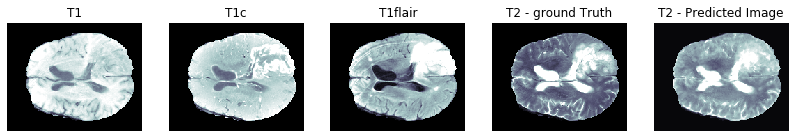

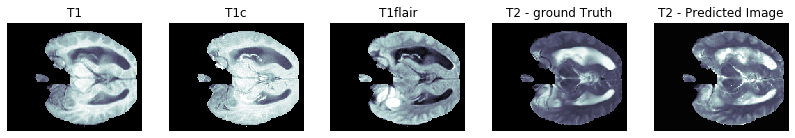

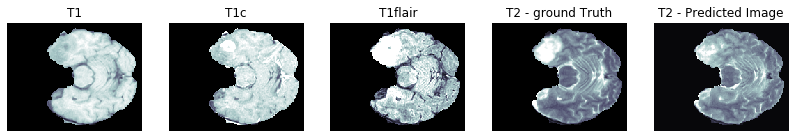

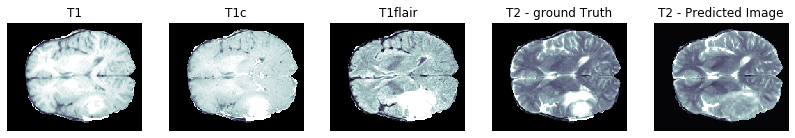

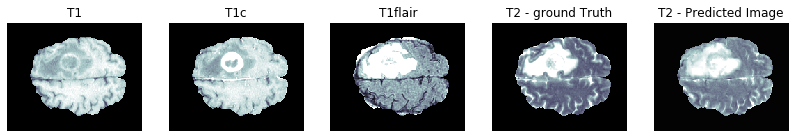

PSNR on validation set: 22.8451 ± 3.5109
MSE on validation set: 0.0065 ± 0.0041
SSIM on validation set: 0.8054 ± 0.0980

PSNR wrt tumor area on validation set: 33.4653 ± 11.2422
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9697 ± 0.0266

Generator loss on validation set: 2.4387 ± 0.8084
Discriminator loss on validation set: 1.3832 ± 0.0336

Time taken for epoch 94 is 436.6154146194458 sec


Epoch:  95
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
.....................

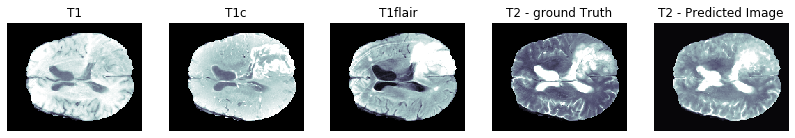

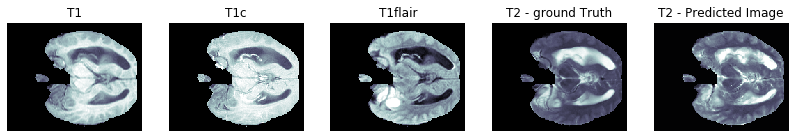

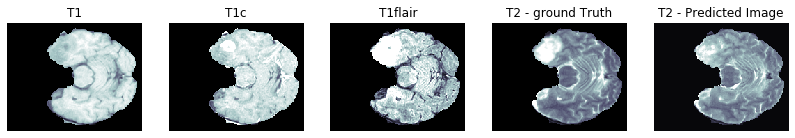

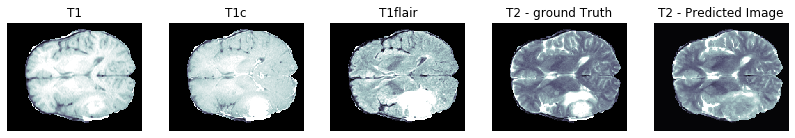

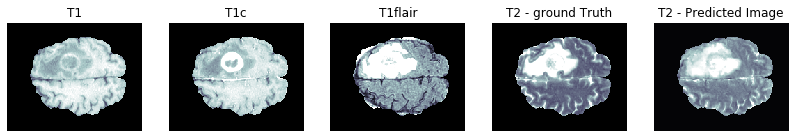

PSNR on validation set: 22.8398 ± 3.4984
MSE on validation set: 0.0065 ± 0.0040
SSIM on validation set: 0.8055 ± 0.0982

PSNR wrt tumor area on validation set: 33.5575 ± 11.7893
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9700 ± 0.0263

Generator loss on validation set: 2.4487 ± 0.8076
Discriminator loss on validation set: 1.3825 ± 0.0455

Saving checkpoint for epoch 95 at ./drive/My Drive/checkpoints/train4/ckpt-20
Time taken for epoch 95 is 439.7242958545685 sec


Epoch:  96
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
................................................

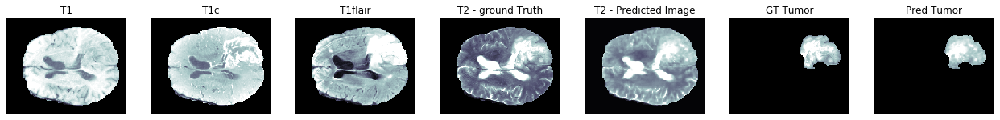

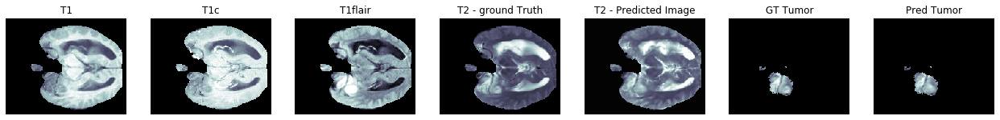

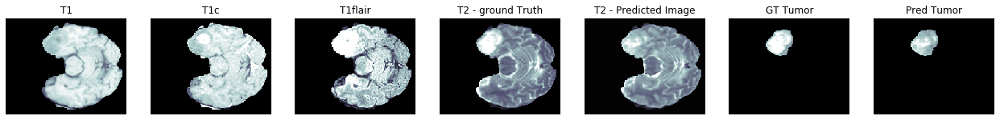

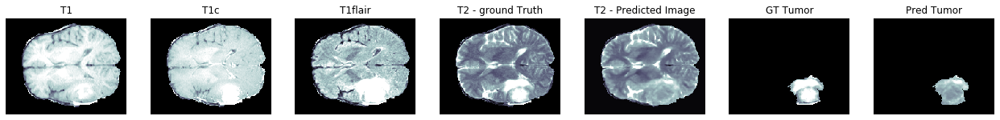

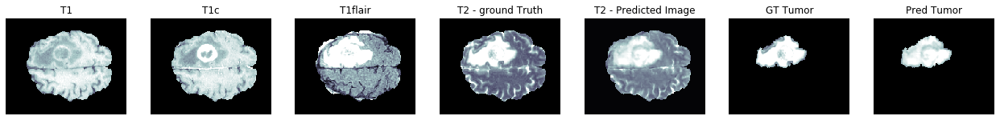

PSNR on validation set: 22.9978 ± 3.5304
MSE on validation set: 0.0063 ± 0.0041
SSIM on validation set: 0.8156 ± 0.0950

PSNR wrt tumor area on validation set: 33.4956 ± 10.2075
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9706 ± 0.0264

Generator loss on validation set: 2.4475 ± 0.8306
Discriminator loss on validation set: 1.3801 ± 0.0124

Time taken for epoch 96 is 437.187287569046 sec


Epoch:  97
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
......................

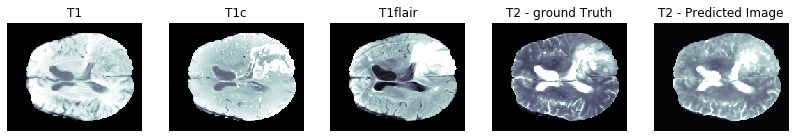

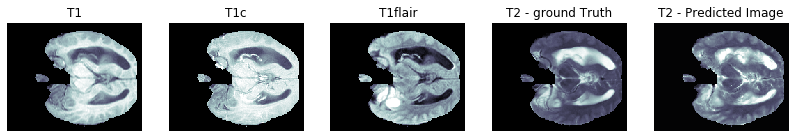

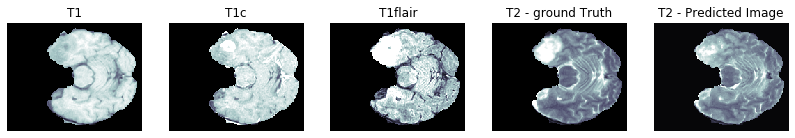

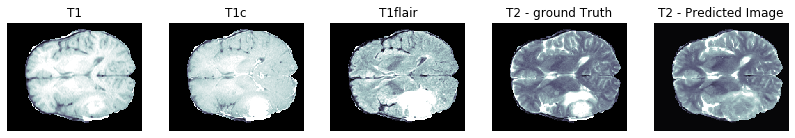

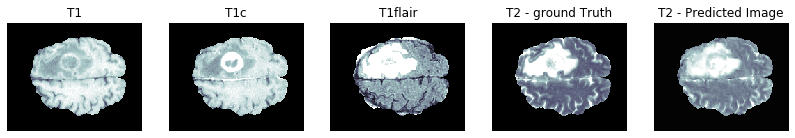

PSNR on validation set: 22.8783 ± 3.5278
MSE on validation set: 0.0065 ± 0.0041
SSIM on validation set: 0.8072 ± 0.0977

PSNR wrt tumor area on validation set: 33.5500 ± 11.5098
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9698 ± 0.0269

Generator loss on validation set: 2.4682 ± 0.8105
Discriminator loss on validation set: 1.3792 ± 0.0325

Time taken for epoch 97 is 437.2767562866211 sec


Epoch:  98
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
.....................

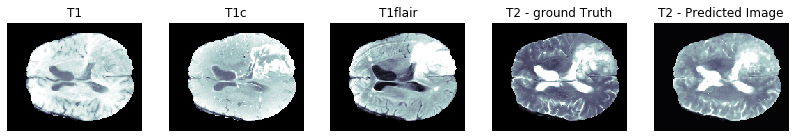

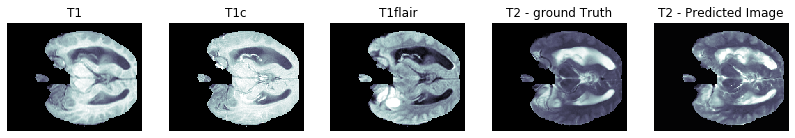

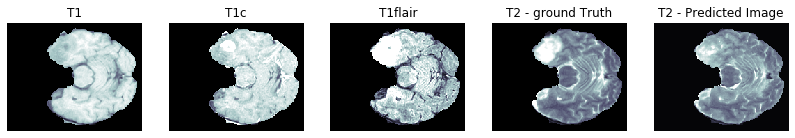

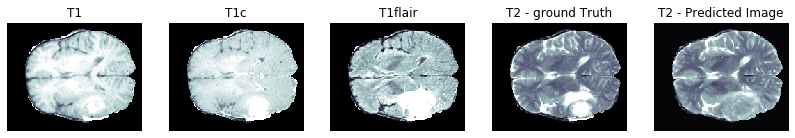

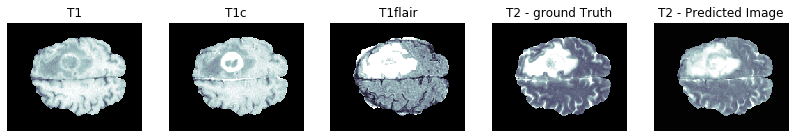

PSNR on validation set: 22.9130 ± 3.5064
MSE on validation set: 0.0064 ± 0.0040
SSIM on validation set: 0.8080 ± 0.0974

PSNR wrt tumor area on validation set: 33.4150 ± 10.6169
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9699 ± 0.0266

Generator loss on validation set: 2.4000 ± 0.8336
Discriminator loss on validation set: 1.3844 ± 0.0325

Time taken for epoch 98 is 436.58783769607544 sec


Epoch:  99
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
....................

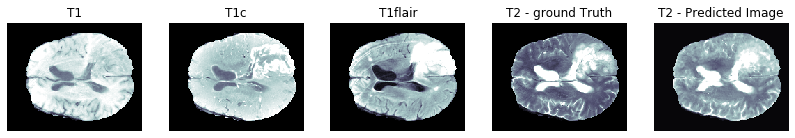

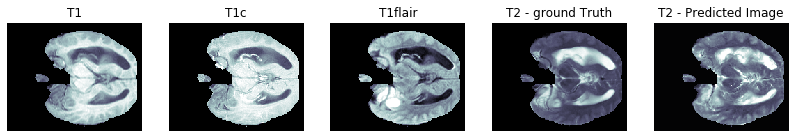

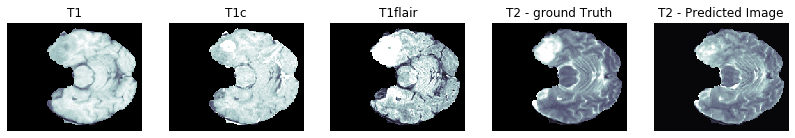

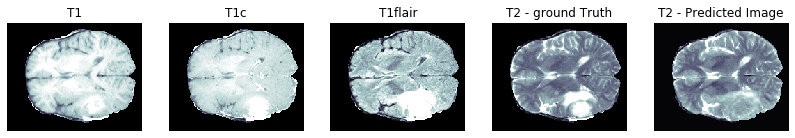

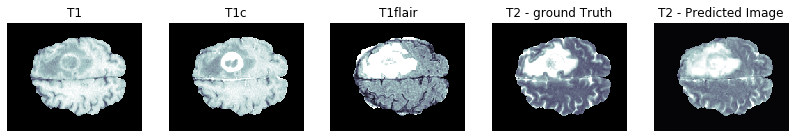

PSNR on validation set: 22.8265 ± 3.5032
MSE on validation set: 0.0065 ± 0.0040
SSIM on validation set: 0.8032 ± 0.0989

PSNR wrt tumor area on validation set: 33.5152 ± 11.3472
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9698 ± 0.0266

Generator loss on validation set: 2.4428 ± 0.8275
Discriminator loss on validation set: 1.3890 ± 0.0418

Time taken for epoch 99 is 436.5813047885895 sec


Epoch:  100
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
....................

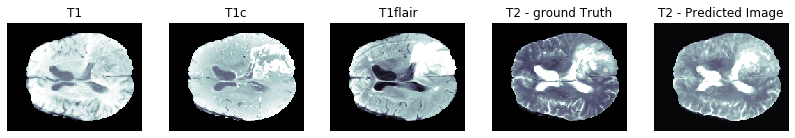

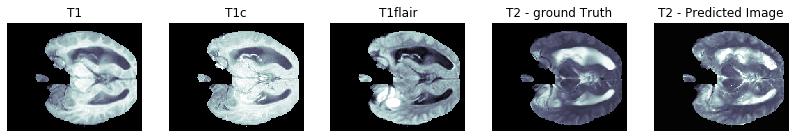

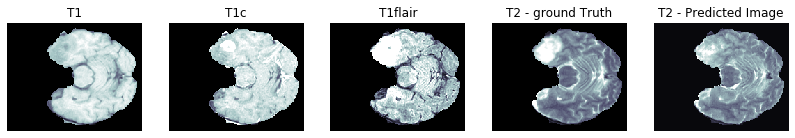

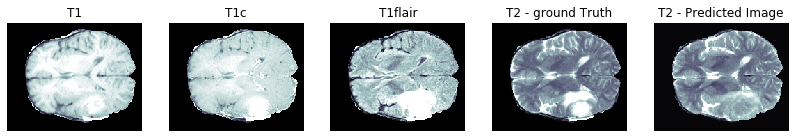

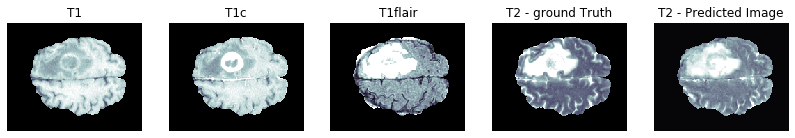

PSNR on validation set: 22.7843 ± 3.5128
MSE on validation set: 0.0066 ± 0.0041
SSIM on validation set: 0.8017 ± 0.0993

PSNR wrt tumor area on validation set: 33.3946 ± 11.1425
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9695 ± 0.0269

Generator loss on validation set: 2.4159 ± 0.7972
Discriminator loss on validation set: 1.4006 ± 0.0426

Saving checkpoint for epoch 100 at ./drive/My Drive/checkpoints/train4/ckpt-21
Time taken for epoch 100 is 440.6300139427185 sec


Epoch:  101
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
.............................................

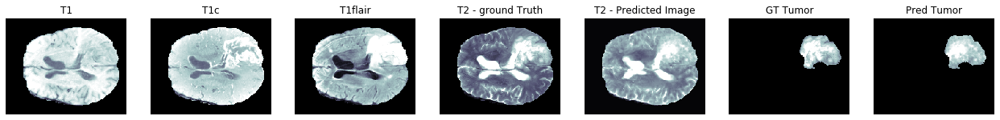

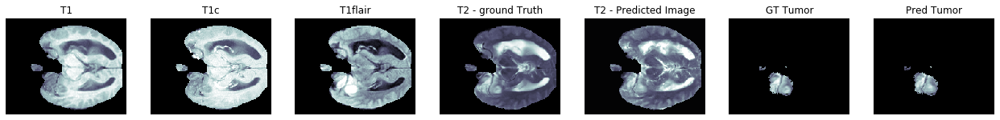

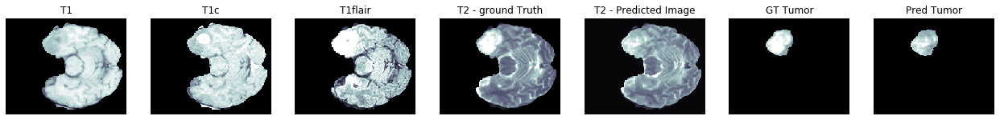

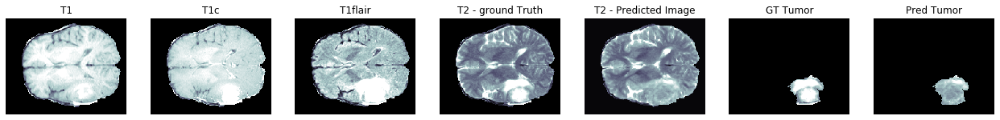

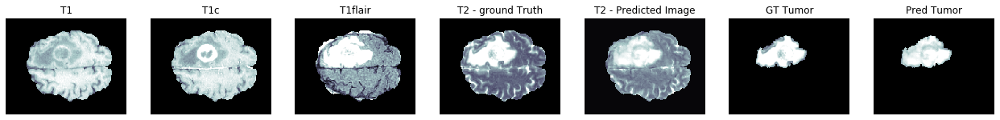

PSNR on validation set: 22.8497 ± 3.4791
MSE on validation set: 0.0065 ± 0.0041
SSIM on validation set: 0.8055 ± 0.0977

PSNR wrt tumor area on validation set: 33.6212 ± 11.8795
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9700 ± 0.0264

Generator loss on validation set: 2.4502 ± 0.8130
Discriminator loss on validation set: 1.3783 ± 0.0321

Time taken for epoch 101 is 437.7227370738983 sec


Epoch:  102
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
...................

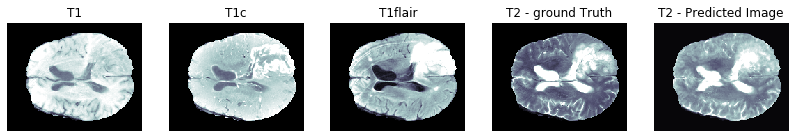

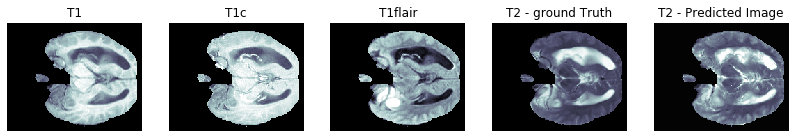

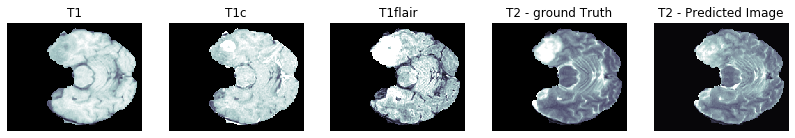

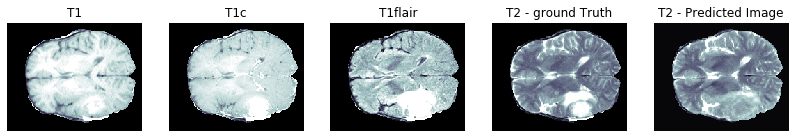

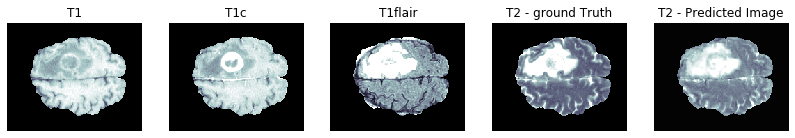

PSNR on validation set: 22.8293 ± 3.4942
MSE on validation set: 0.0065 ± 0.0040
SSIM on validation set: 0.8035 ± 0.0985

PSNR wrt tumor area on validation set: 33.5694 ± 11.4713
MSE wrt tumor area on validation set: 0.0012 ± 0.0014
SSIM wrt tumor area on validation set: 0.9700 ± 0.0263

Generator loss on validation set: 2.4543 ± 0.8143
Discriminator loss on validation set: 1.3820 ± 0.0442

Time taken for epoch 102 is 438.09398651123047 sec


Epoch:  103
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
..................

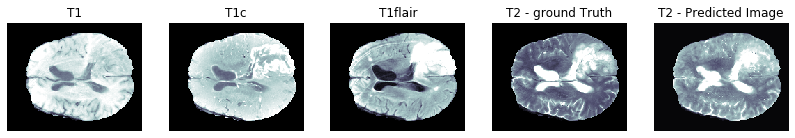

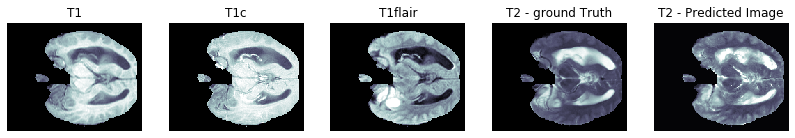

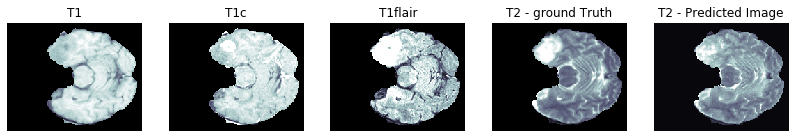

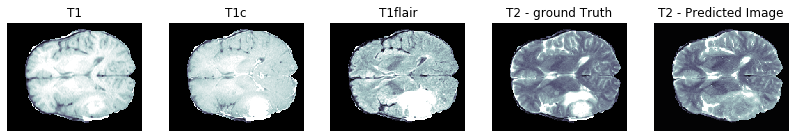

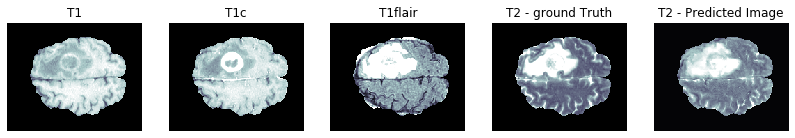

PSNR on validation set: 22.7976 ± 3.5087
MSE on validation set: 0.0066 ± 0.0041
SSIM on validation set: 0.7986 ± 0.1005

PSNR wrt tumor area on validation set: 33.4568 ± 12.1973
MSE wrt tumor area on validation set: 0.0013 ± 0.0015
SSIM wrt tumor area on validation set: 0.9688 ± 0.0275

Generator loss on validation set: 2.4462 ± 0.8298
Discriminator loss on validation set: 1.4137 ± 0.0484

Time taken for epoch 103 is 437.567941904068 sec


Epoch:  104
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
....................

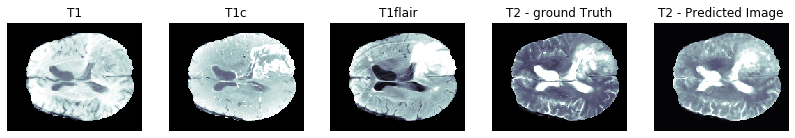

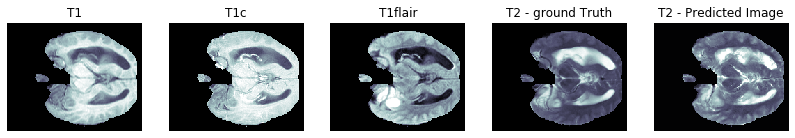

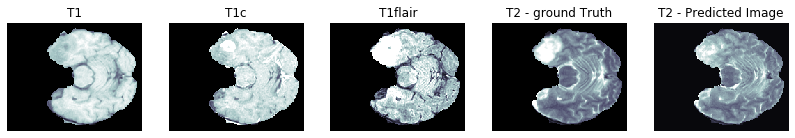

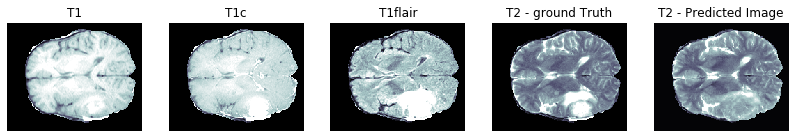

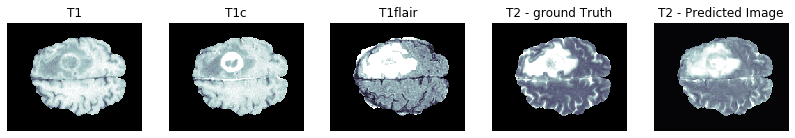

PSNR on validation set: 22.8513 ± 3.5183
MSE on validation set: 0.0065 ± 0.0041
SSIM on validation set: 0.8045 ± 0.0984

PSNR wrt tumor area on validation set: 33.4883 ± 11.3441
MSE wrt tumor area on validation set: 0.0013 ± 0.0014
SSIM wrt tumor area on validation set: 0.9696 ± 0.0269

Generator loss on validation set: 2.4535 ± 0.8073
Discriminator loss on validation set: 1.3949 ± 0.0375

Time taken for epoch 104 is 437.54143619537354 sec


Epoch:  105
...................................................................................................
100
....................................................................................................
200
....................................................................................................
300
....................................................................................................
400
....................................................................................................
500
..................

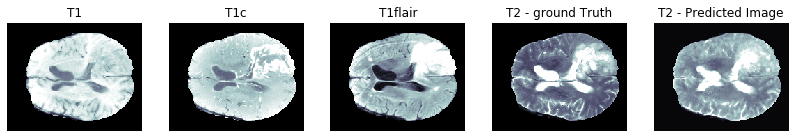

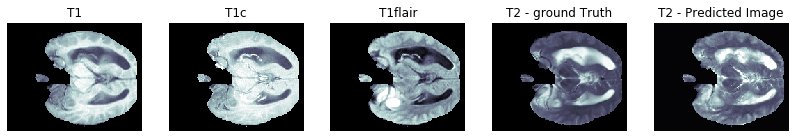

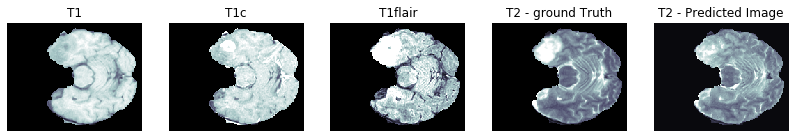

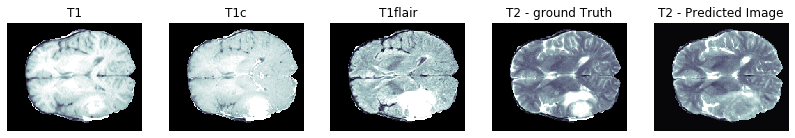

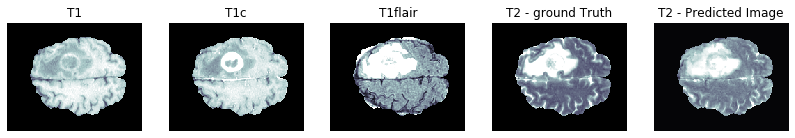

PSNR on validation set: 22.8204 ± 3.4806
MSE on validation set: 0.0065 ± 0.0040
SSIM on validation set: 0.8024 ± 0.0989

PSNR wrt tumor area on validation set: 33.5829 ± 11.4525
MSE wrt tumor area on validation set: 0.0012 ± 0.0014
SSIM wrt tumor area on validation set: 0.9700 ± 0.0262

Generator loss on validation set: 2.5610 ± 0.8318
Discriminator loss on validation set: 1.4599 ± 0.0443

Saving checkpoint for epoch 105 at ./drive/My Drive/checkpoints/train4/ckpt-22
Time taken for epoch 105 is 440.4210057258606 sec

Saving FINAL checkpoint for epoch 105 at ./drive/My Drive/checkpoints/train4/ckpt-23


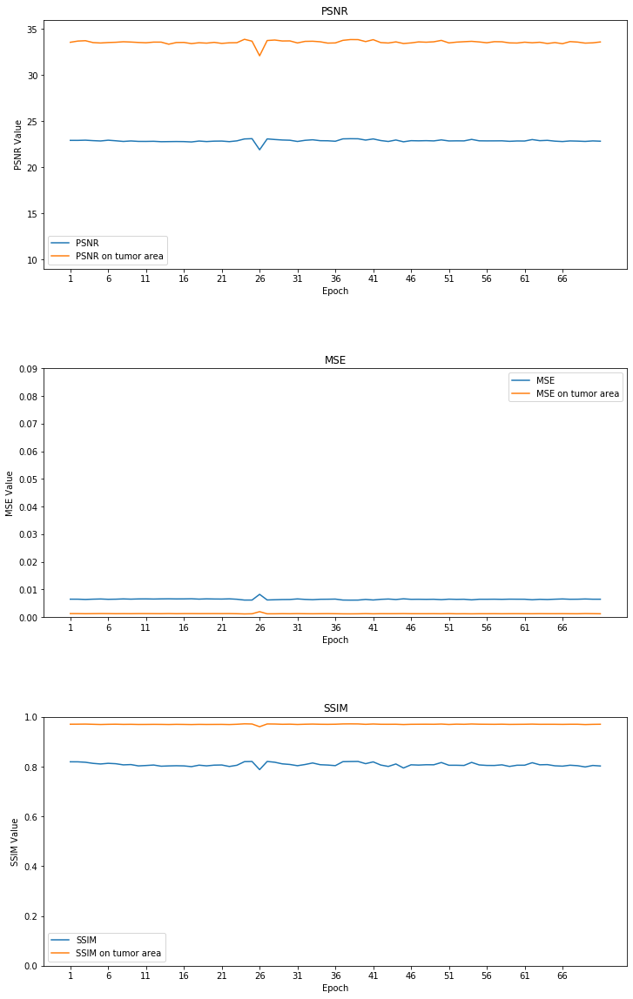

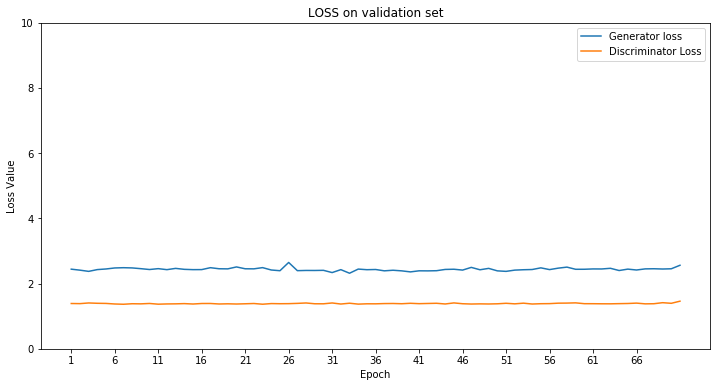

In [51]:
EPOCHS = 70
save_checkpoint = True         # want to save new checkpoints ? 
save_final_models = True       # want to save the model at the end of the training ? 
epochs_already_trained = 35      # this is just for the print. 
evaluate_tumor_quality = True   # compute & print metrics on tumor area ?
print_loss = True               # compute & print the validation loss ?


# Initialize the models, so that I don't have to restart the runtime again.

if tf.equal(evaluate_tumor_quality, True) and tf.equal(print_loss, False):
    psnr, mse, ssim, psnr_tumor, mse_tumor, ssim_tumor = fit(training, EPOCHS, validation, save_checkpoint, 
                                                    epochs_already_trained, evaluate_tumor_quality, print_loss)
    plot_metrics(psnr, mse, ssim, psnr_tumor, mse_tumor, ssim_tumor)

elif tf.equal(evaluate_tumor_quality, False) and tf.equal(print_loss, True):
    psnr, mse, ssim, gen_loss, dis_loss = fit(training, EPOCHS, validation, save_checkpoint, 
                                                    epochs_already_trained, evaluate_tumor_quality, print_loss)
    plot_metrics(psnr, mse, ssim)
    plot_loss(gen_loss, dis_loss)

elif tf.equal(evaluate_tumor_quality, True) and tf.equal(print_loss, True):
    psnr, mse, ssim, psnr_tumor, mse_tumor, ssim_tumor, gen_loss, dis_loss = fit(training, EPOCHS, validation, save_checkpoint, 
                                                        epochs_already_trained, evaluate_tumor_quality, print_loss)
    plot_metrics(psnr, mse, ssim, psnr_tumor, mse_tumor, ssim_tumor)
    plot_loss(gen_loss, dis_loss)
else:
    psnr, mse, ssim = fit(training, EPOCHS, validation, save_checkpoint, 
                                                      epochs_already_trained, evaluate_tumor_quality, print_loss)
    plot_metrics(psnr, mse, ssim)

# at the end, I'll save the models (I would need only the gen, but let's sayve also the disc  )
# (it saves the entire model to a HDF5 file)

if save_final_models:
    generator.save('drive/My Drive/MRI-generation/gen_t2_70_MI-GAN_v2.h5')

##Evaluating the final model with the test set

In [0]:
# Let's check the scores of this model.

evaluate_GAN(generator, testing, 'test', True, True)

## Considerations about metrics and normalization

In [0]:
training, validation, testing = load_datasets() # I'll use this in case I get stuck with the cache.

In [0]:
for raw_record in testing.take(1):
    inp, ground_truth = take_images_from_raw(raw_record)

    prediction = generator(inp, training=False)
    inp, ground_truth, prediction = resize_with_crop(inp, ground_truth, prediction)

    prediction_normalized = mean_normalize(prediction)
    ground_truth_normalized = mean_normalize(ground_truth) 

    #prediction_normalized2 = min_max_normalize(prediction)
    
    # remove black images from ground_truth is not that necessary because it's enough to do it on the predictions. 
    # Anyway, just to be sure, let's remove them also from the ground truth (so the metrics of those images will be ignored)

    # BLACK IMAGES ARE DISCARDED IN ALL THE METRICS COMPUTED. Both in the case where I normalize and in the one in which I don't.
    # What if, in the case in which I don't normalize, I keep the black images? We would have significant differences.
    # For example PSNR would be 27.0207 ± 10.2544 instead of  25.2498 ± 2.8603 (with the model trained)
    ground_truth = black_images_to_nan(ground_truth)
    prediction = black_images_to_nan(prediction)

    #mean, std, psnr = compute_psnr(ground_truth, prediction_normalized2)
    #print("PSNR w/ min-max norm: {} ± {}".format((f'{mean:.4f}'), (f'{std:.4f}')))
    mean, std, psnr = compute_psnr(ground_truth_normalized, prediction_normalized)
    print("PSNR w/ mean-norm: {} ± {}".format((f'{mean:.4f}'), (f'{std:.4f}')))
    mean, std, psnr = compute_psnr(ground_truth, prediction)
    print("PSNR: {} ± {}".format((f'{mean:.4f}'), (f'{std:.4f}')))
    print()
    #mean, std, ssim = compute_ssim(ground_truth, prediction_normalized2)
    #print("SSIM w/ min-max norm: {} ± {}".format((f'{mean:.4f}'), (f'{std:.4f}')))
    mean, std, ssim = compute_ssim(ground_truth_normalized, prediction_normalized)
    print("SSIM w/ mean-norm: {} ± {}".format((f'{mean:.4f}'), (f'{std:.4f}')))
    mean, std, ssim = compute_ssim(ground_truth, prediction)
    print("SSIM: {} ± {}".format((f'{mean:.4f}'), (f'{std:.4f}')))
    print()
    #mean, std, mse = compute_mse(ground_truth, prediction_normalized2)
    #print("SSIM w/ min-max norm: {} ± {}".format((f'{mean:.4f}'), (f'{std:.4f}')))
    mean, std, mse = compute_mse(ground_truth_normalized, prediction_normalized)
    print("MSE w/ mean-norm: {} ± {}".format((f'{mean:.4f}'), (f'{std:.4f}')))
    mean, std, mse = compute_mse(ground_truth, prediction)
    print("MSE: {} ± {}".format((f'{mean:.4f}'), (f'{std:.4f}')))

## Additional notes

Implementation of MI-GAN with instance normalization and with the discriminator loss multiplied by 0.5 doesn't reach good results: CONVERGENCE FAILURE. 
The discriminator loss was stable and very close to zero. Why this? Generator is not producing good enough images so the work for the Discirminator is pretty easy. There is something about fake images that makes them very easy for the D to identify. 

In [0]:
# in the testing there are 28 patients so 128*28 = 3584 samples
# with a batch_size of 32, we have 112 elements in the prefetched TEST set so 3584 samples.
# in the VALIDATION SET: 108 elements * 32 (batch_size) = 3456 samples.
# in the TRAINING set: 876 elements * 32 = 28032

# each samples has then all the scans defined in the load_dataset (up to 4 scans + the segmented area)
# if batch size is set to 32, then there are less then 100 samples.

# training: with GPU it crashes, with TPU works. a bit more of 28000 samples -> 219 patients * 128 levels.

# training with 100 samples, batch size = 1 and TPU took 46 seconds
# training with 100 samples, batch size = 1 and GPU took 7/8 seconds

# training with 1000 samples, batch size = 1, resizing to 256, GPU took 54 seconds
# training with 1000 samples, batch size = 1, padding to 256, GPU took 52 seconds

# TRAINING TIMES WITH DIFFERENT BATCH SIZES:
# training with 16 samples and batch size = 64 (so 1024 samples fed to the GAN), TPU took 209 seconds

# training with 1000 samples and batch size = 1 (so 1000 samples fed to the GAN), GPU took about 490 seconds (8 min)
# training with 250 samples and bs = 4 (so 1000 samples fed to the GAN), GPU took 127 seconds!
# training with 128 samples and bs = 8 (so 1024 samples fed to the GAN), GPU took 75 seconds!
# training with 64 samples and bs = 16 (so 1024 samples fed to the GAN), GPU took 41 seconds!
# training with 31 samples and bs = 32 (so still 992 samples fed to the GAN), GPU took 28/32/33
# training with 16 samples and bs = 64 (so 1024 samples fed to the GAN), GPU took 23/25/26 seconds!

# training with 8 samples and bs = 128, GPU took 24/25( 21 in the most recent) sec! -> not so good quality
# (It has been observed in practice that when using a larger batch there is a significant degradation in the 
# quality of the model, as measured by its ability to generalize.)
# https://stats.stackexchange.com/questions/164876/tradeoff-batch-size-vs-number-of-iterations-to-train-a-neural-network

# The resulting model may not generalize as well as a model trained with a small batch size

# tradeoff between 32 and 64. 32 seems to be qualitatively more accurate but it's a bit slower. 
# before choosing, it would be better to implement also the quantitative metrics.

# from pix2pix paper: use batch sizes between 1 and 10 depending on the experiment


# In general, batch size of 32 is a good starting point, and you should also try with 64, 128, and 256. 
# Other values (lower or higher) may be fine for some data sets, but the given range is generally the best to 
# start experimenting with. Though, under 32, it might get too slow because of significantly lower computational speed, 
# because of not exploiting vectorization to the full extent.  
# If you get an "out of memory" error, you should try reducing the mini-batch size anyway.


# training with 4 samples and bs = 256, GPU run out of memory. Resource exhausted.

In [0]:
# np.FUNCTION VS tf.FUNCTION

# np =  training with 31 samples and bs = 32 (992 samples fed to the GAN), GPU took 28/32/33
# training with 32 samples and bs = 32 (1024 samples fed to the GAN), GPU took 14/15/16/17 seconds 